# **Uploading the zip file and reading it**
We will be following the below mentioned steps for EDA( Exploratory Data Analysis) :


*   Upload a zip folder containing csv file for all 5 dates
*   Rename it as 'data.zip' before extracting just for simplicity purposes
*   Extract the zip and read all the csv files separately
*   Merge all the files to form 'df'





In [ ]:
import zipfile
with zipfile.ZipFile("data.zip","r") as zip_ref:
    zip_ref.extractall("targetdir")

In [ ]:
import pandas as pd
import glob 
import os 

path = r'/content/targetdir/TS_Data'
all_files = glob.glob(os.path.join(path,"*.csv"))


# Merging all CSV

In [ ]:
import os
import glob
     
df_from_each_file = (pd.read_csv(f) for f in all_files)
df  = pd.concat(df_from_each_file, ignore_index=True)
df['Date_Time'] = pd.to_datetime(df['Date_Time'])
df.sort_values(by='Date_Time', inplace=True, ascending=True)
df.head()

,Date_Time,AssetName,AC Power,DC Power,AC Current Phase12,AC Current Phase23,AC Current Phase31,AC voltage Phase12,AC voltage Phase23,AC voltage Phase31,...,MCR AC Voltage Phase1,MCR AC Voltage Phase2,MCR AC Voltage Phase3,MCR AC Current Phase1,MCR AC Current Phase2,MCR AC Current Phase3,Ambient Temp,GHI,Module Temp,GTI
777508,2021-02-16,ICR6_INV2,0.0,0.0,1.0,2.0,1.0,642.0,632.0,635.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
775780,2021-02-16,ICR4_INV4,0.0,0.0,2.0,1.0,4.0,644.0,643.0,641.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
777220,2021-02-16,ICR6_INV1,0.0,0.0,2.0,1.0,4.0,642.0,633.0,634.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
777796,2021-02-16,TVM,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,19534.95,19558.62,19483.78,2.7453,3.6474,3.7477,NaN,NaN,NaN,NaN
774916,2021-02-16,ICR4_INV1,0.0,0.0,3.0,2.0,1.0,633.0,633.0,632.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# EDA

# **EDA for features wrt datetime and varying AssetName**

In [ ]:
df.AssetName.describe()

count       1019741
unique           24
top       ICR5_INV4
freq          42621
Name: AssetName, dtype: object

In [ ]:
df

,Date_Time,AssetName,AC Power,DC Power,AC Current Phase12,AC Current Phase23,AC Current Phase31,AC voltage Phase12,AC voltage Phase23,AC voltage Phase31,...,MCR AC Voltage Phase1,MCR AC Voltage Phase2,MCR AC Voltage Phase3,MCR AC Current Phase1,MCR AC Current Phase2,MCR AC Current Phase3,Ambient Temp,GHI,Module Temp,GTI
208472,2021-02-16 00:00:00,ICR2_INV3,0.0,0.0,1.0,2.0,1.0,640.0,632.0,633.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
209624,2021-02-16 00:00:00,ICR3_INV3,0.0,0.0,1.0,3.0,1.0,639.0,632.0,634.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
209912,2021-02-16 00:00:00,ICR3_INV4,0.0,0.0,1.0,1.0,1.0,641.0,633.0,633.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
208184,2021-02-16 00:00:00,ICR2_INV2,0.0,0.0,1.0,1.0,1.0,641.0,634.0,633.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
210200,2021-02-16 00:00:00,ICR4_INV1,0.0,0.0,3.0,2.0,1.0,633.0,633.0,632.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
880899,2021-08-21 23:55:00,ICR5_INV4,0.0,0.0,1.0,2.0,1.0,634.1,629.2,628.6,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
879171,2021-08-21 23:55:00,ICR4_INV2,0.0,0.0,1.0,1.0,1.0,638.2,626.9,627.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
878595,2021-08-21 23:55:00,ICR3_INV4,0.0,0.0,1.0,2.0,1.0,635.9,626.9,627.3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
881763,2021-08-21 23:55:00,TVM,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,19216.73,19228.78,19147.18,3.8063,4.5911,4.5115,NaN,NaN,NaN,NaN


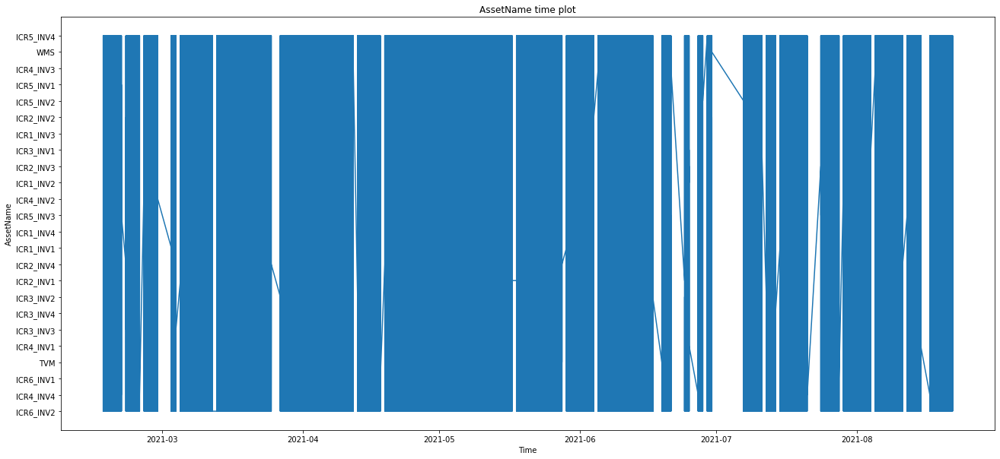

In [ ]:
import matplotlib.pyplot as plt

df['Date_Time'] = pd.to_datetime(df['Date_Time'])
plt.figure(figsize=(22,10))
plt.plot(df['Date_Time'], df['AssetName'])
plt.title('AssetName time plot')
plt.xlabel('Time')
plt.ylabel('AssetName')
plt.show()

# Conclusion of the above graph
It shows that we have AssetName with 24 unique values. The 24 values are available for each instance of time. Hence we can now take a look at other features such as current, voltage, temp, GTI, GHI etc. and analyse and make list of functions which we'll be using.<br>
**The output feature is 'DC Power'.** 

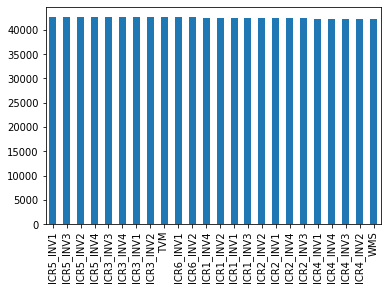

In [ ]:
pd.value_counts(df['AssetName']).plot.bar()

# Conclusion of the above graph
We have 40k+ datetime points. We'll have to train and test our model by making divisions over this time period.

In [ ]:
assetnames = df['AssetName'].unique()

#**We'll take a look at how DC power varies along with each Asset name over time**

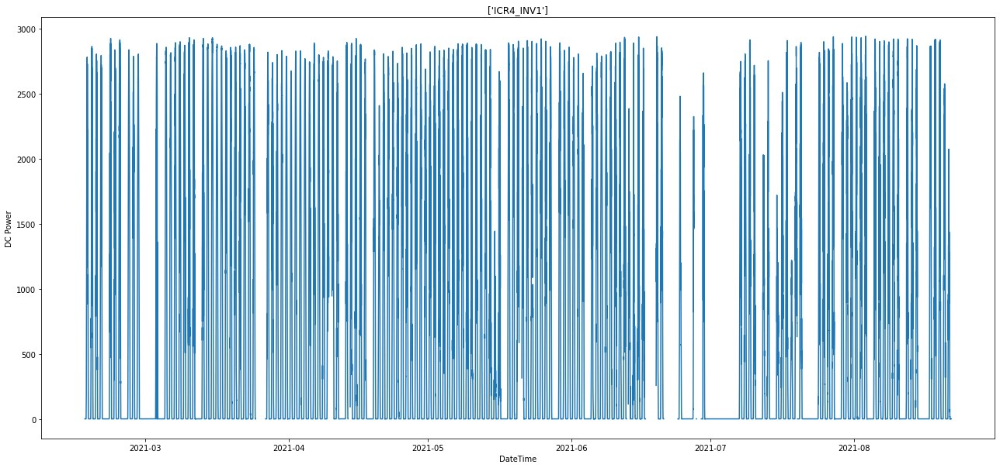

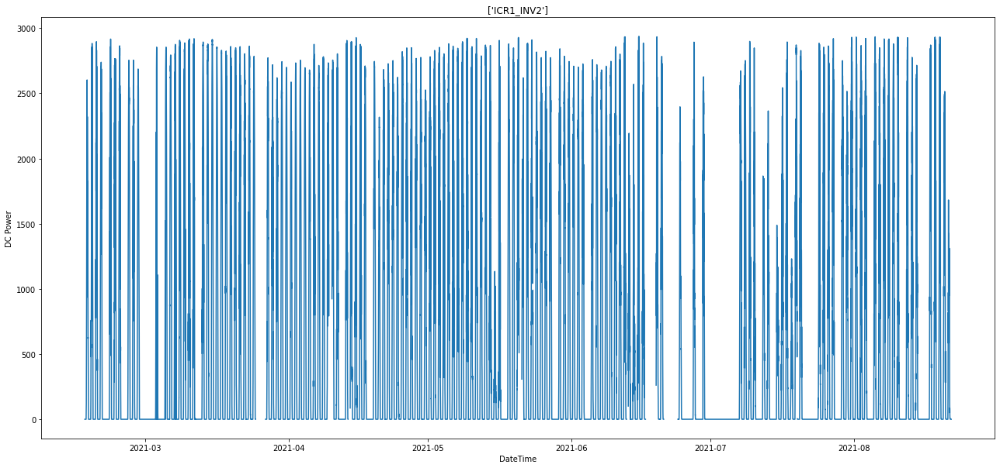

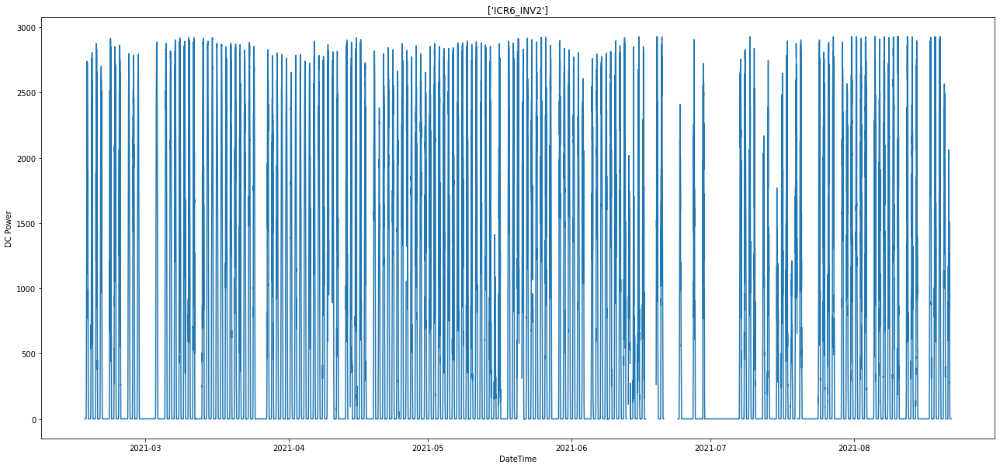

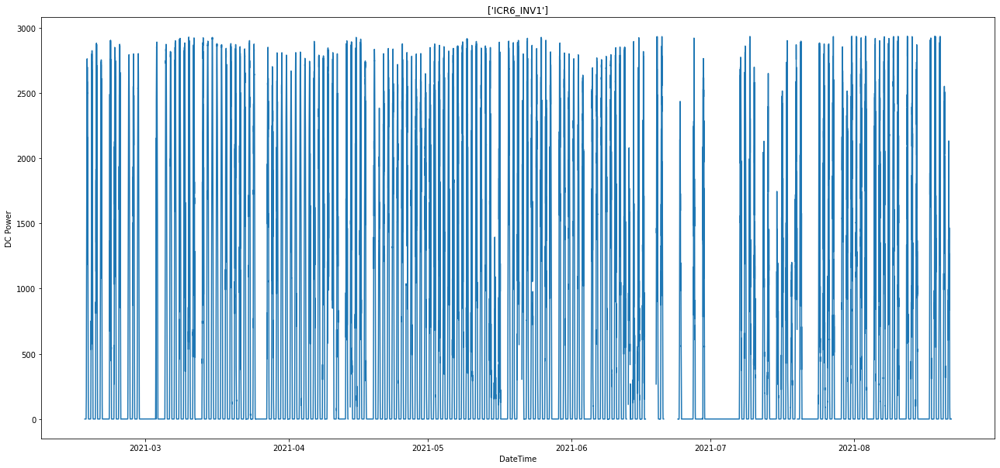

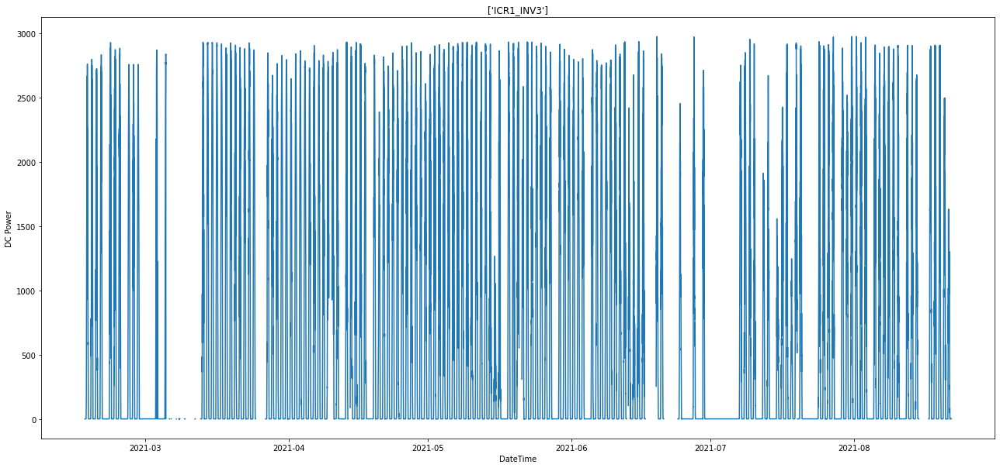

...

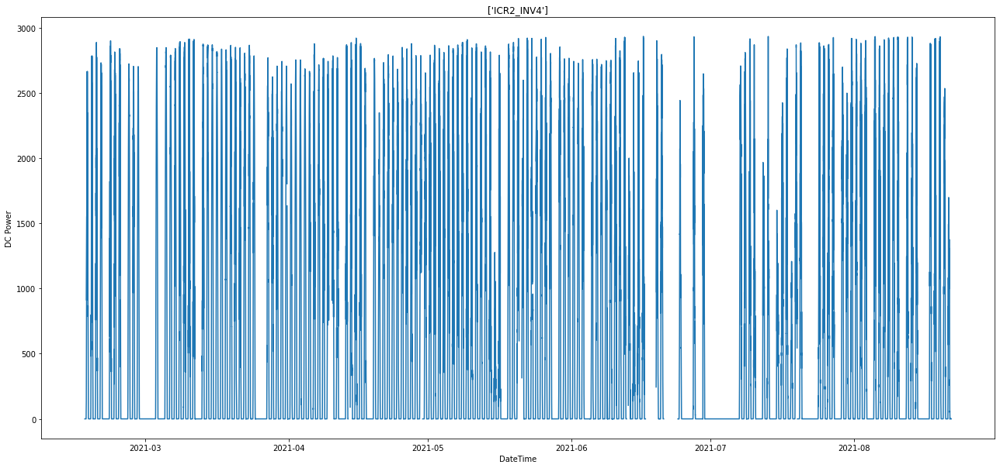

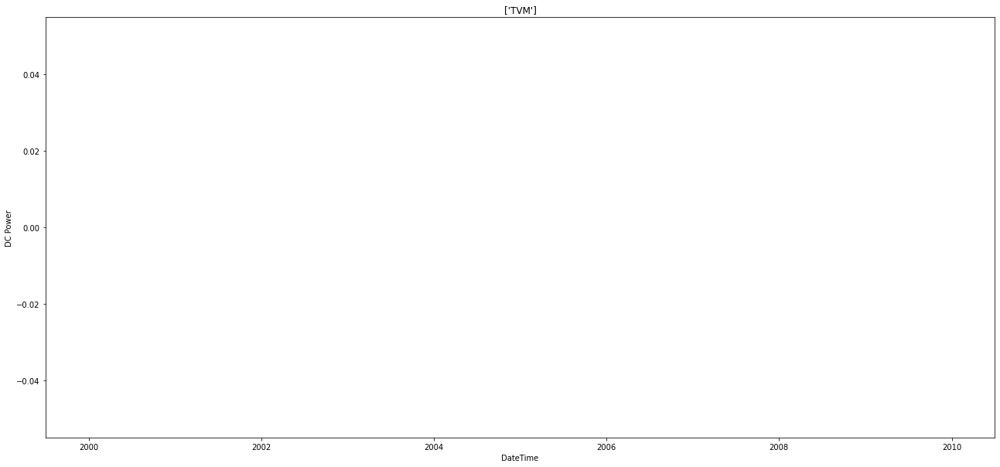

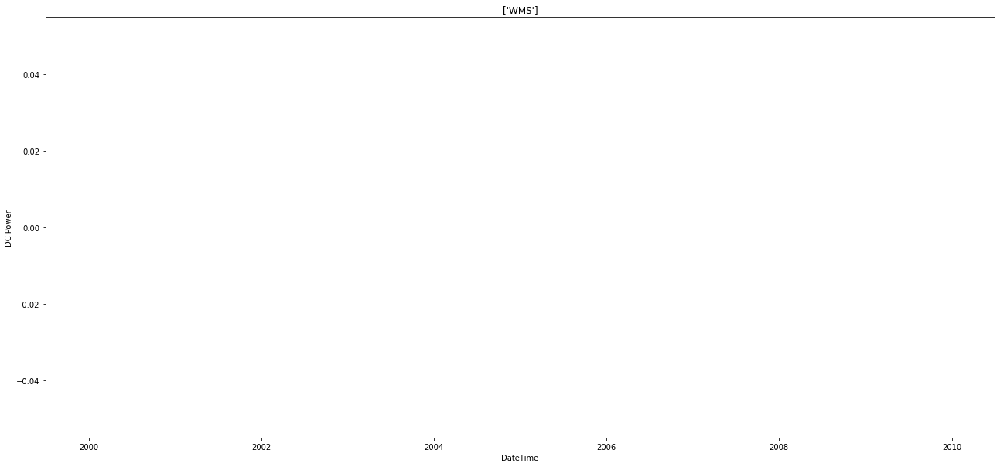

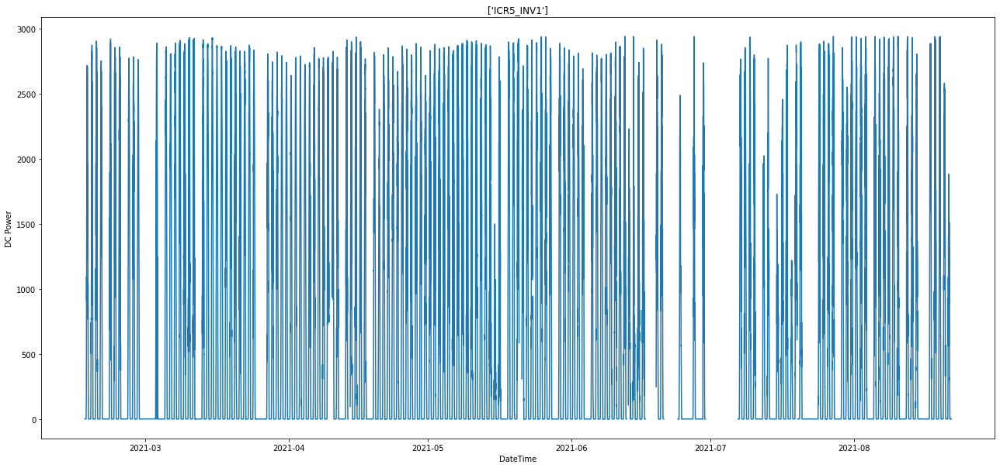

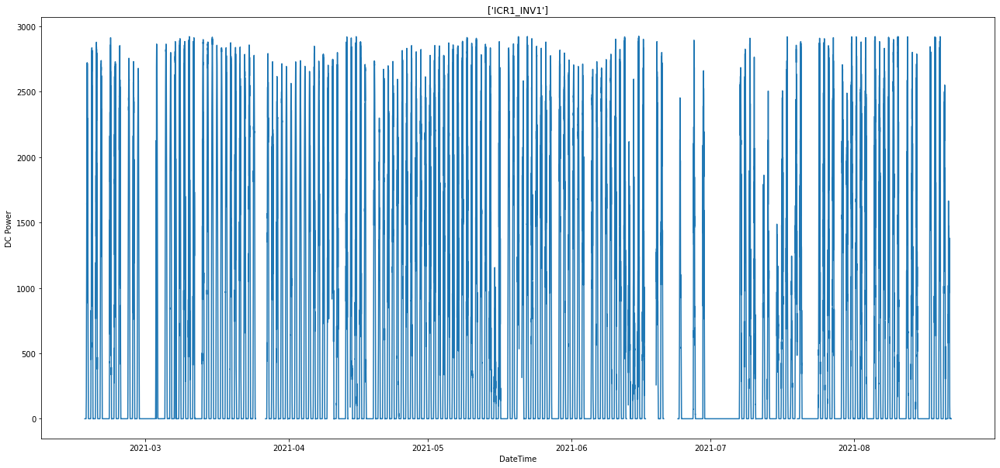

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['DC Power'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('DC Power')
  plt.show()
  #ICR1_INV1['DC Power'].describe()

# Conclusion : DC Power vs DateTime for various AssetNames
Except for WMS and TVM everything has non NaN values, but still it's better to keep it rather than deleting the rows. <br>
We can also see that the power output is zero for early morning and late night time periods, we can remove that part of data, or we can keep it incase we have datetime in this slot for our test set.

#**Analysis: Datetime vs Module temp and Ambient Temp for different Assetnames**

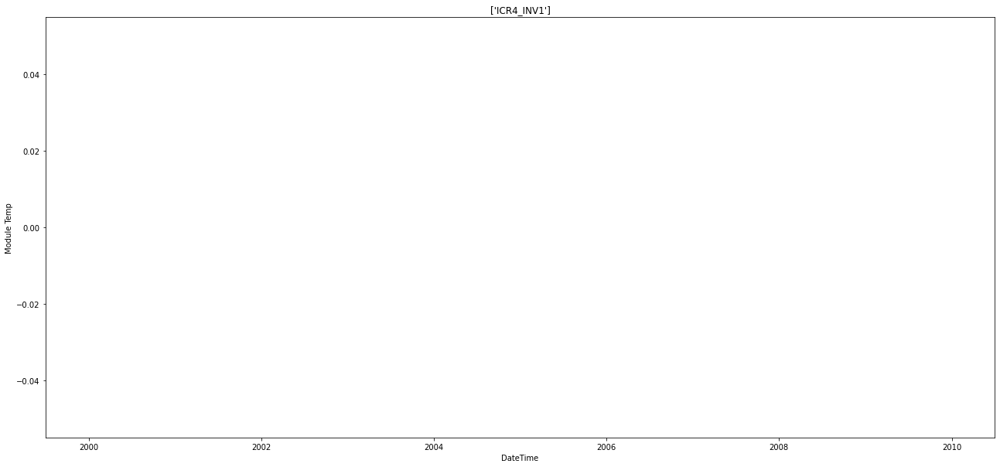

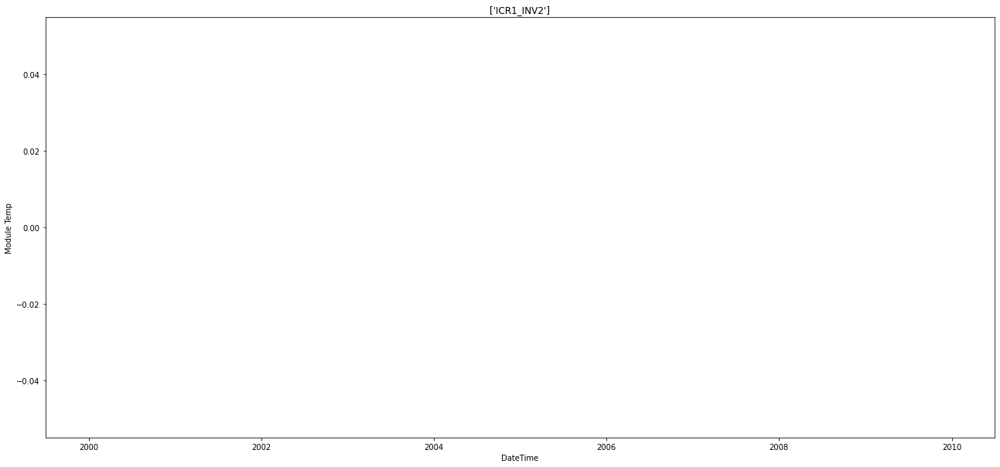

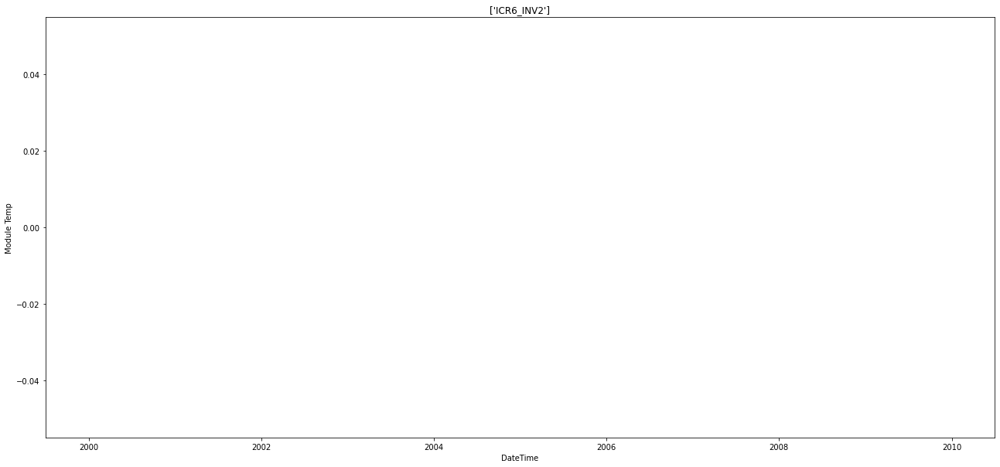

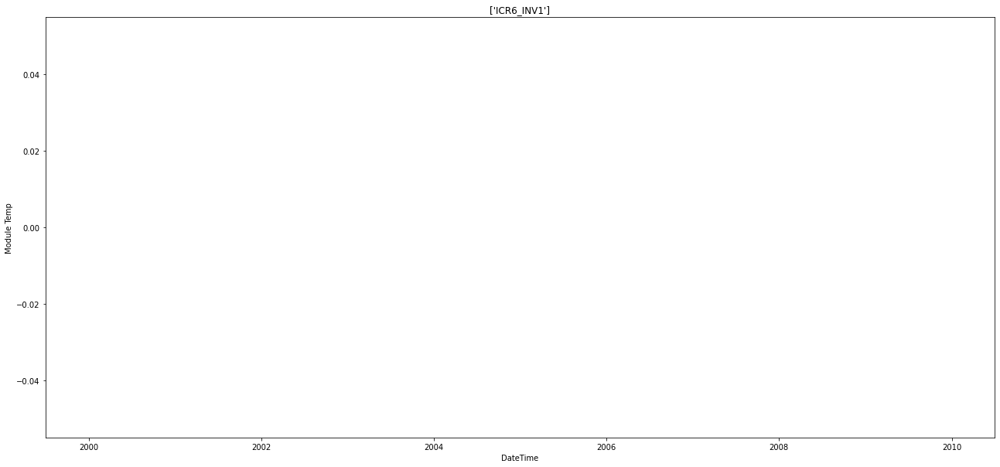

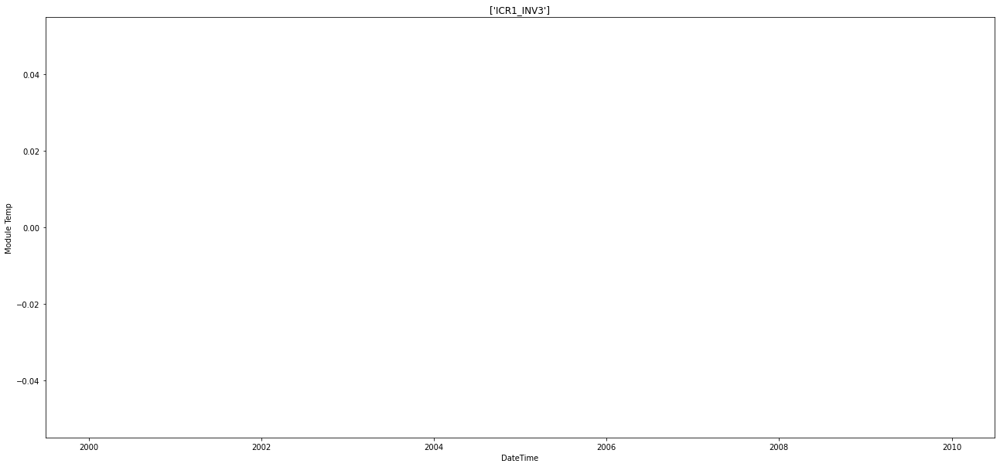

...

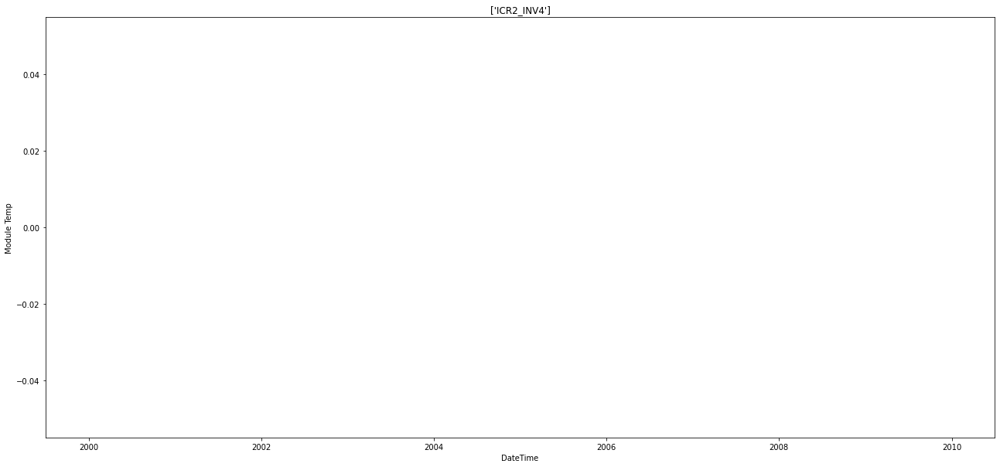

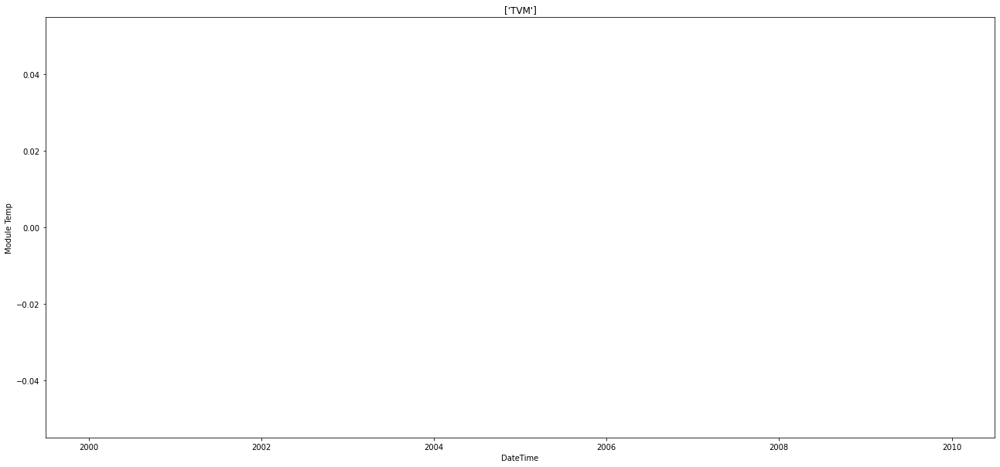

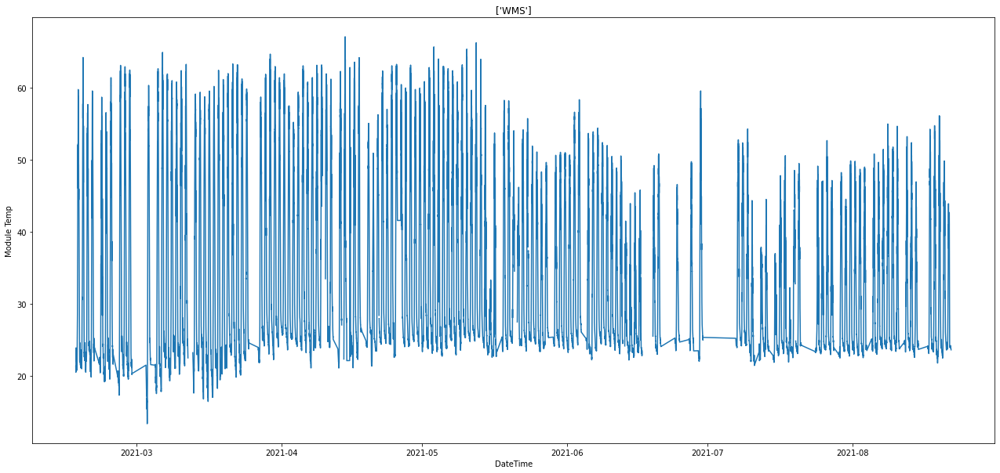

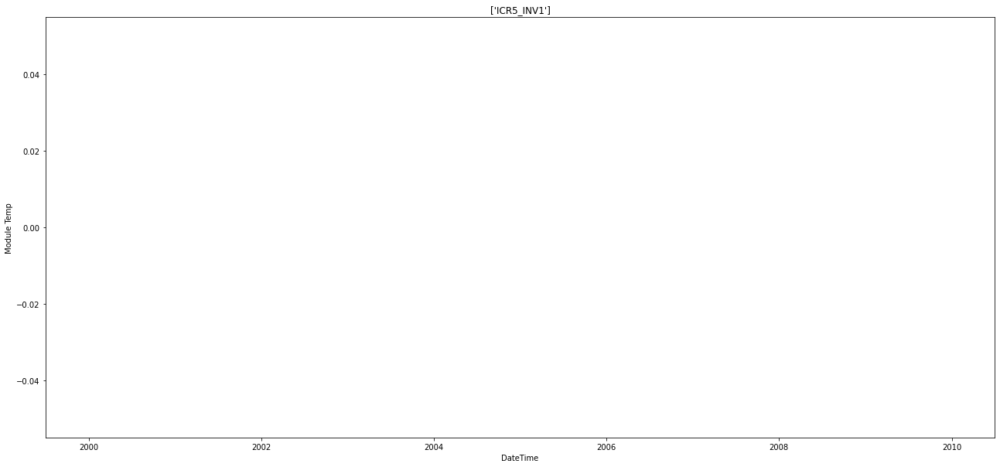

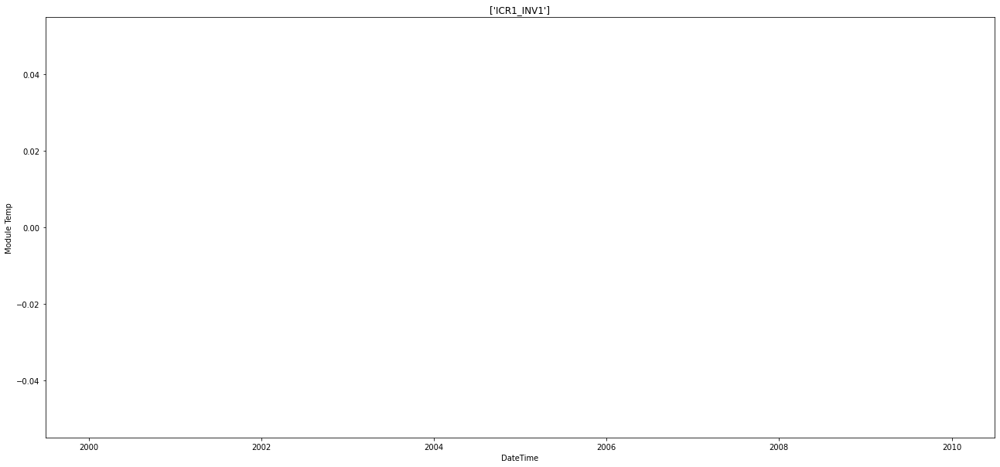

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['Module Temp'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('Module Temp')
  plt.show()

# Conclusion: Module Temp vs DateTime for different AssetNames

This shows that we have Module temp available only for AssetName 'WMS'. For other values it's NaN. We'll have to take a look at other temp to come to a final conclusion. 

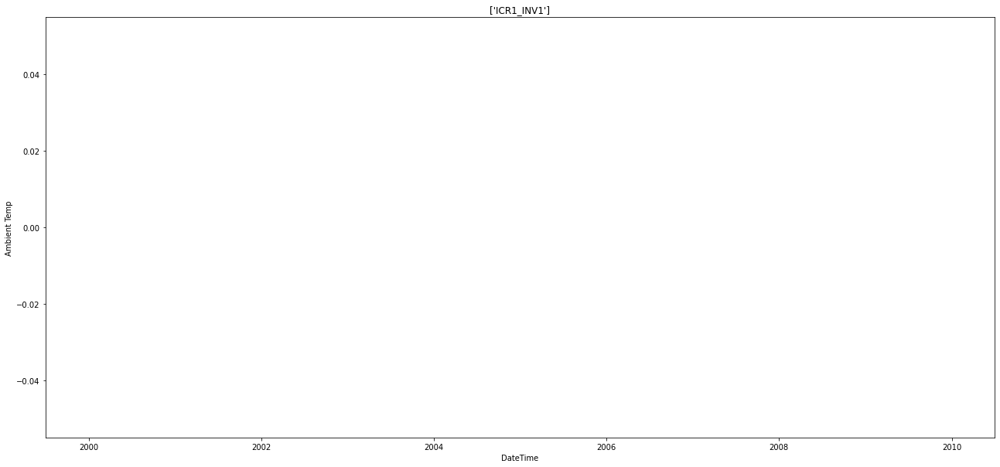

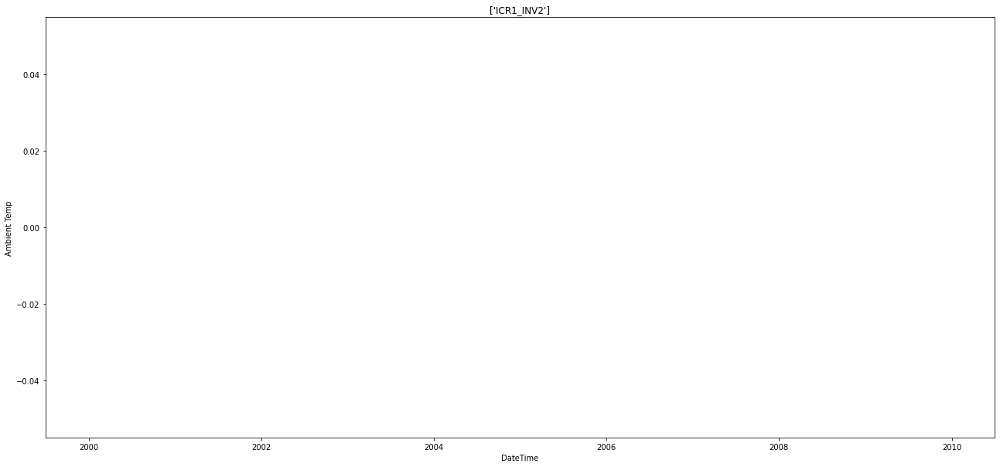

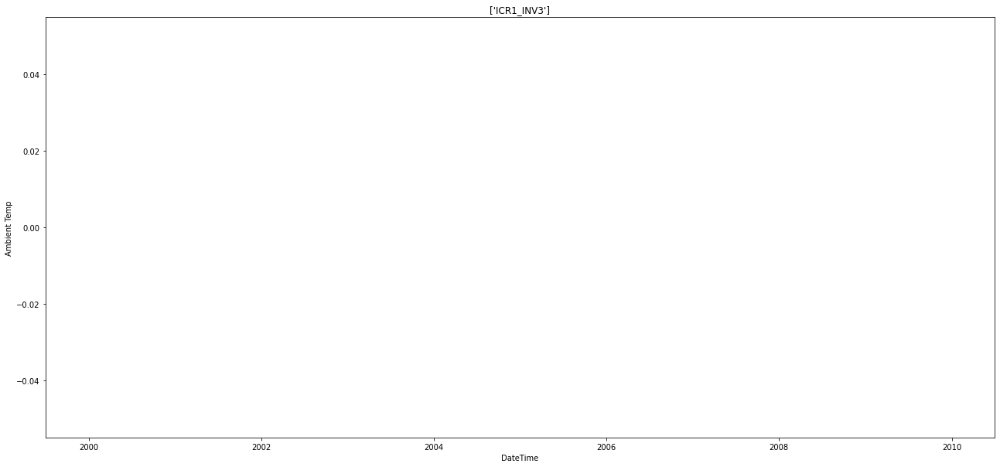

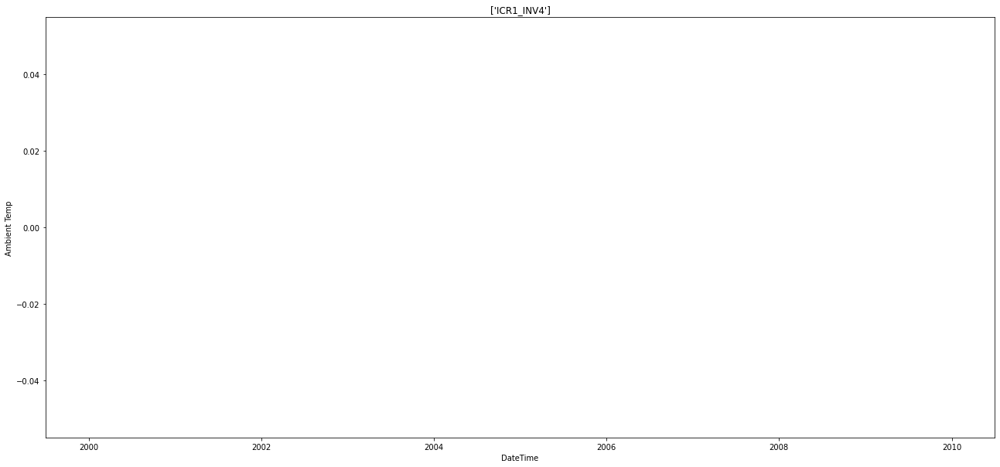

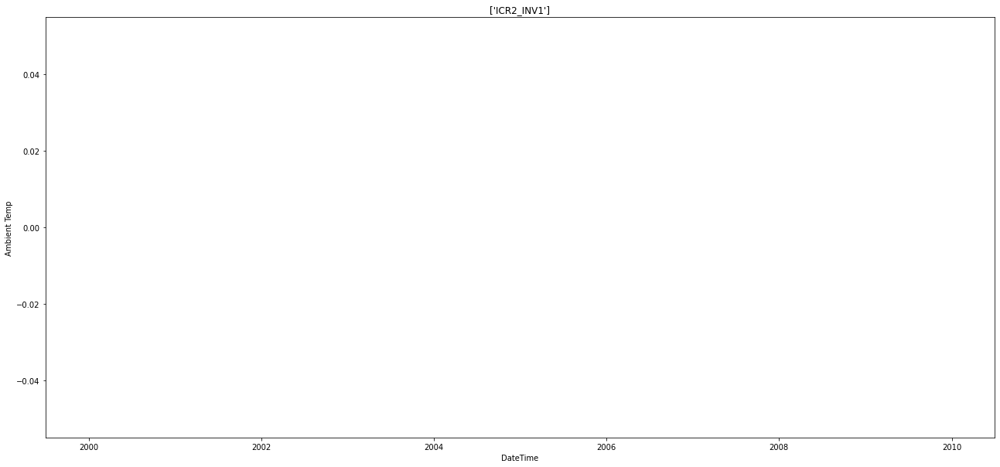

...

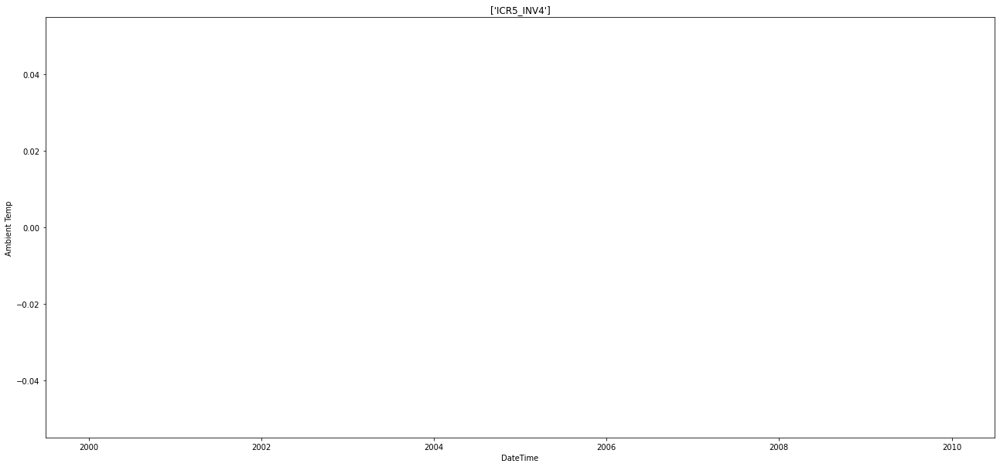

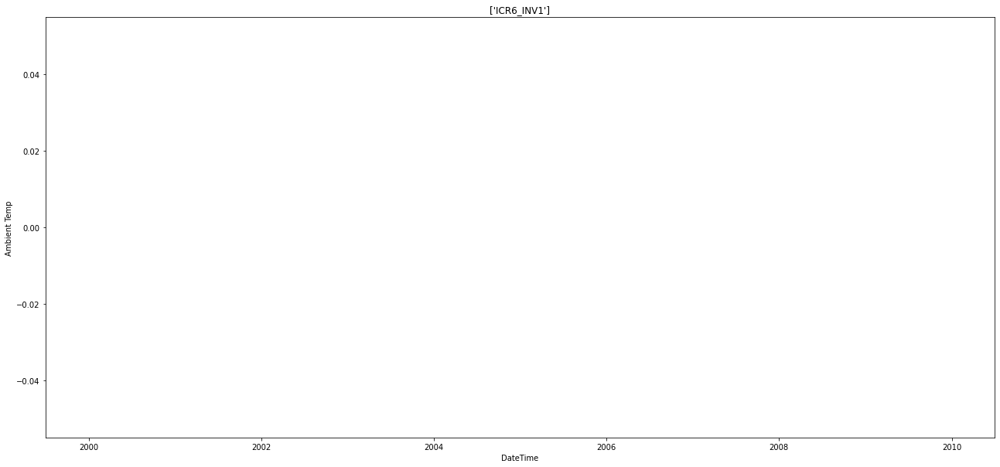

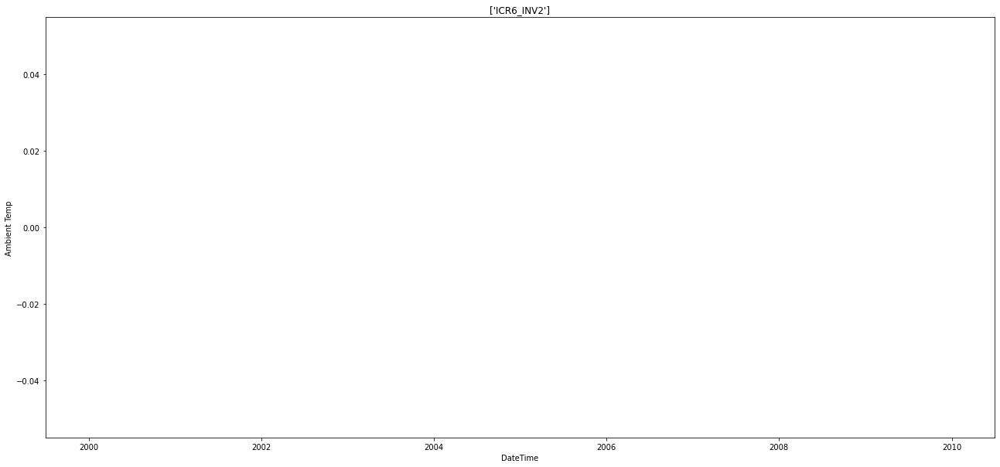

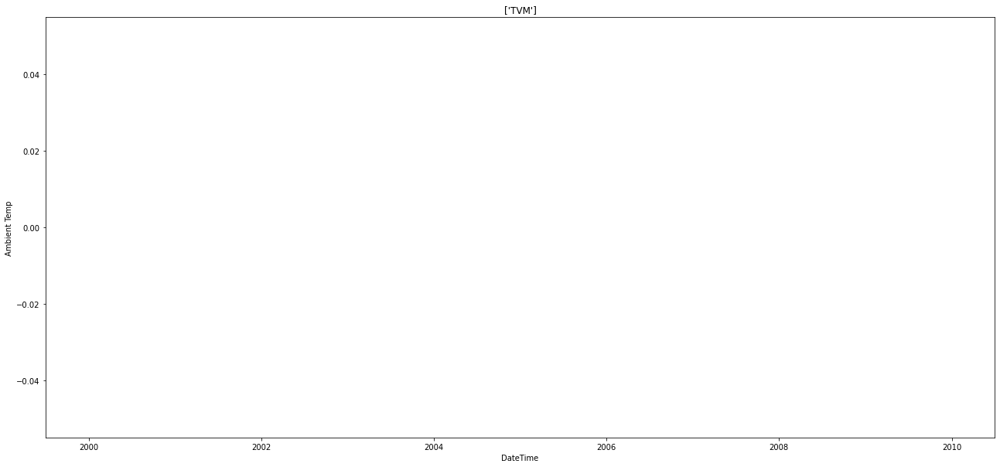

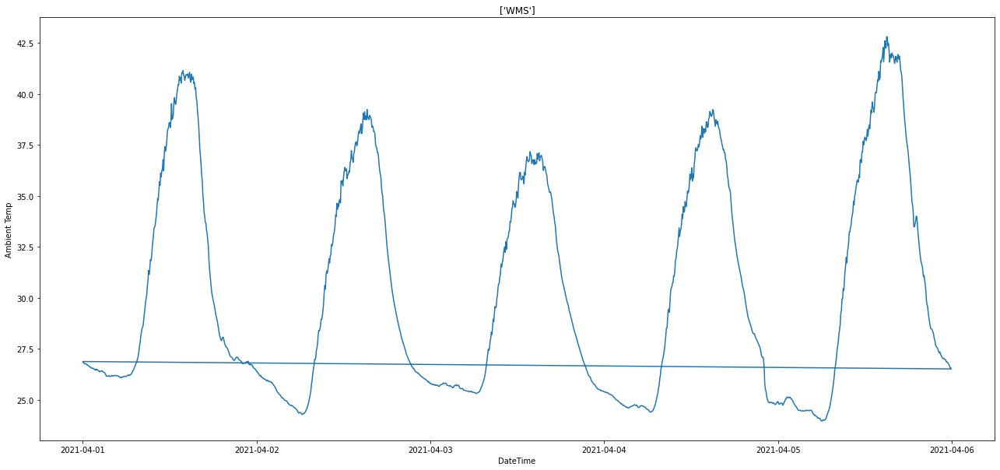

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['Ambient Temp'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('Ambient Temp')
  plt.show()


# Conclusion : DateTime vs Ambient Temp for various AssetNames

It also only varies with WMS and hence WMS becomes important part for analysis. It also shows us a very important result. All the 22 INC_INV values somewhat have the same value over datetime, hence AssetName might be the name for all different sensors of a machine each measuring different values, for example, INC_INV values measure electrical parameters such as power and current while WMS measures temperature.

#**Analysis: DateTime vs GHI and GTI for different AssetNames**

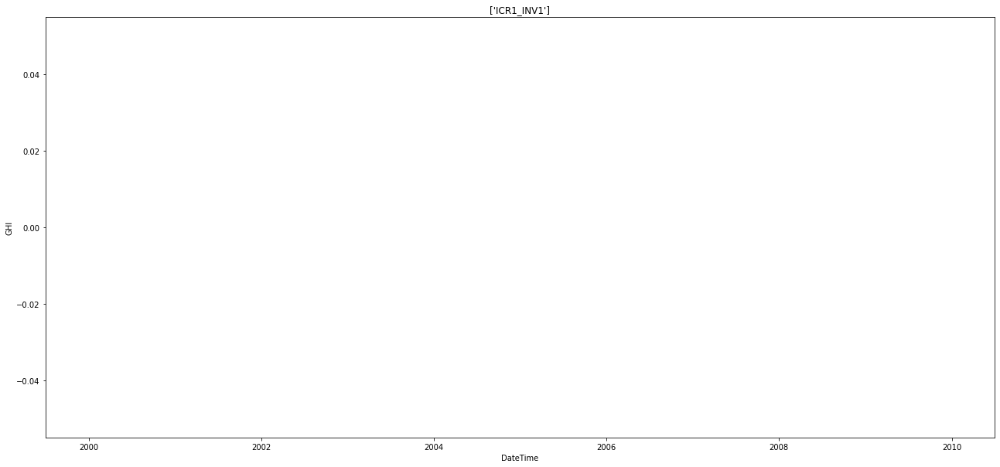

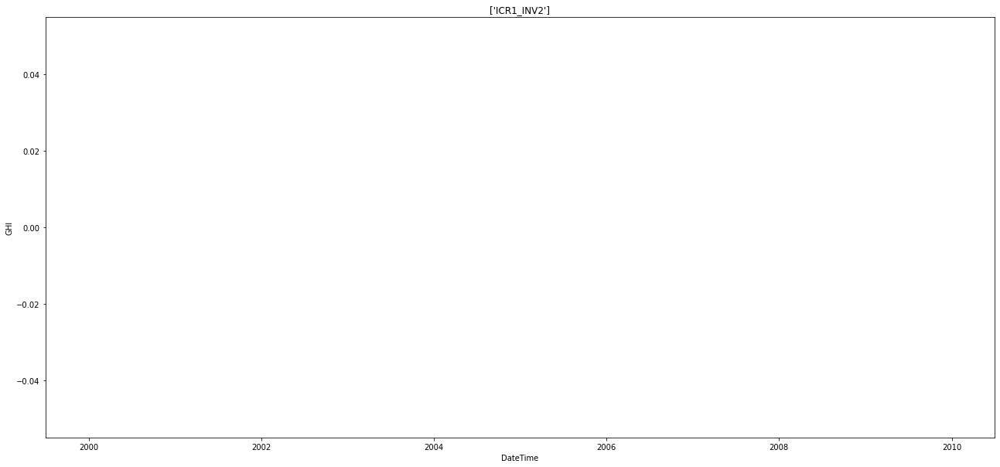

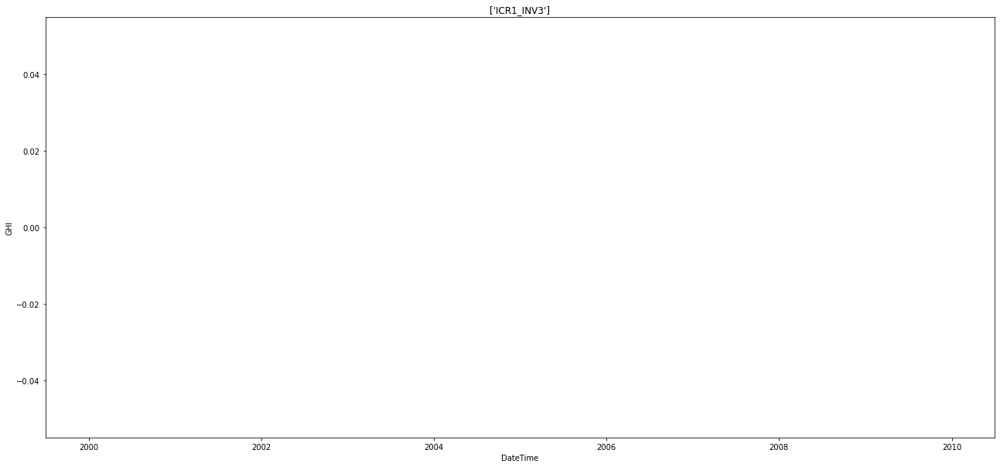

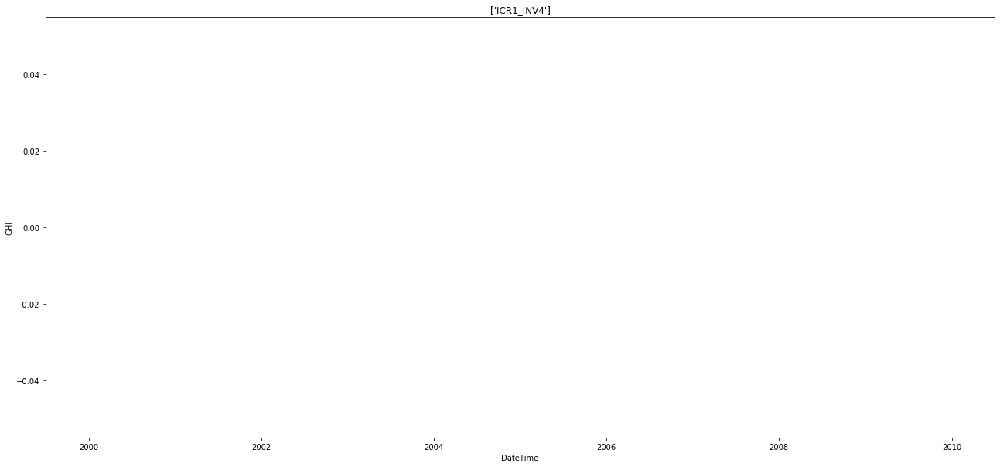

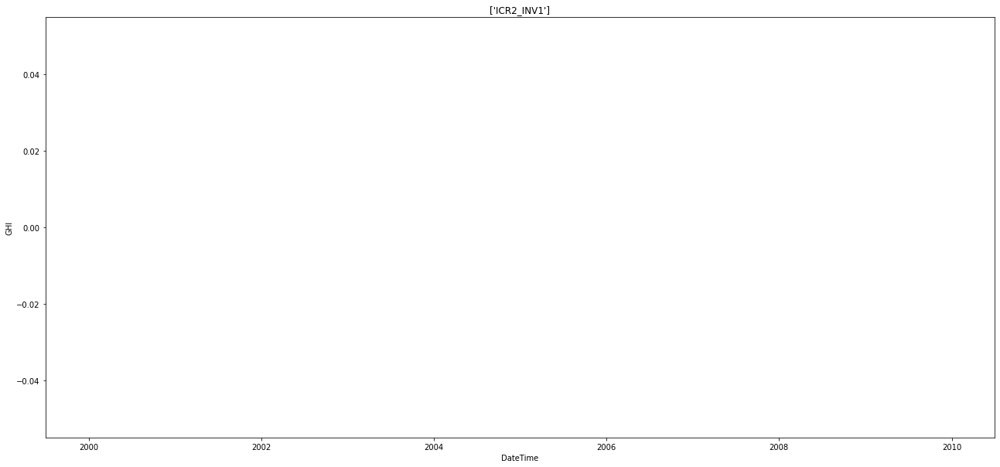

...

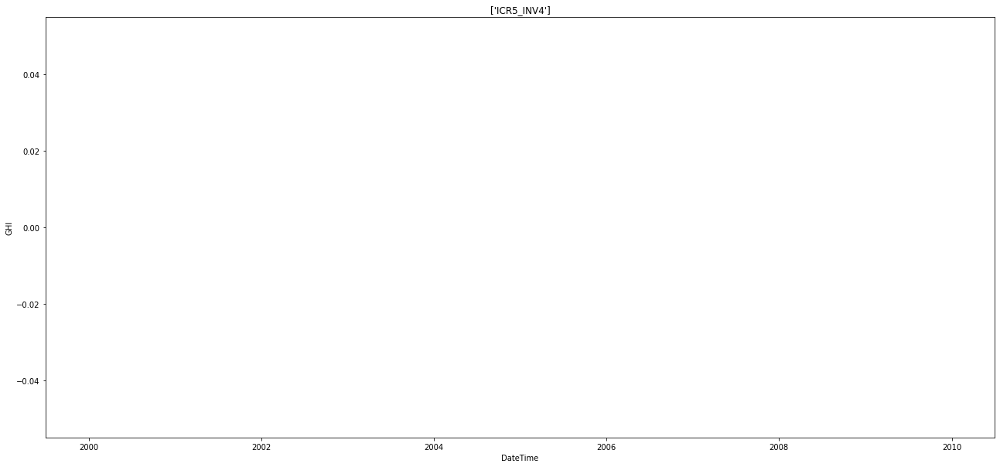

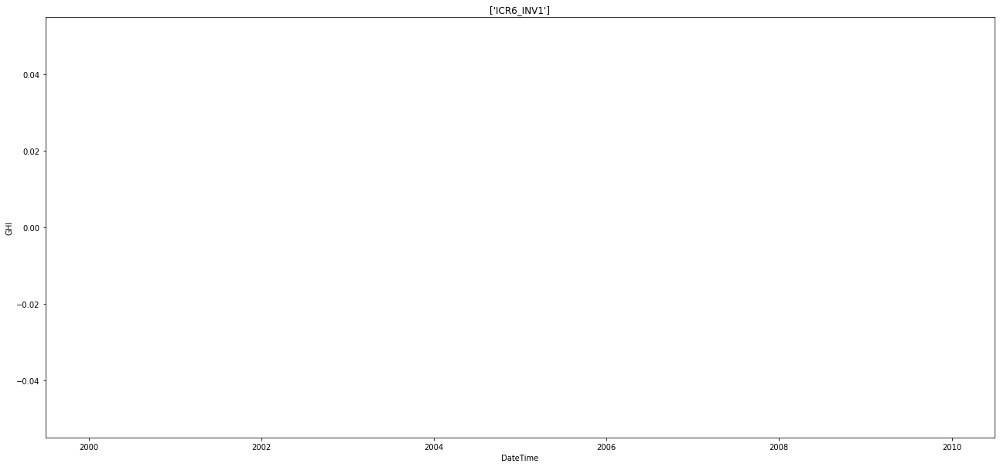

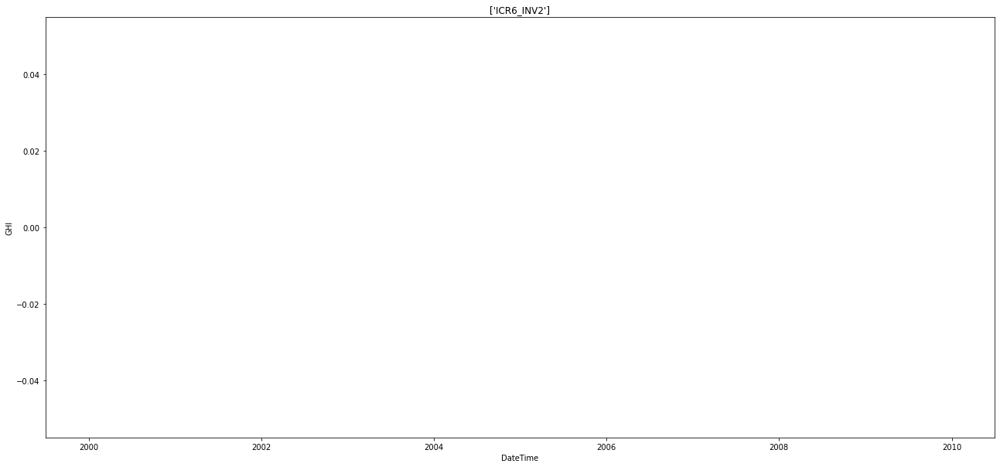

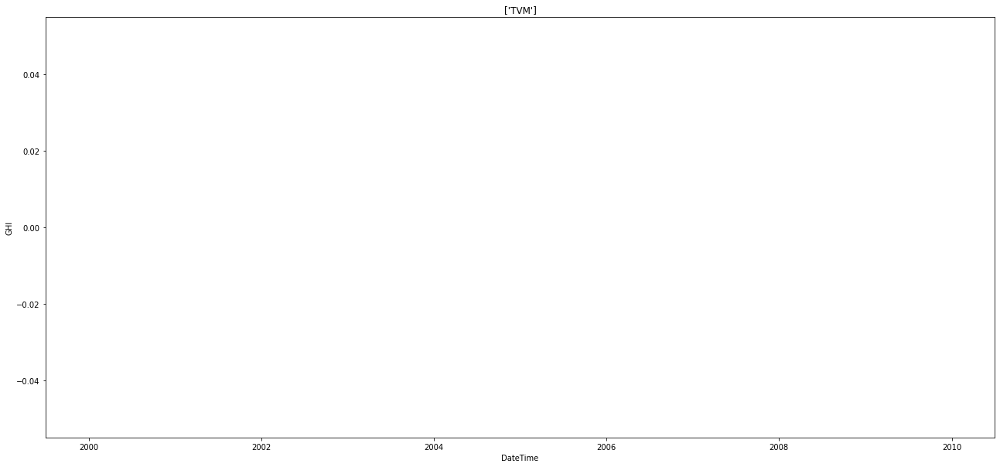

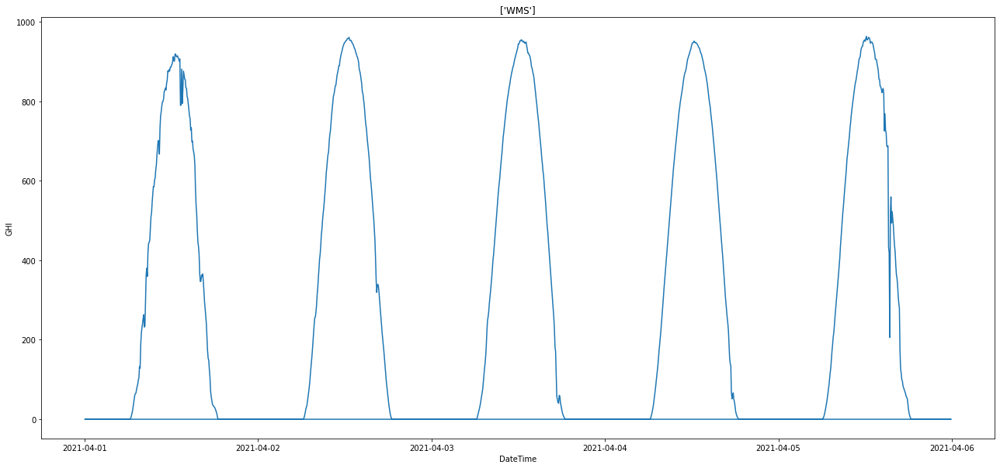

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['GHI'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('GHI')
  plt.show()

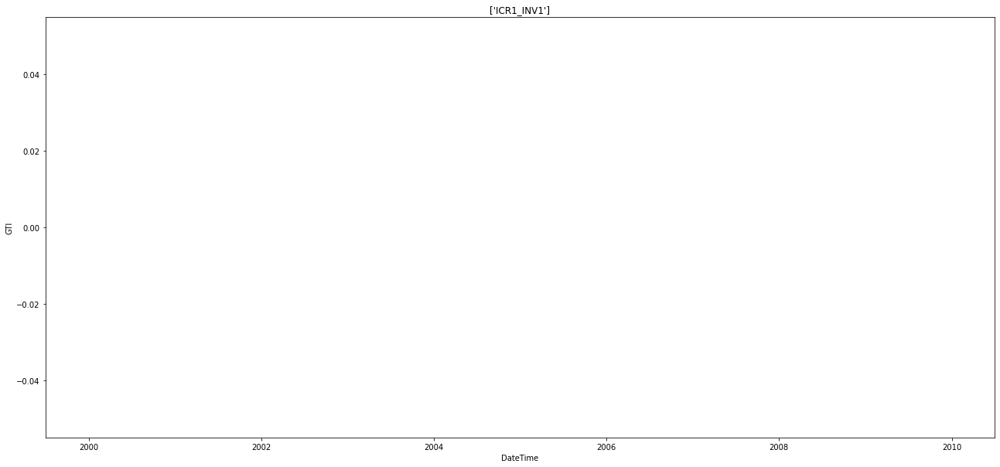

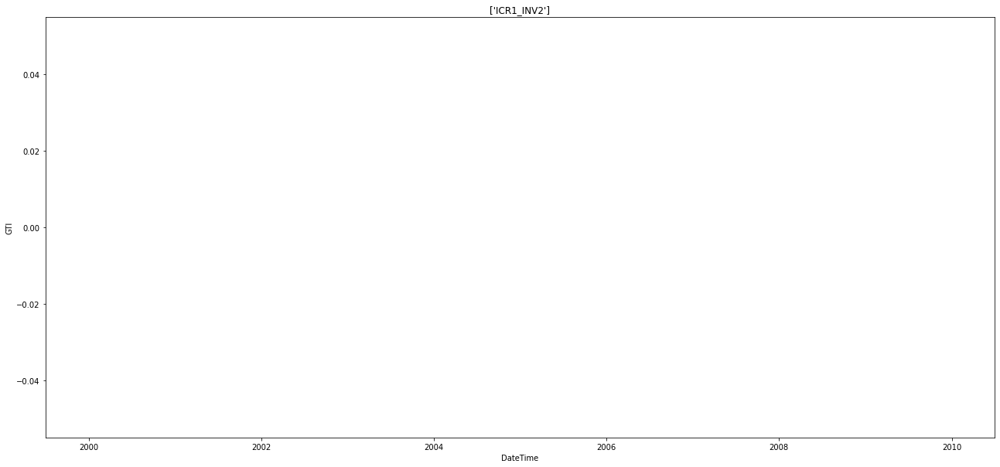

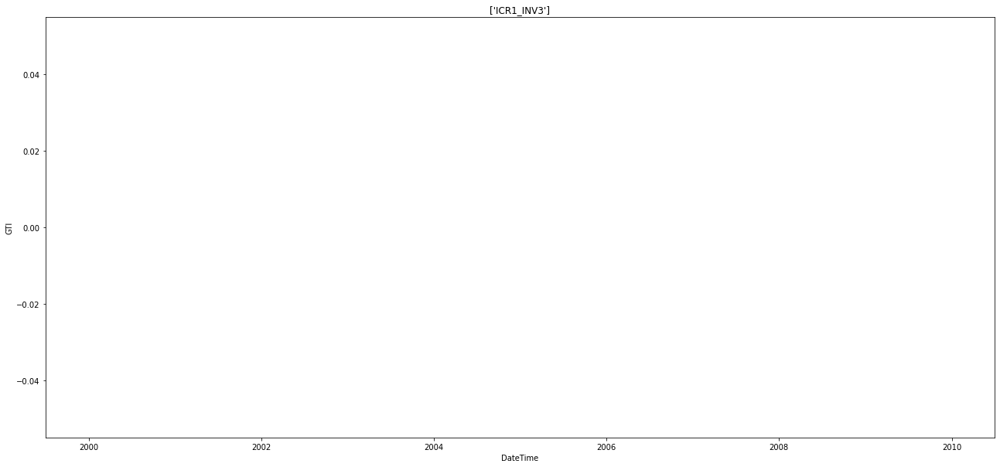

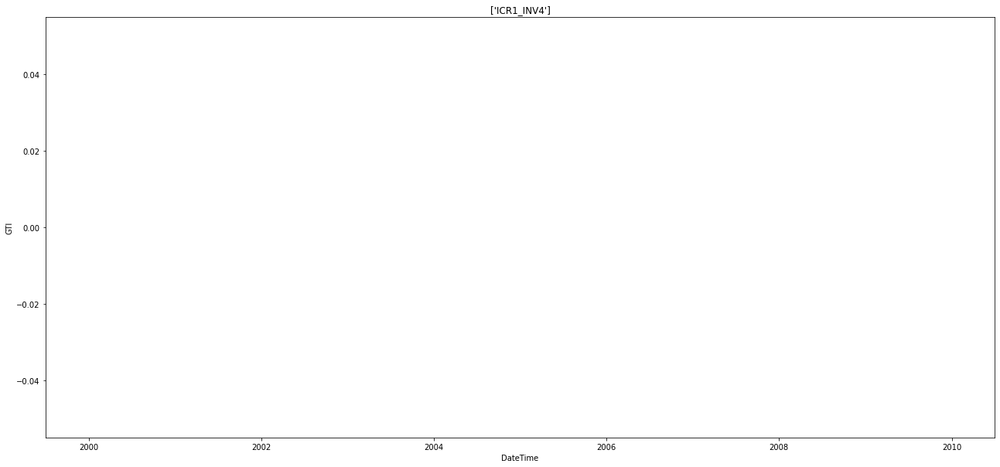

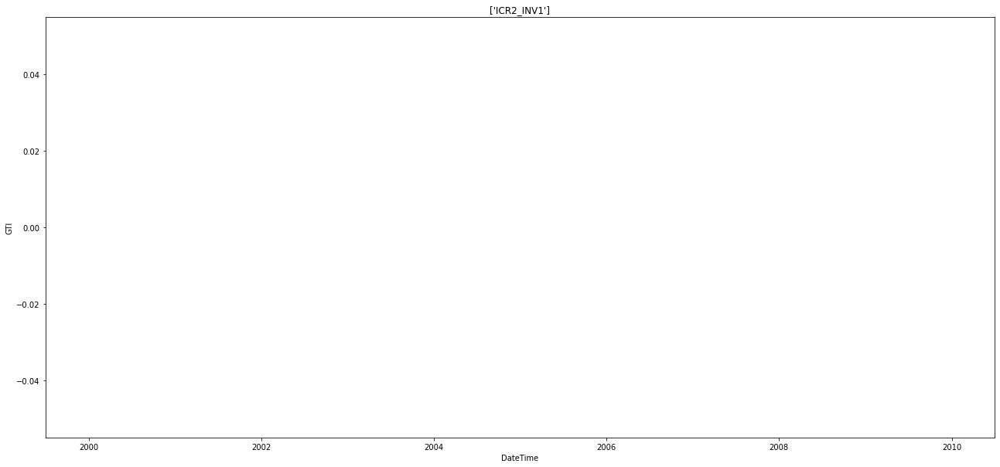

...

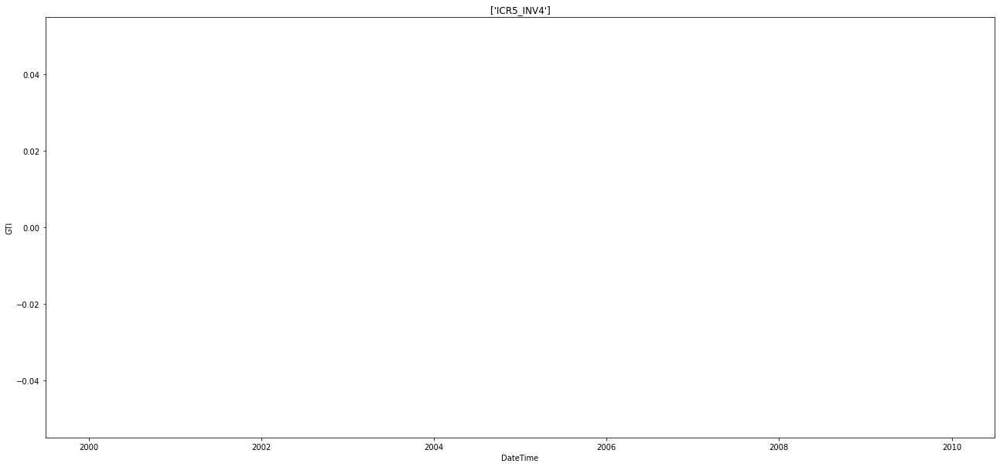

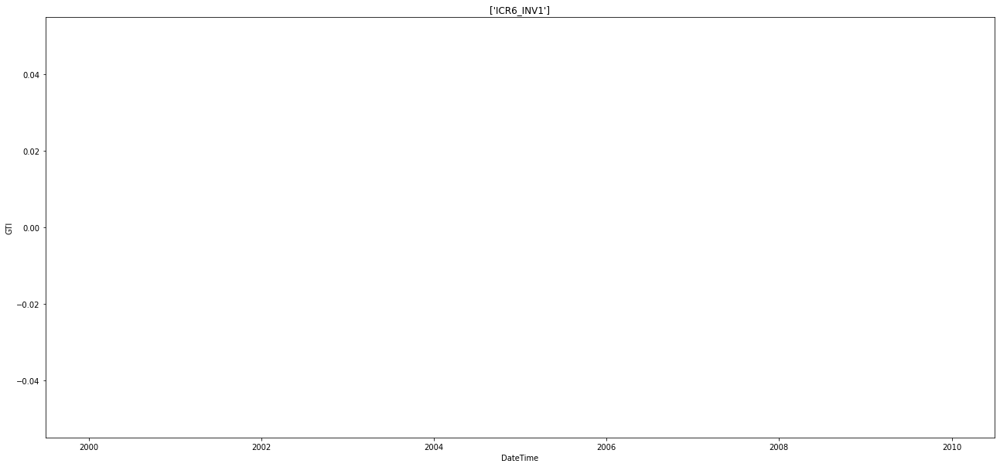

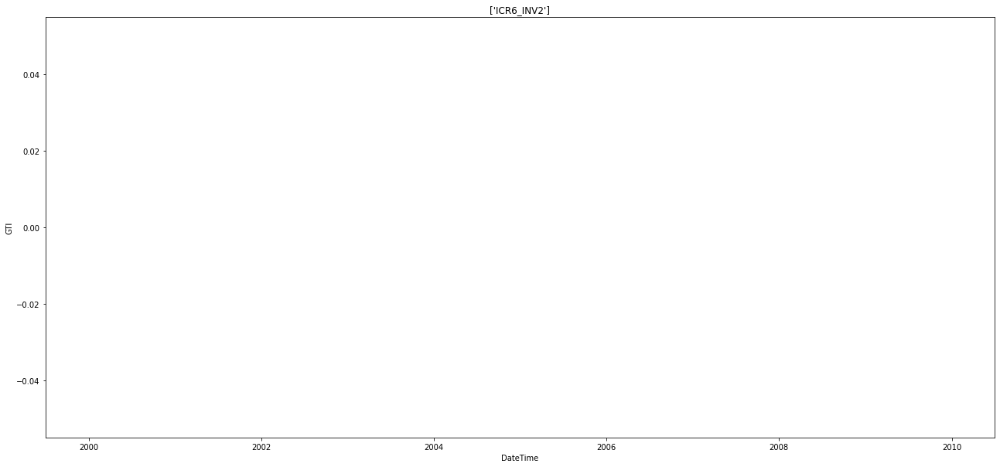

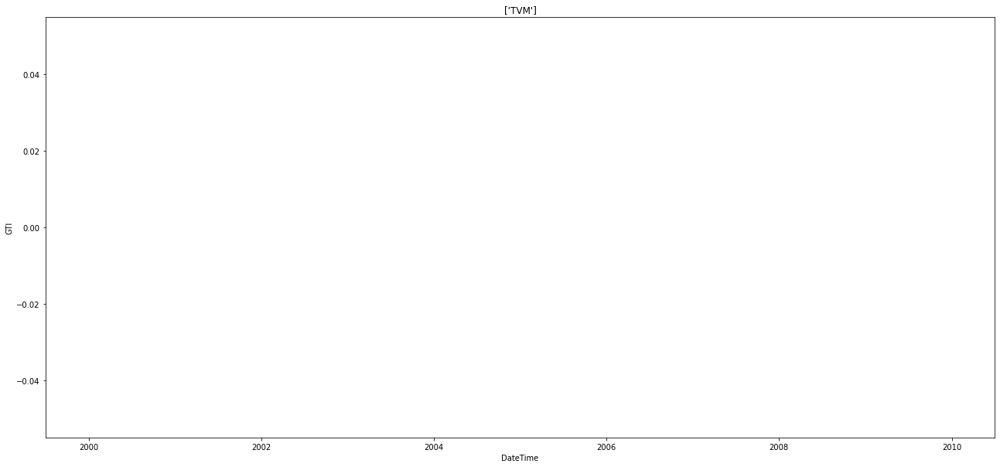

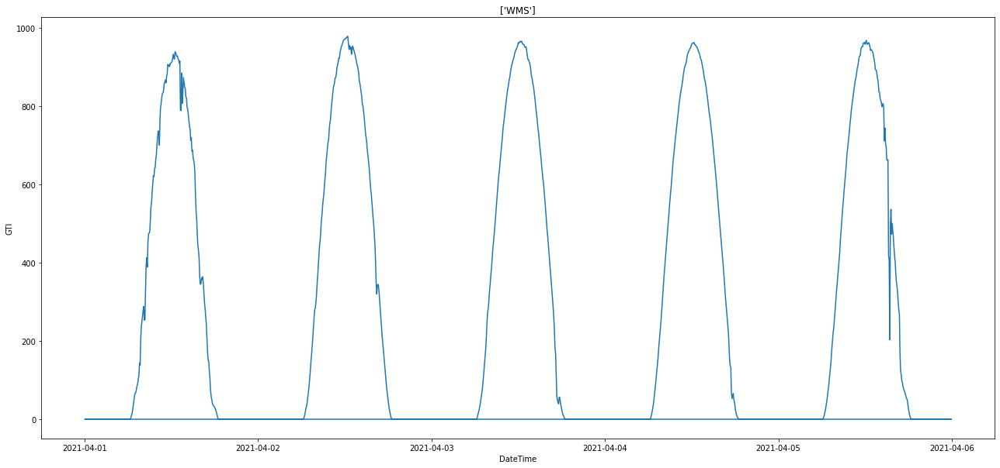

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['GTI'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('GTI')
  plt.show()

# Conclusion: DateTime vs GHI and GTI for different AssetNames

The assetname 'WMS' is the only one which keeps track of this data and hence we'll use it for creating our model.

#**Analysis: DateTime vs AC Current values(one of the three) for different AssetNames**



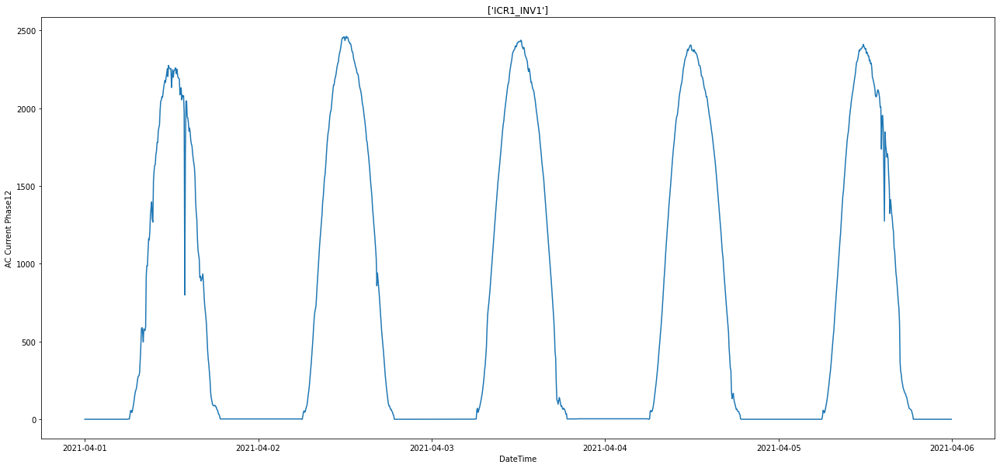

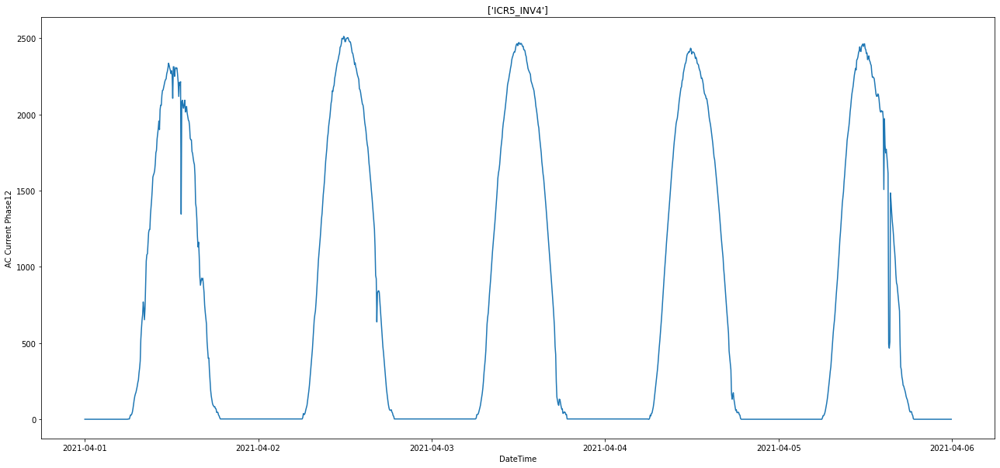

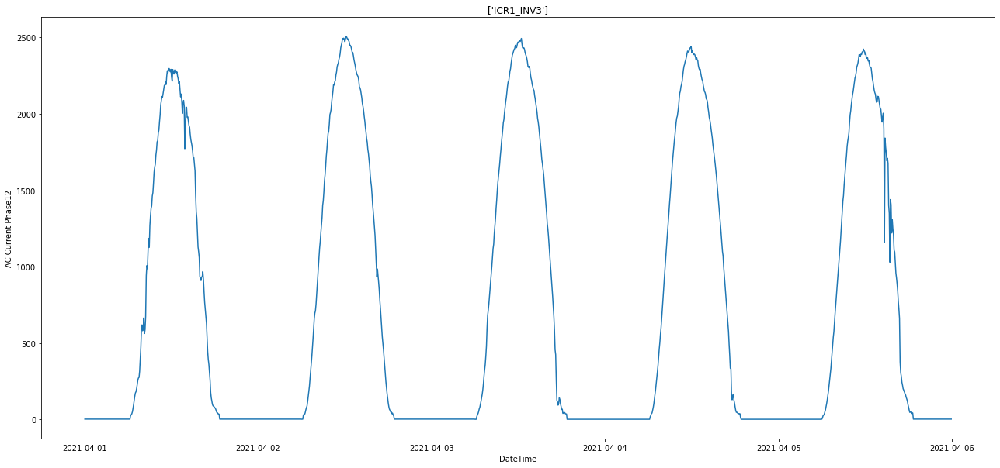

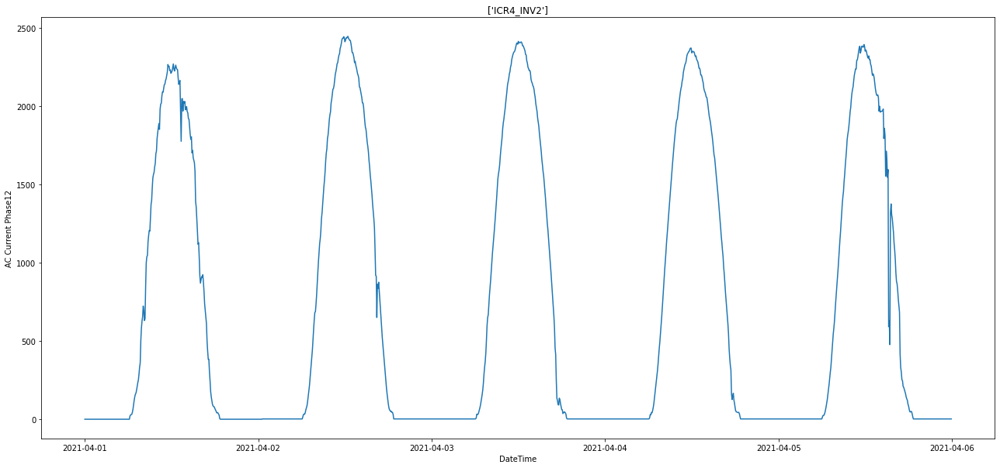

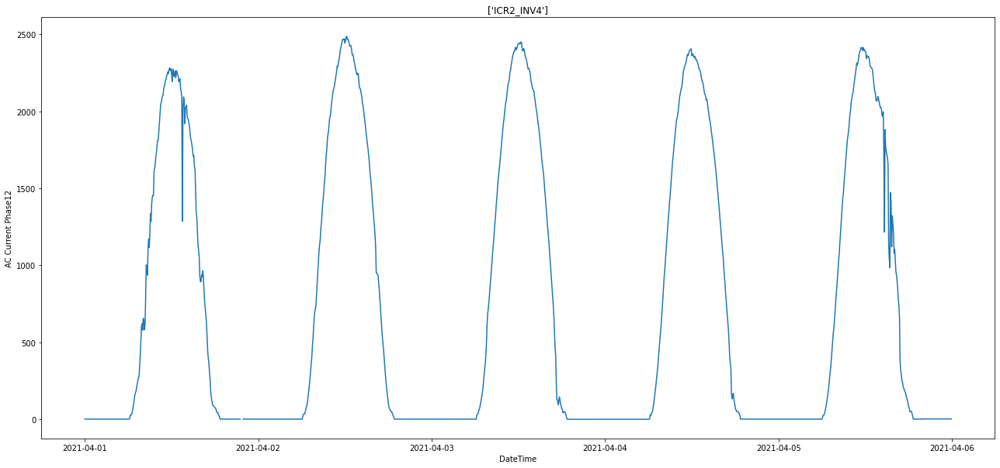

...

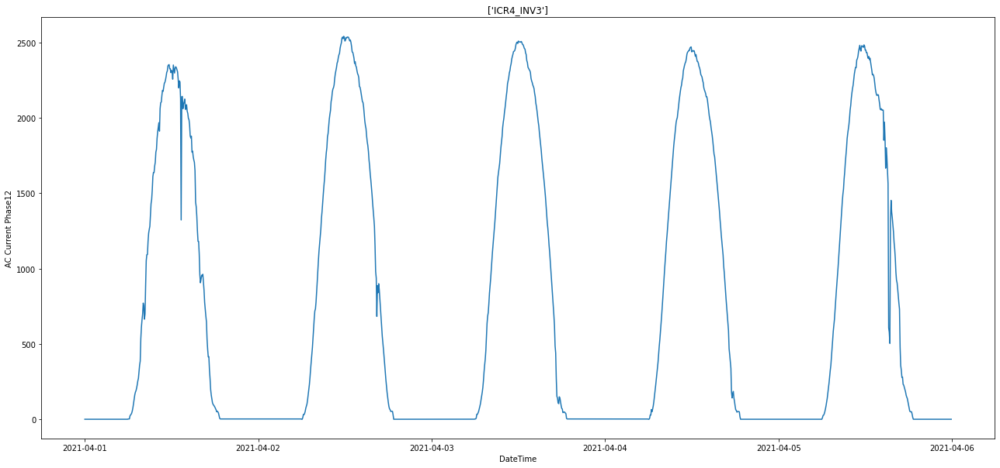

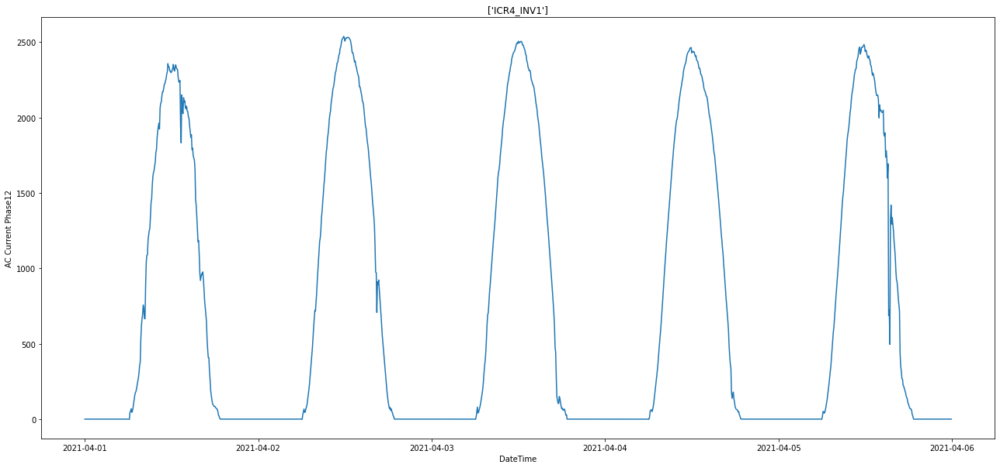

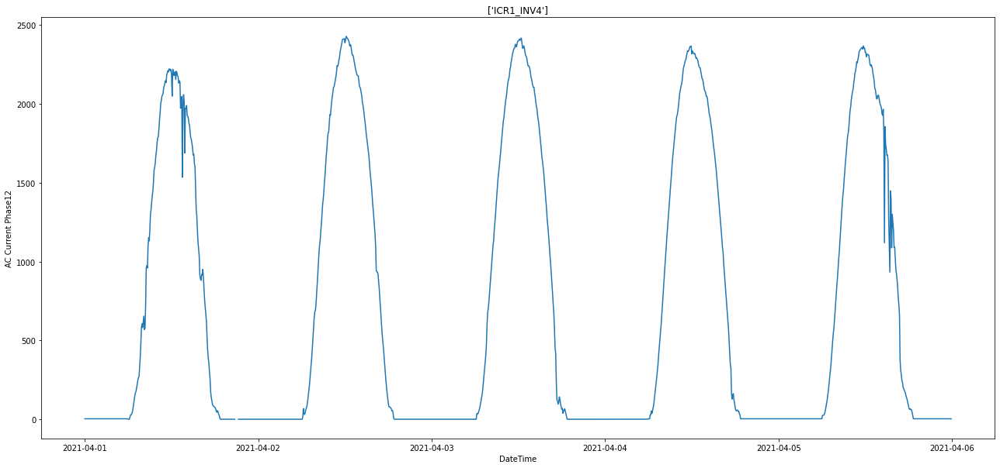

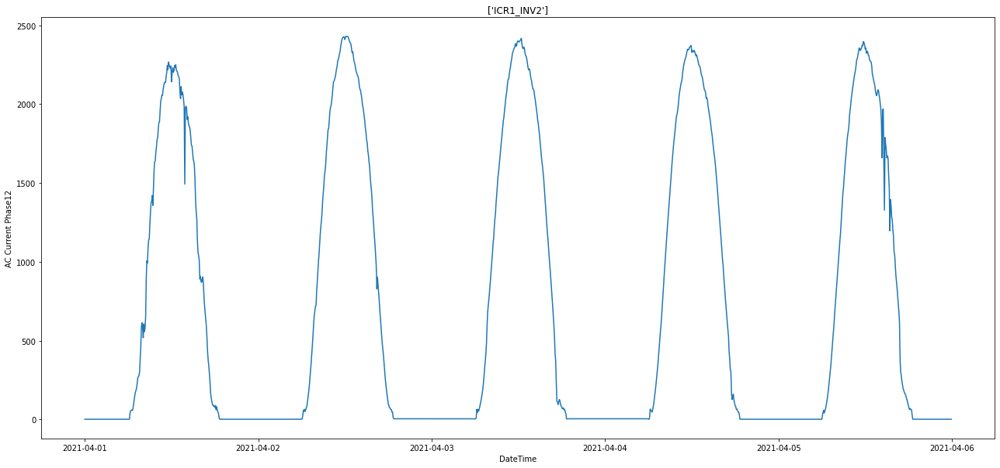

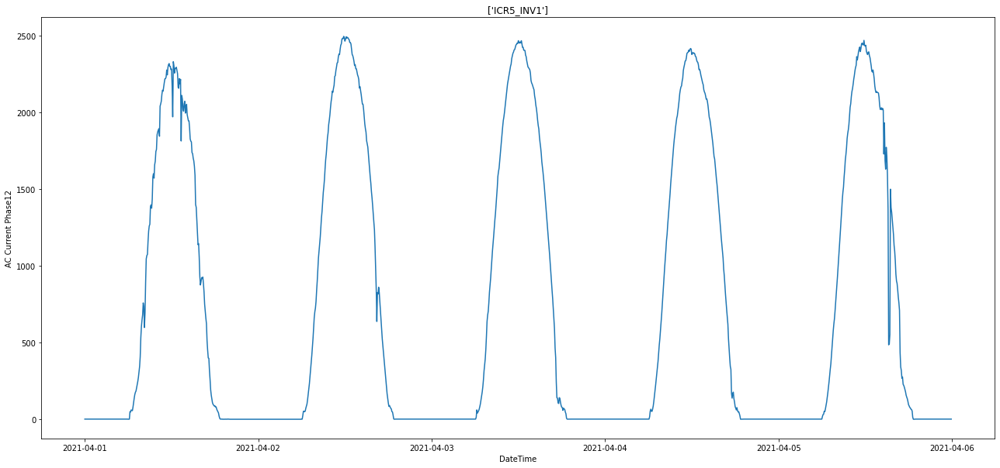

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['AC Current Phase12'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('AC Current Phase12')
  plt.show()

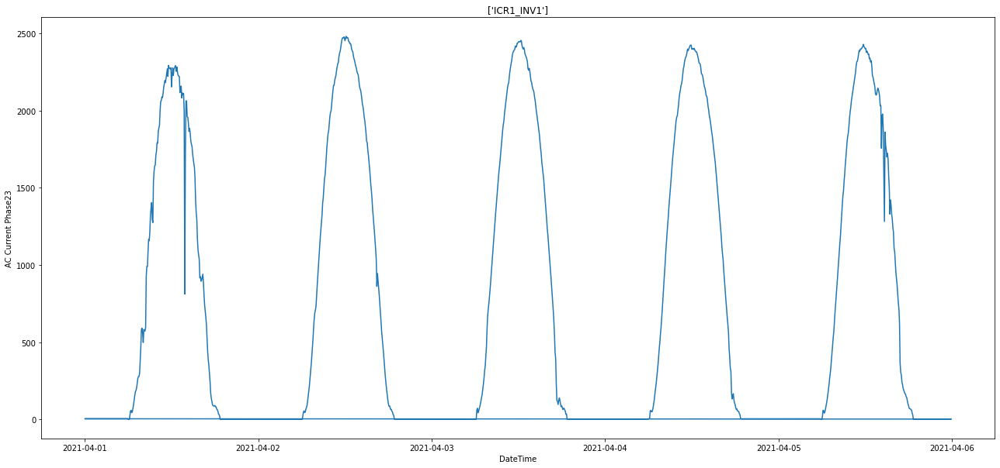

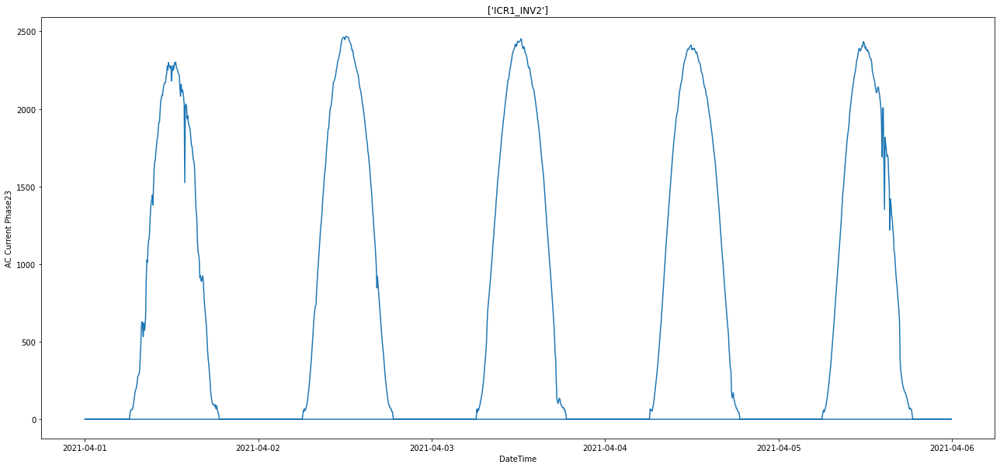

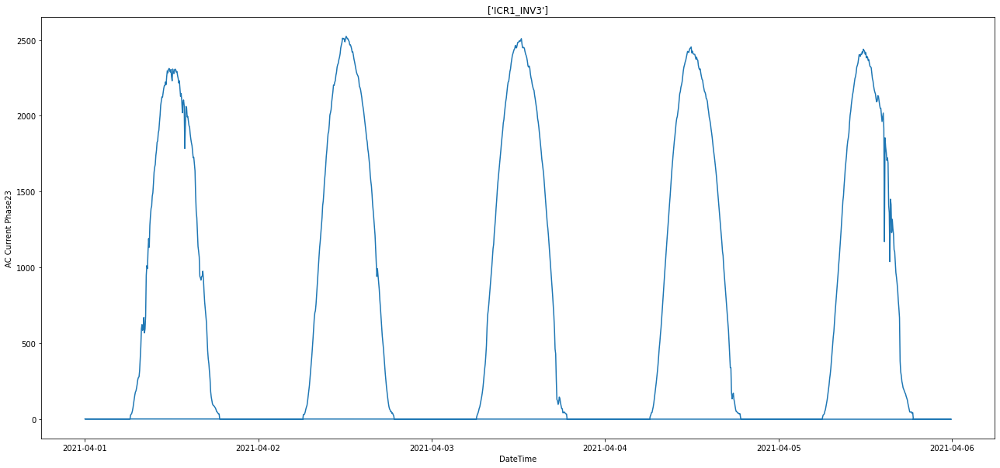

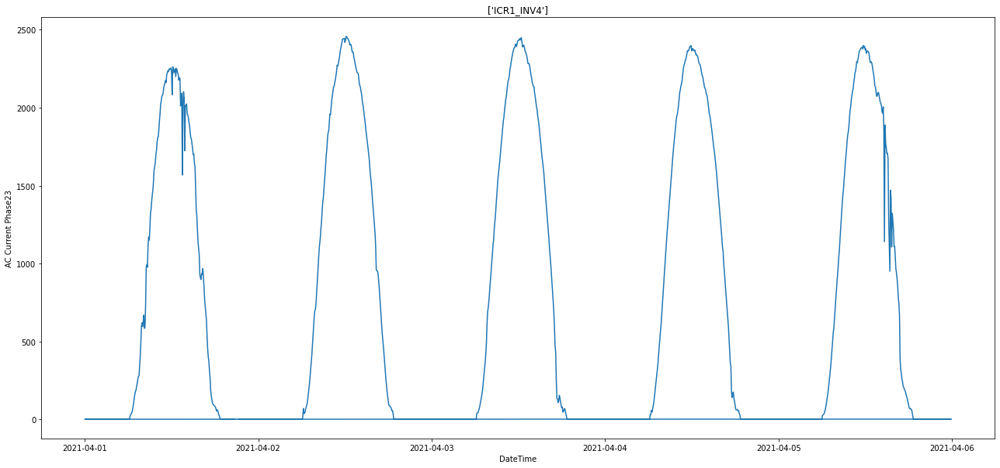

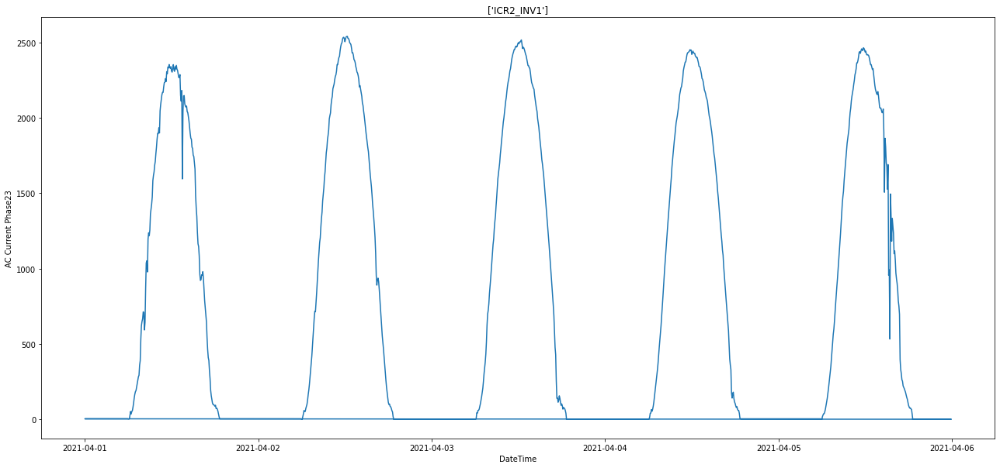

...

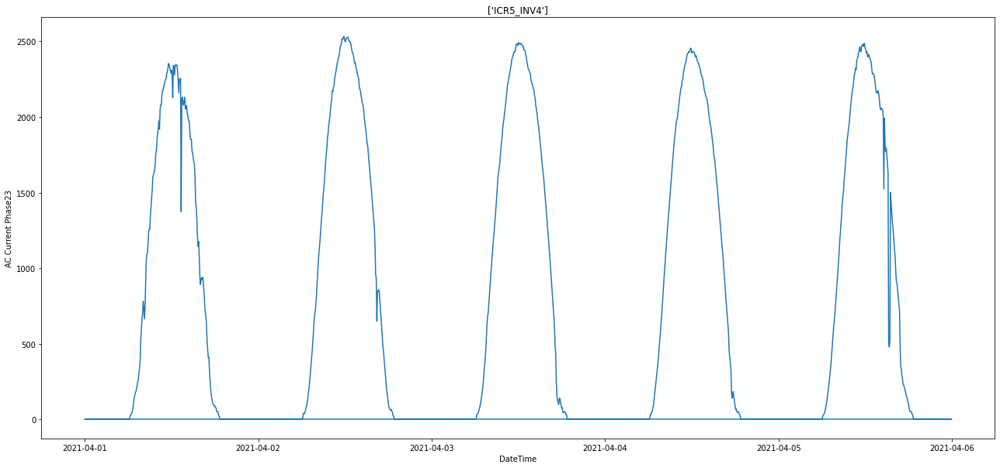

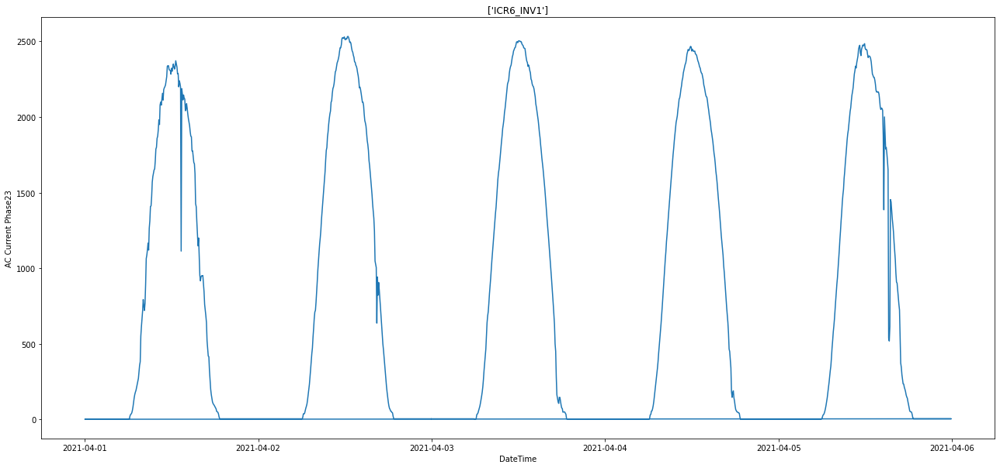

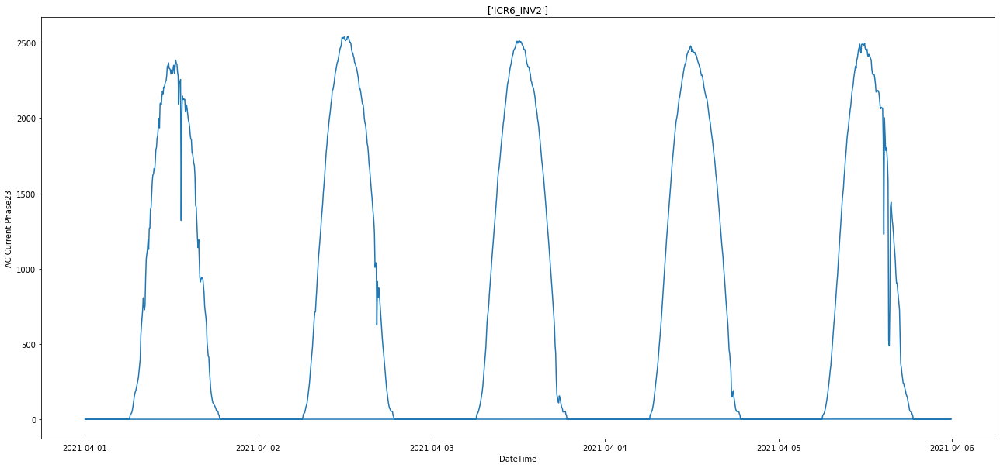

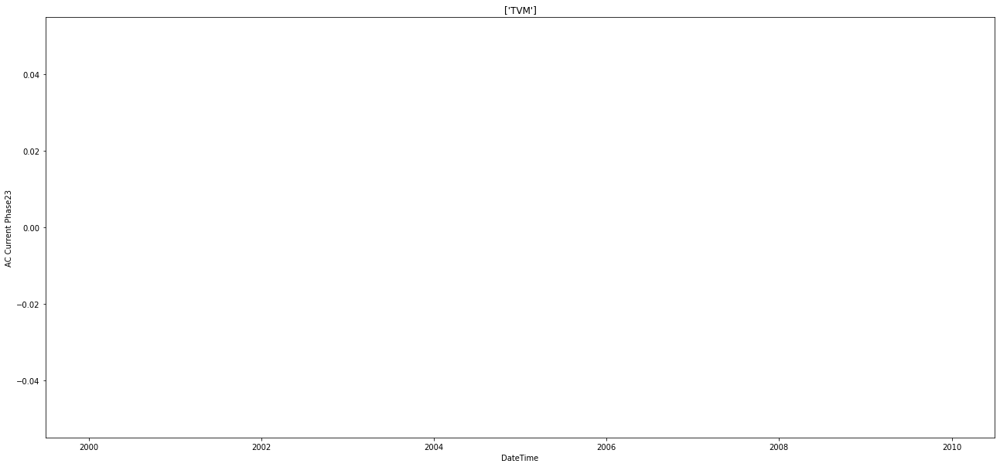

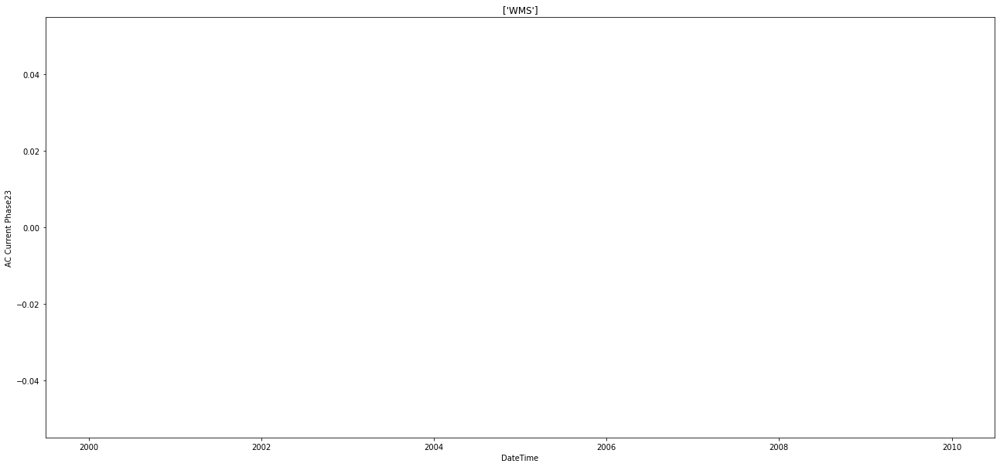

In [ ]:
r asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['AC Current Phase23'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('AC Current Phase23')
  plt.show()

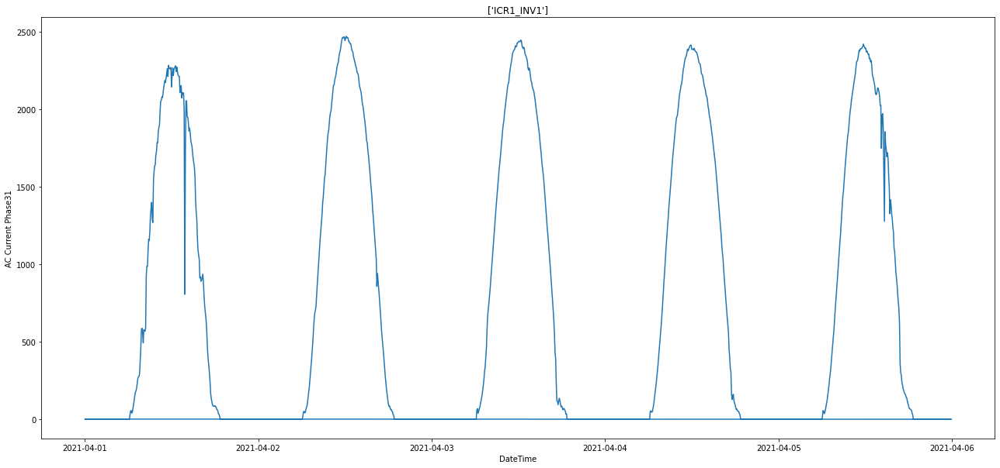

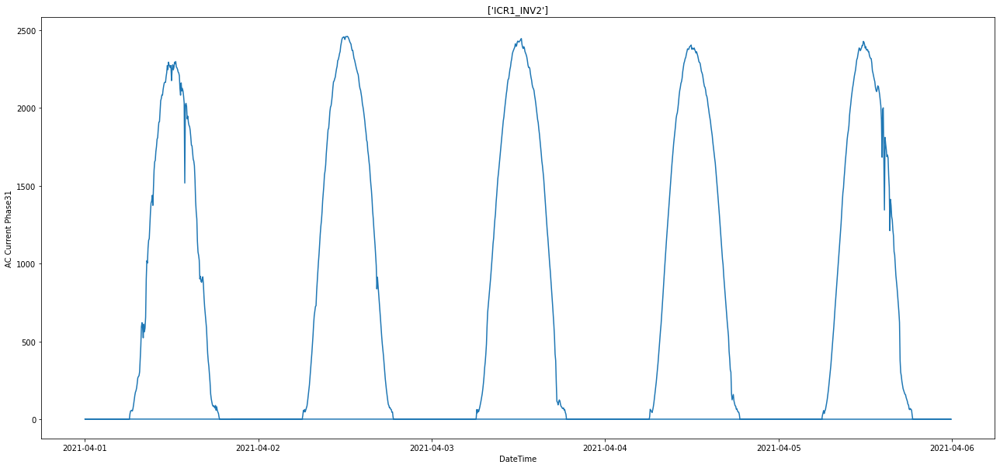

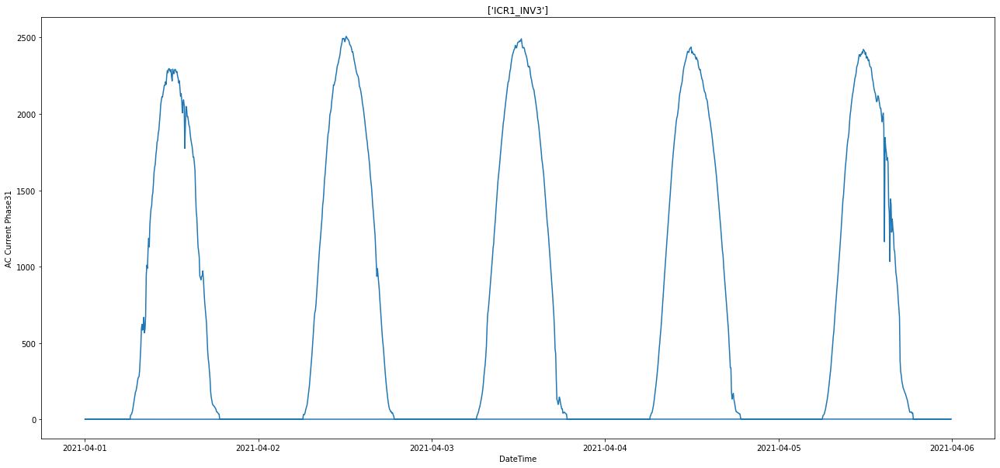

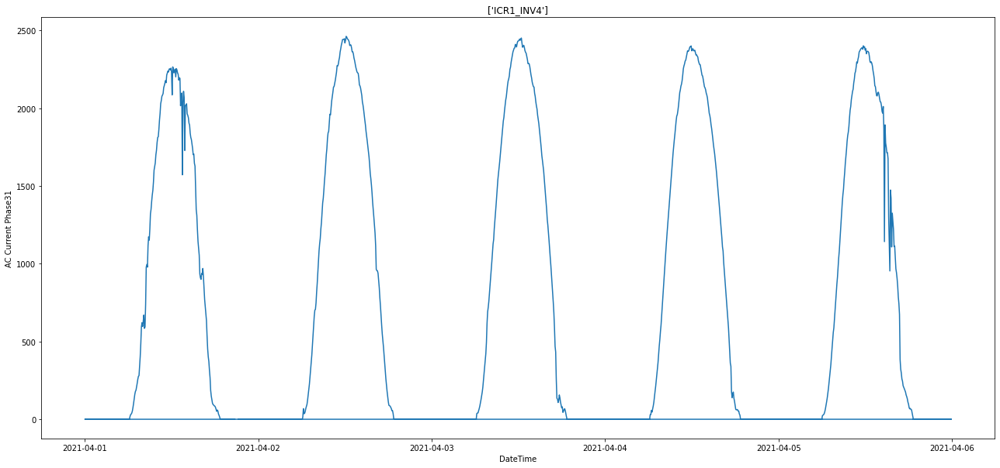

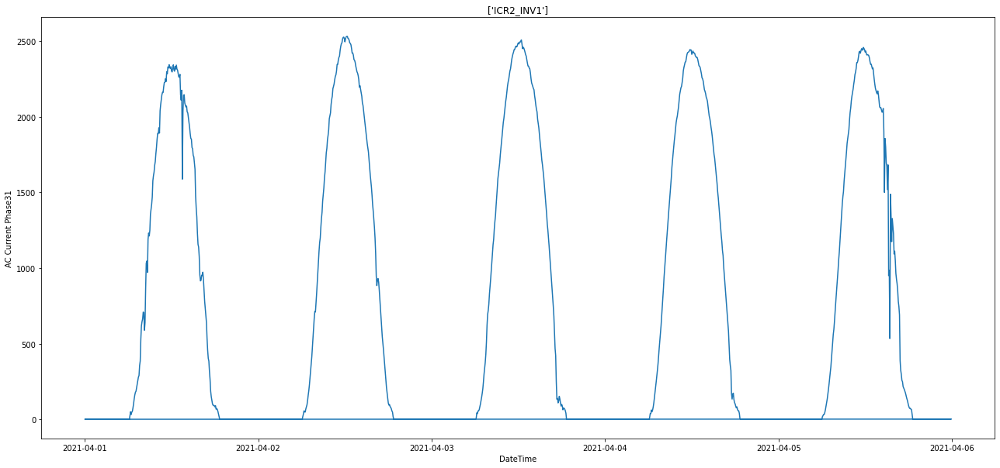

...

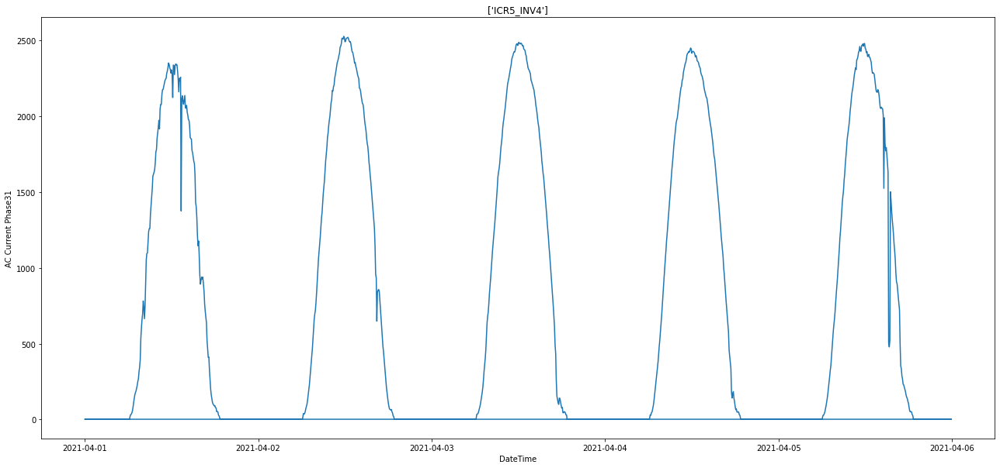

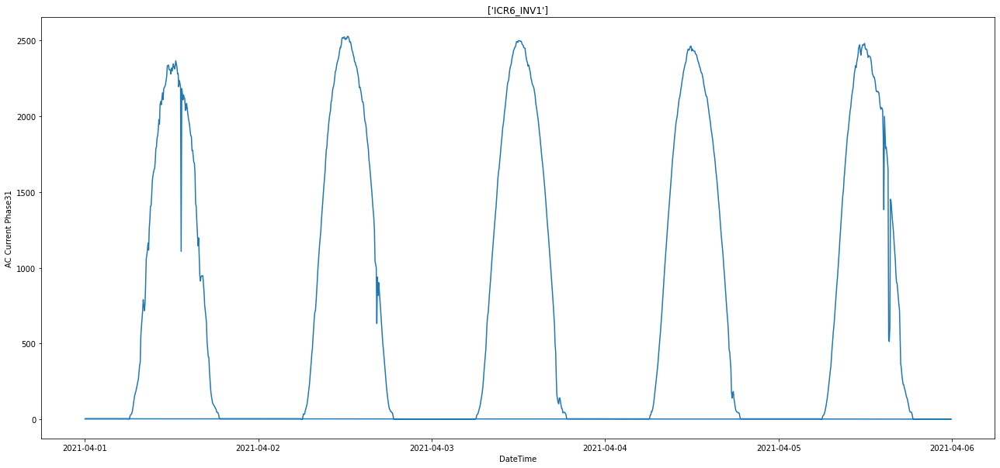

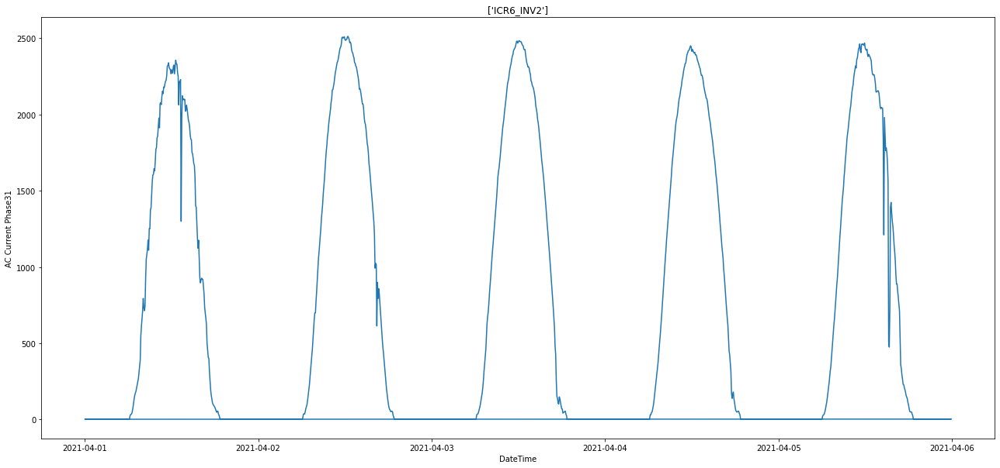

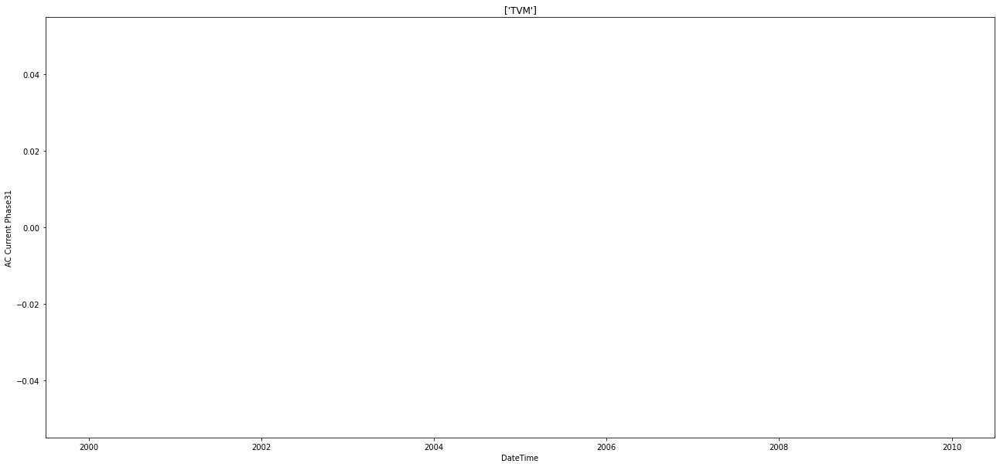

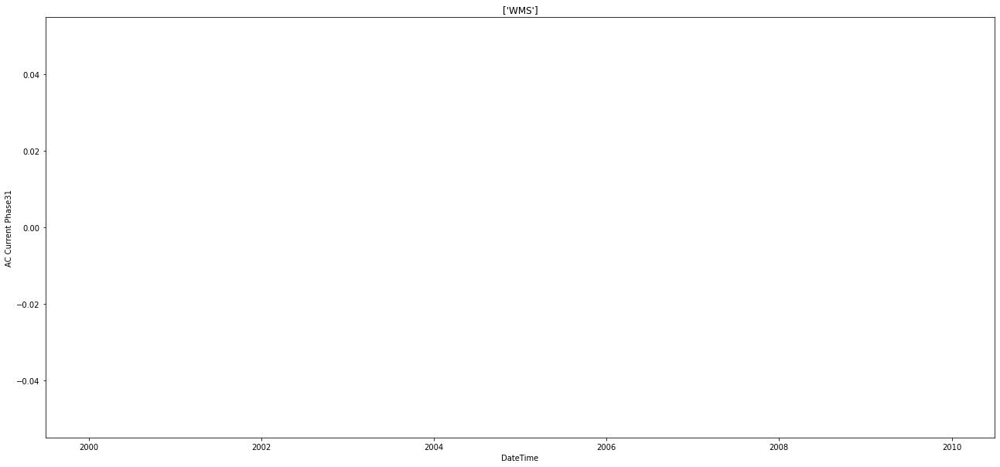

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['AC Current Phase31'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('AC Current Phase31')
  plt.show()

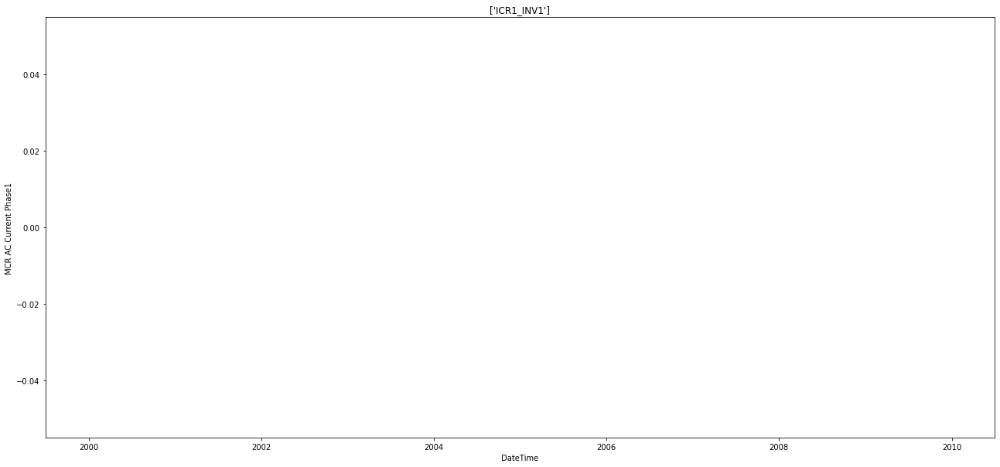

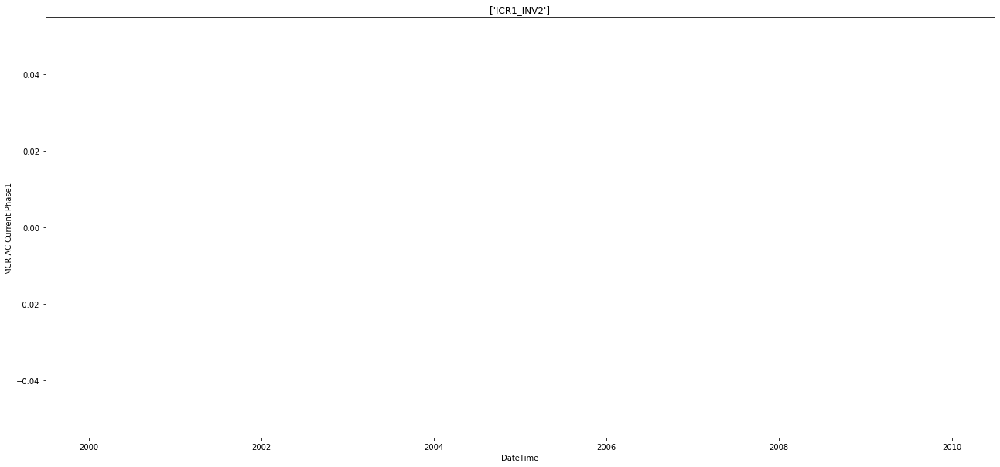

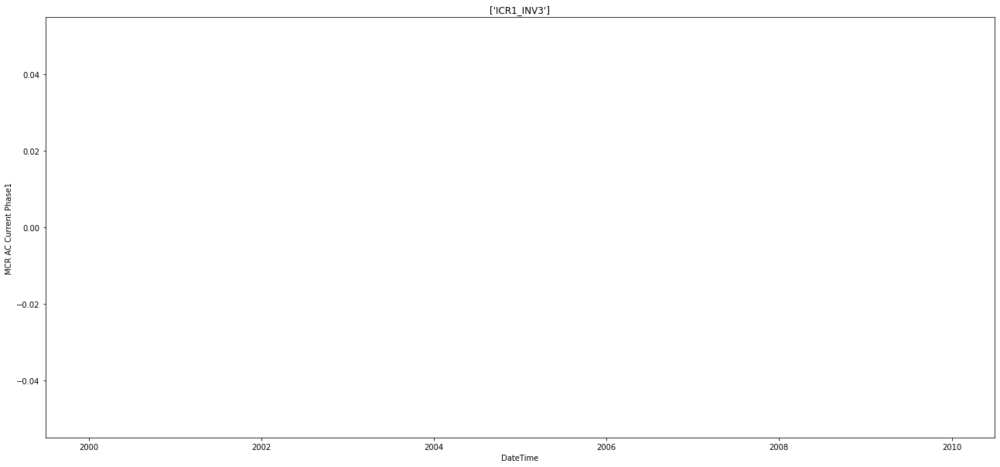

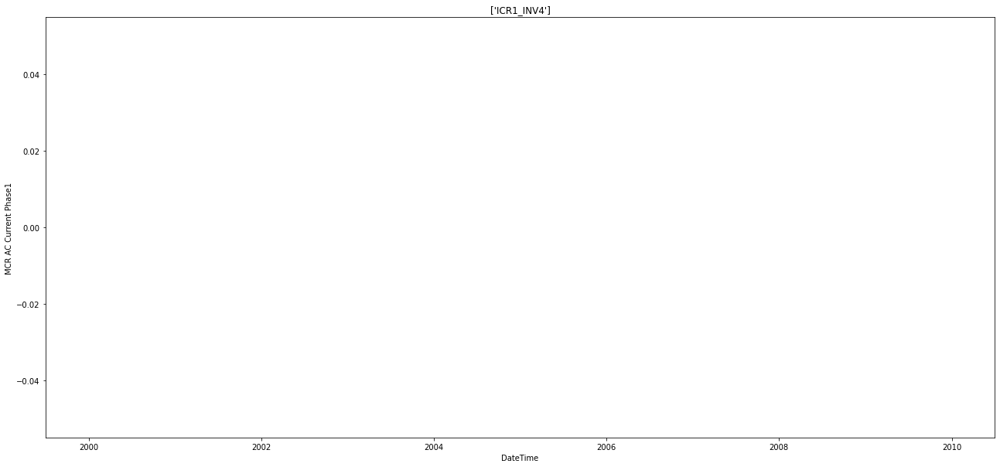

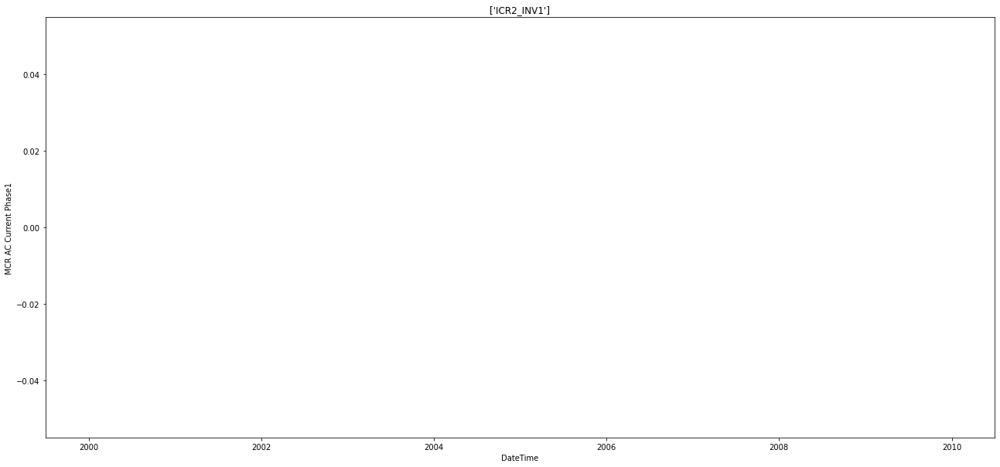

...

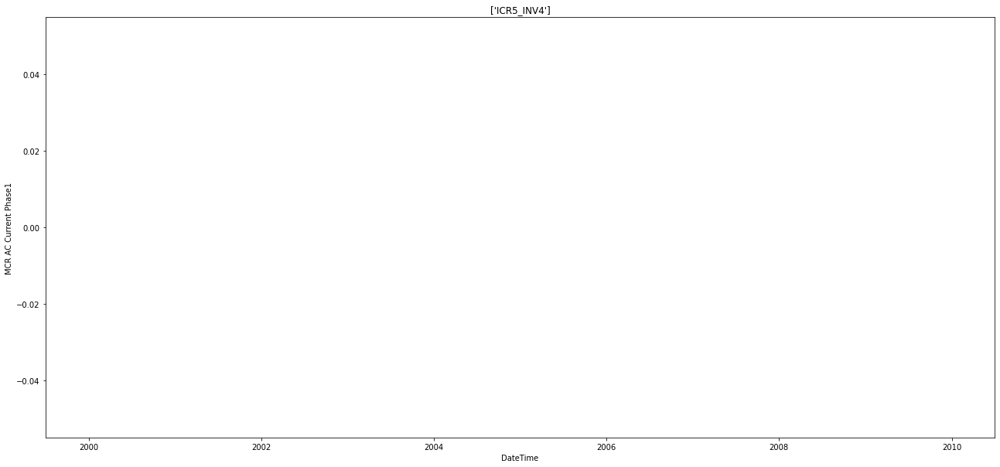

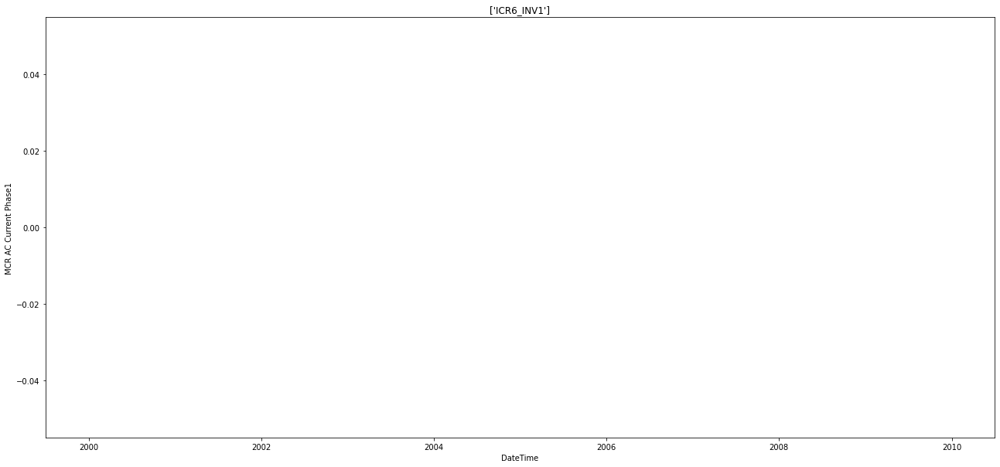

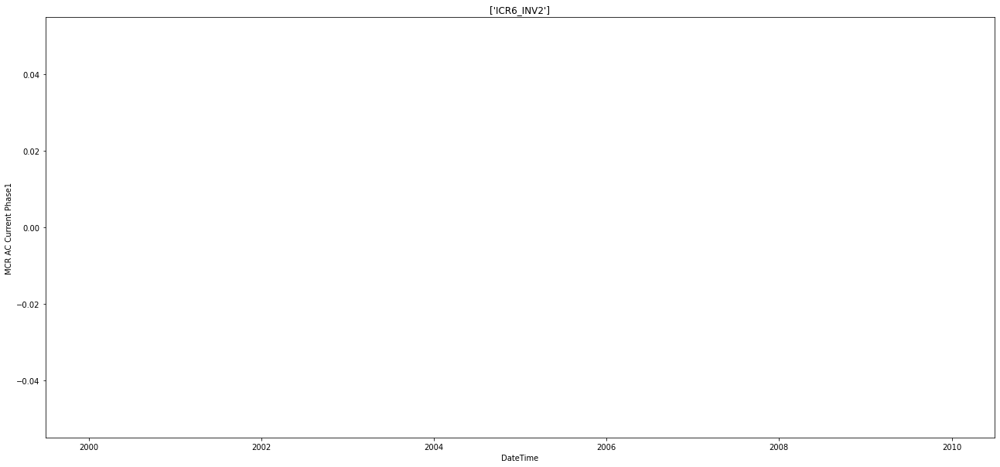

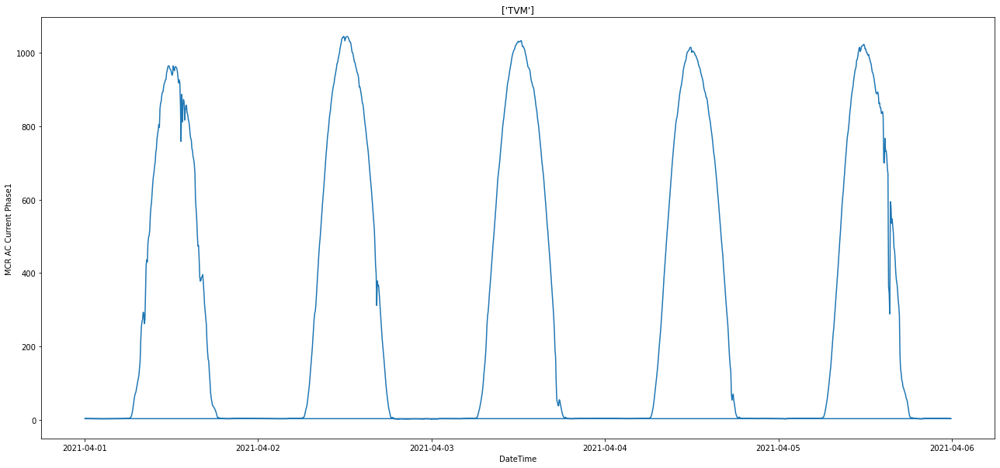

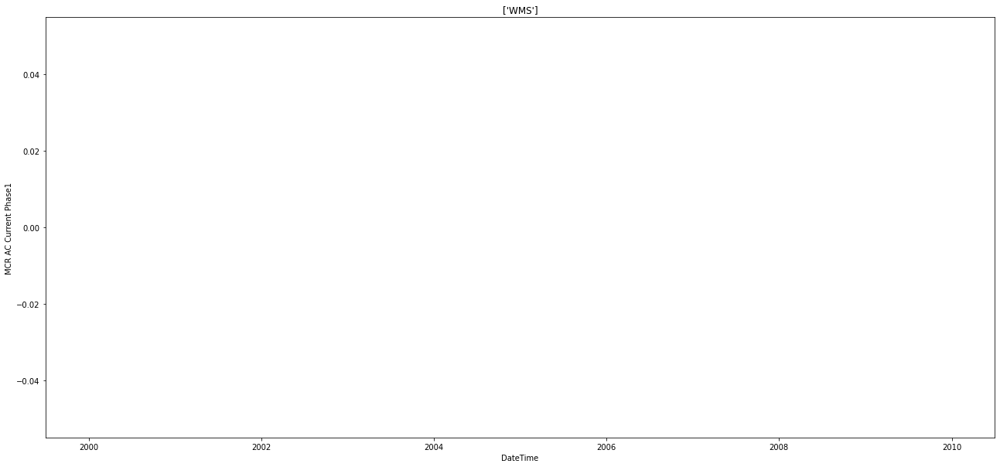

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['MCR AC Current Phase1'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('MCR AC Current Phase1')
  plt.show()

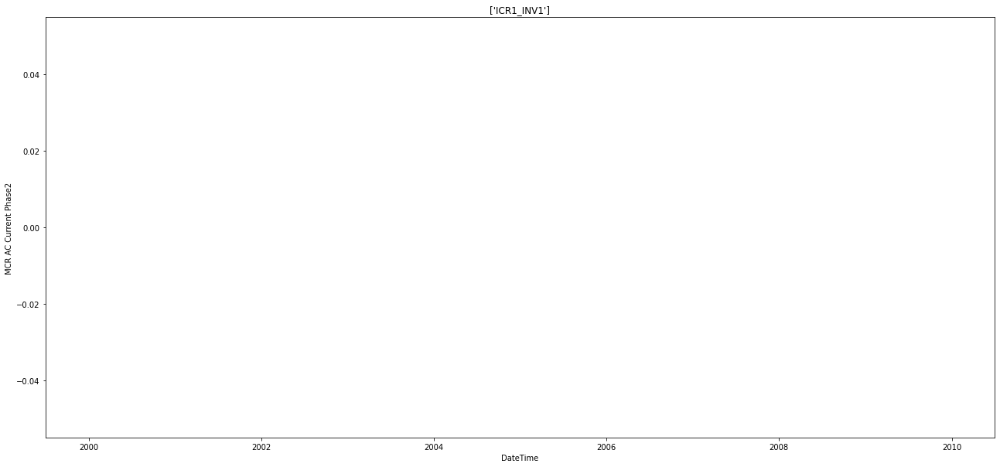

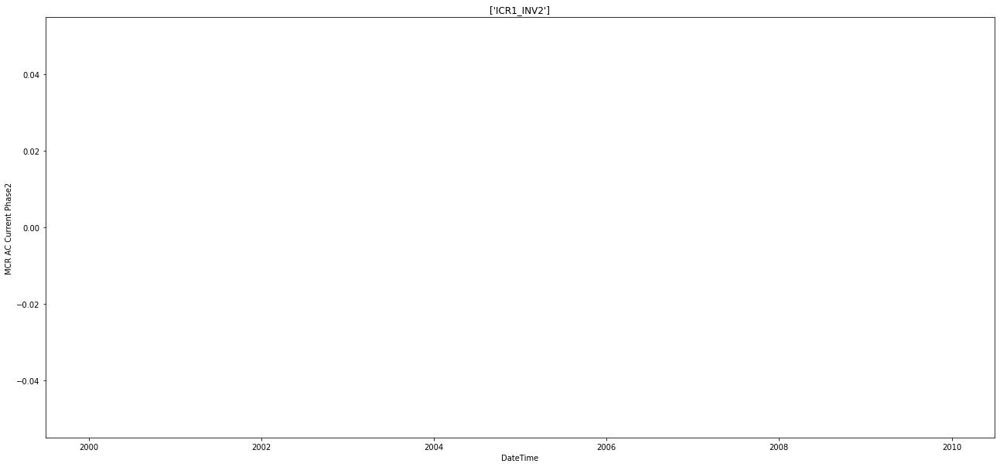

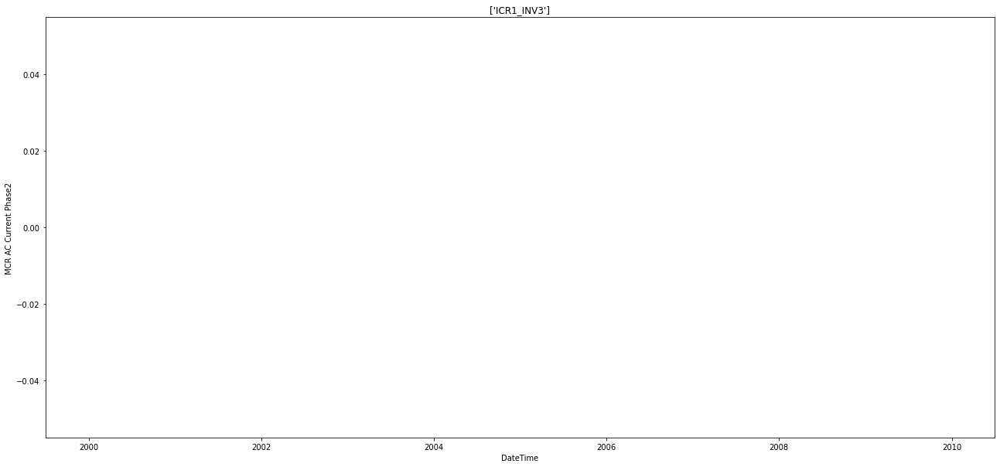

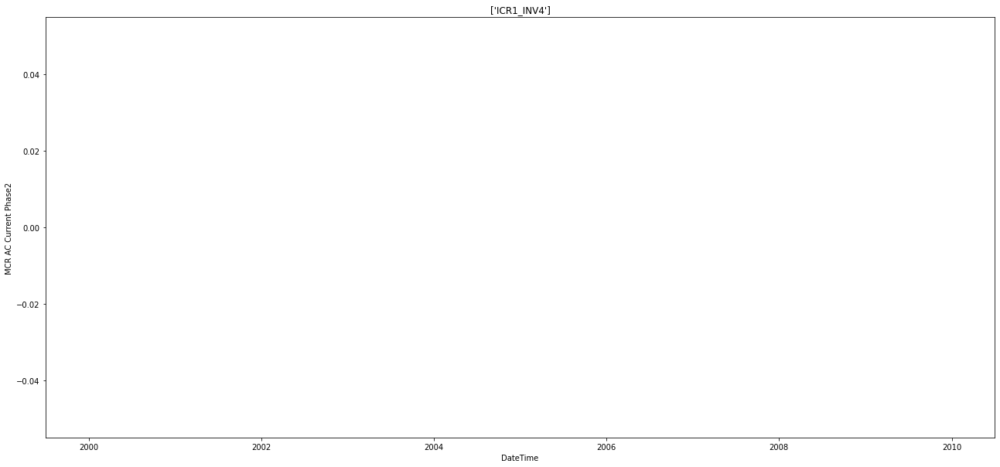

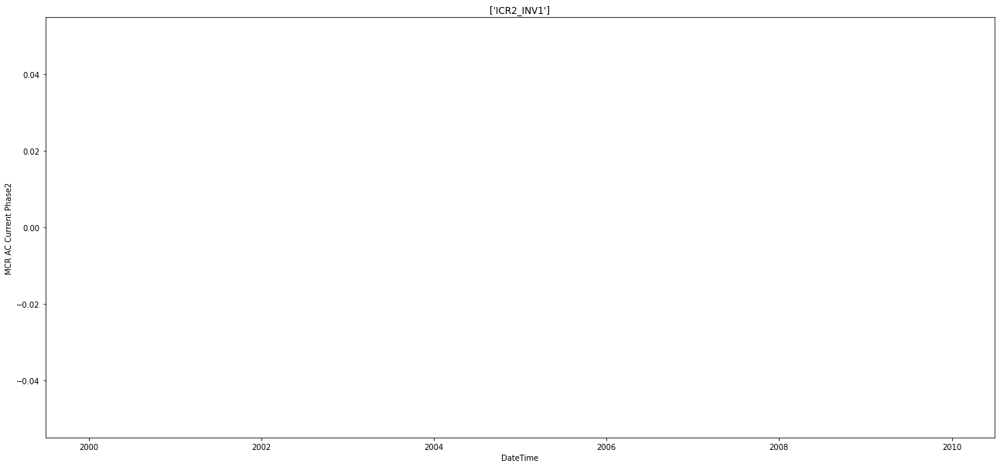

...

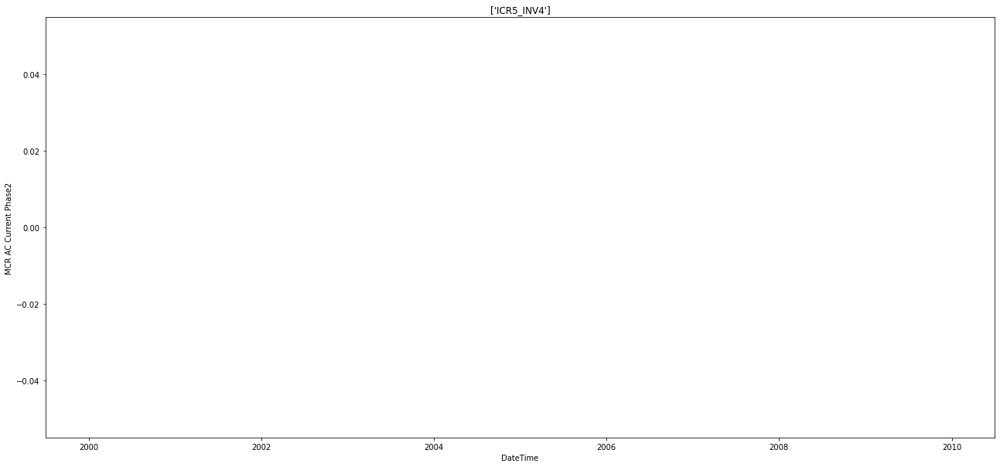

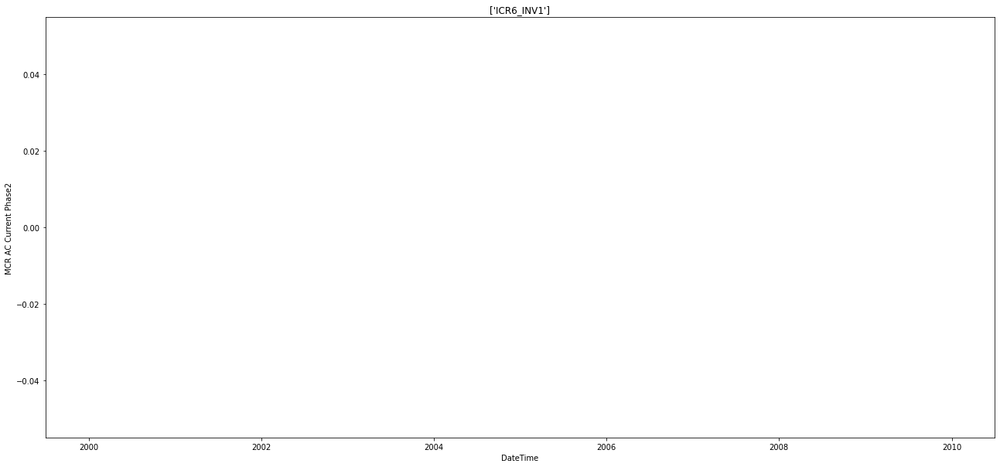

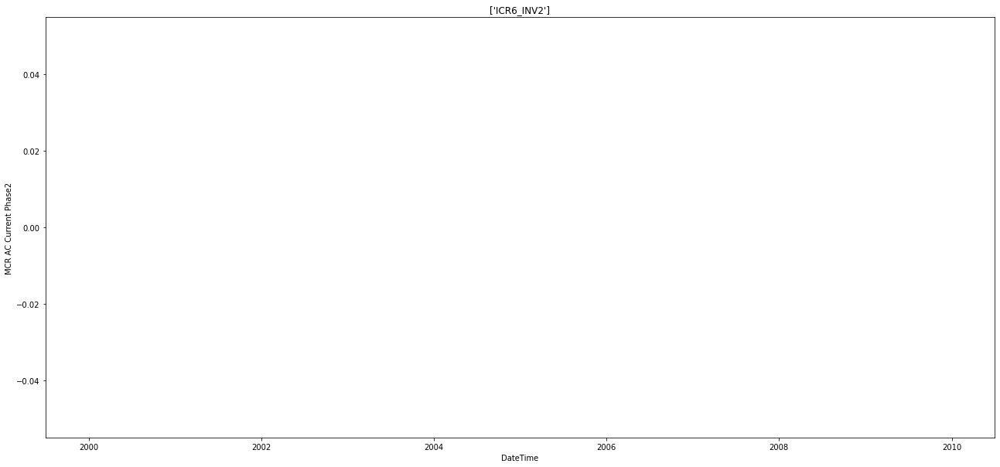

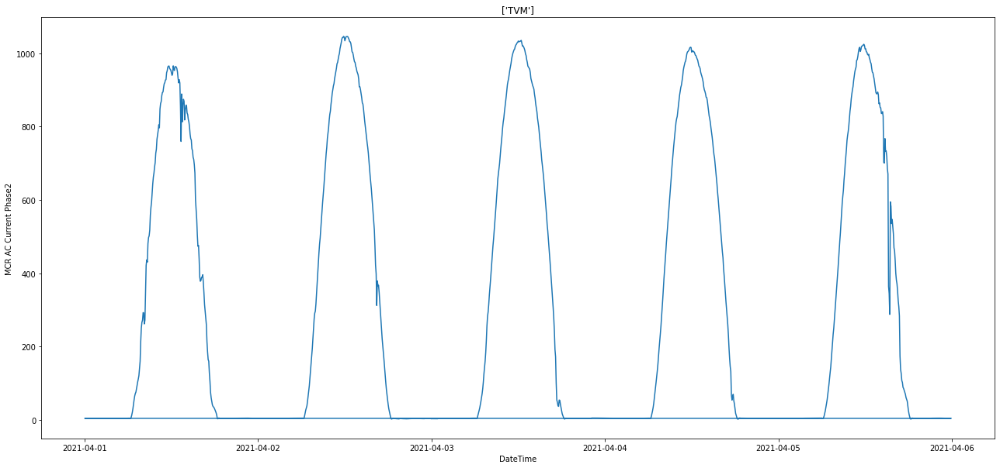

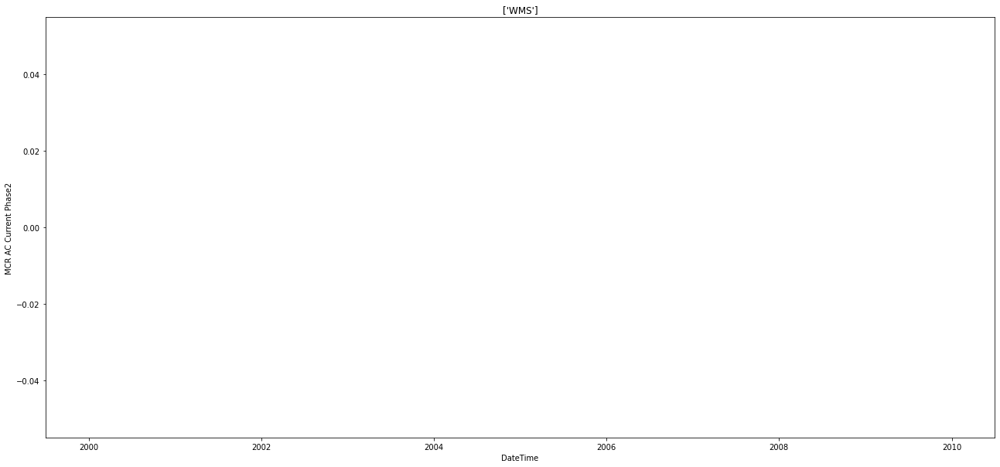

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['MCR AC Current Phase2'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('MCR AC Current Phase2')
  plt.show()

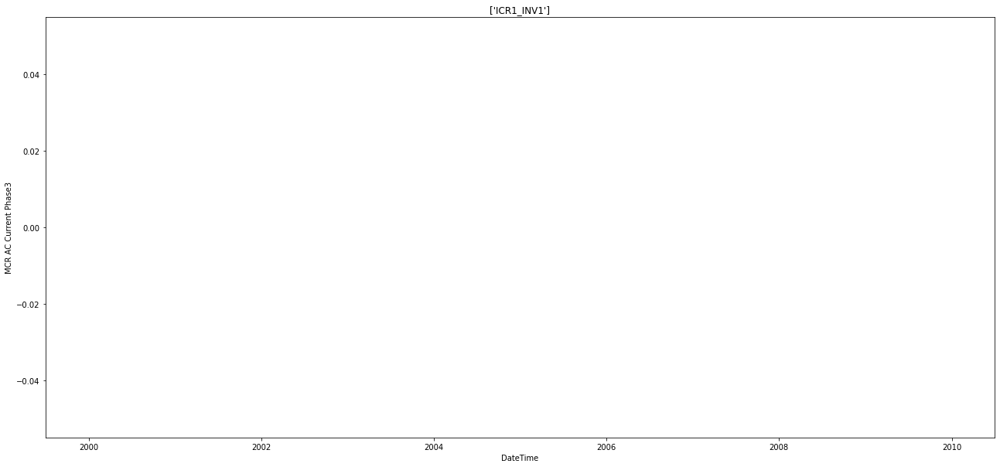

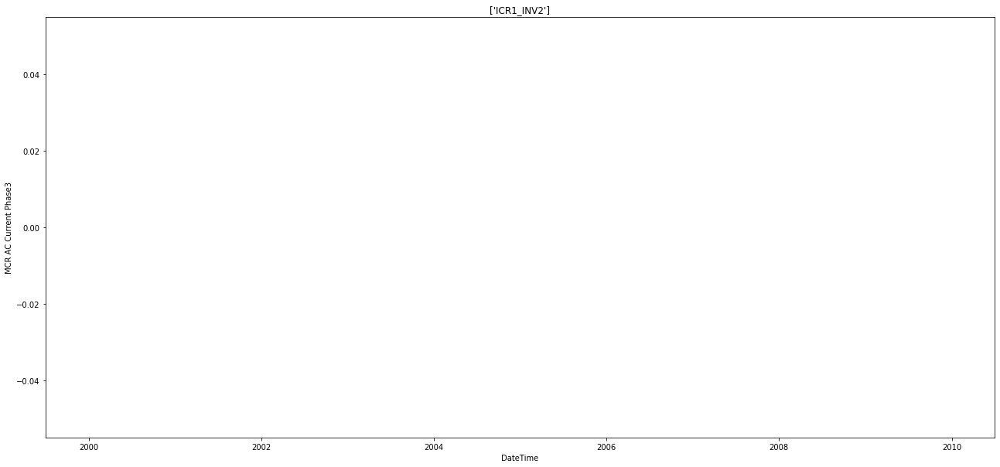

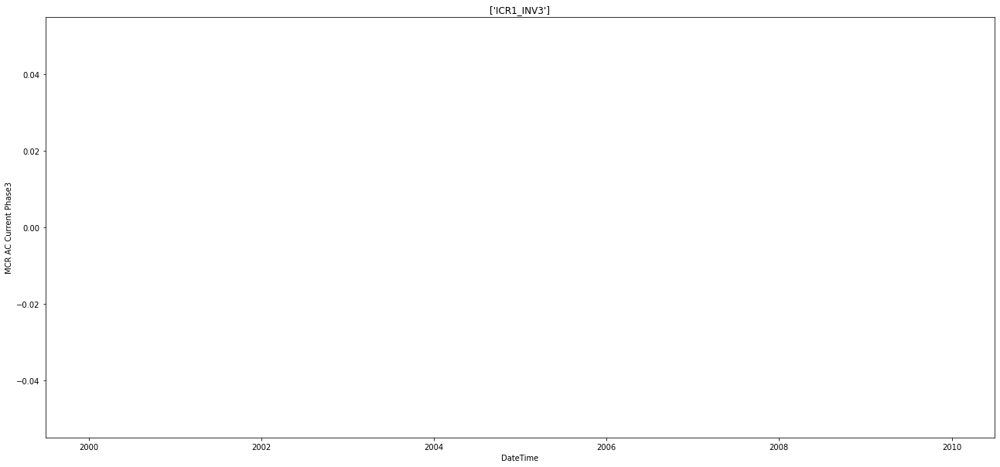

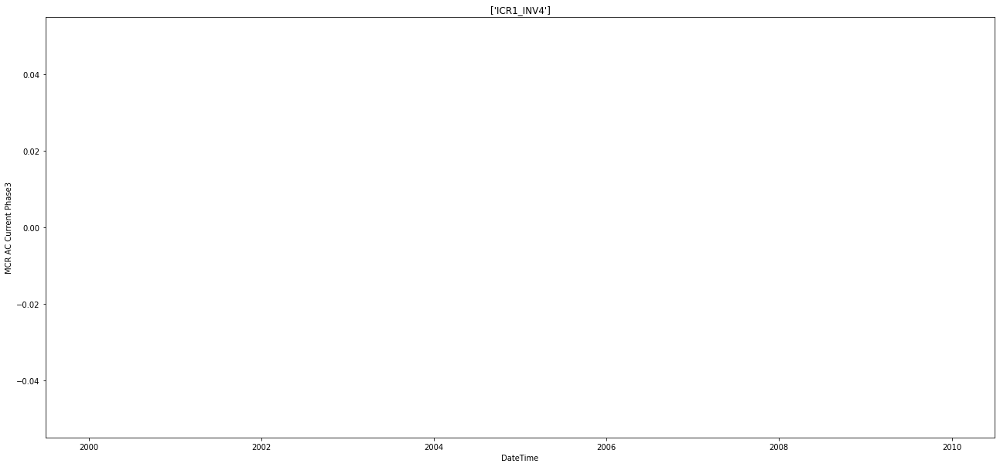

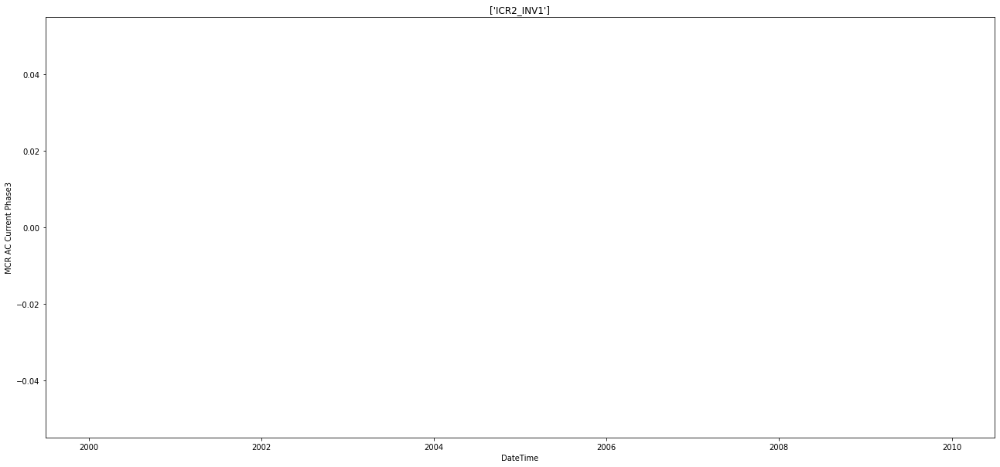

...

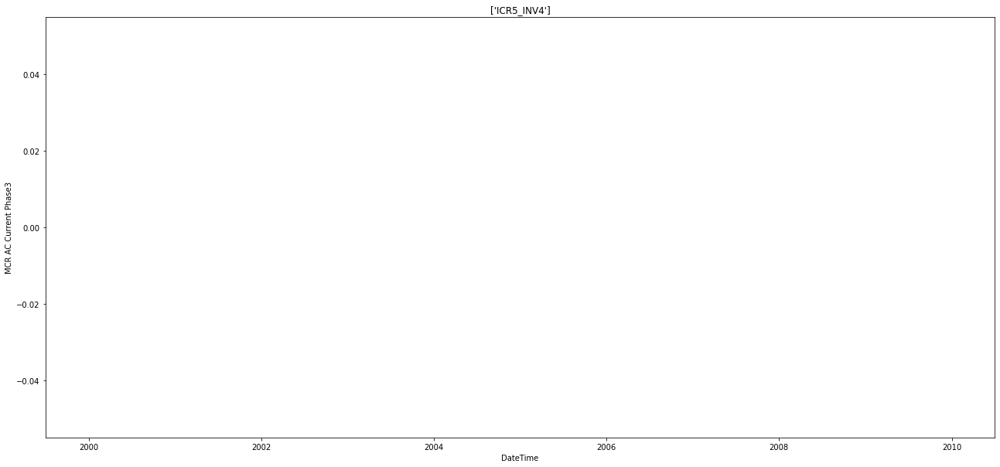

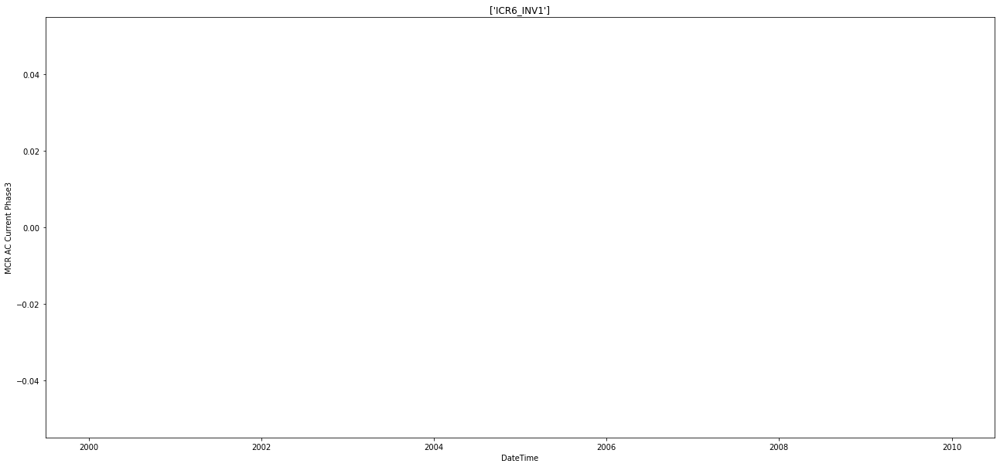

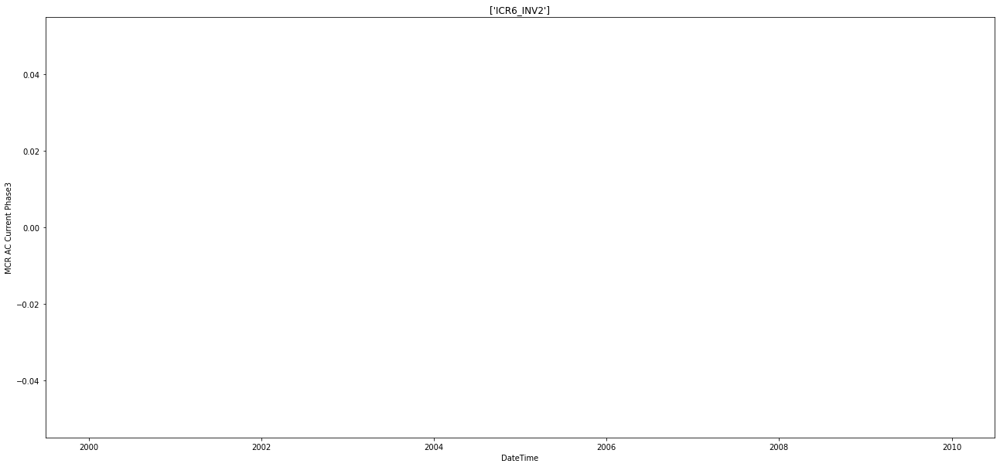

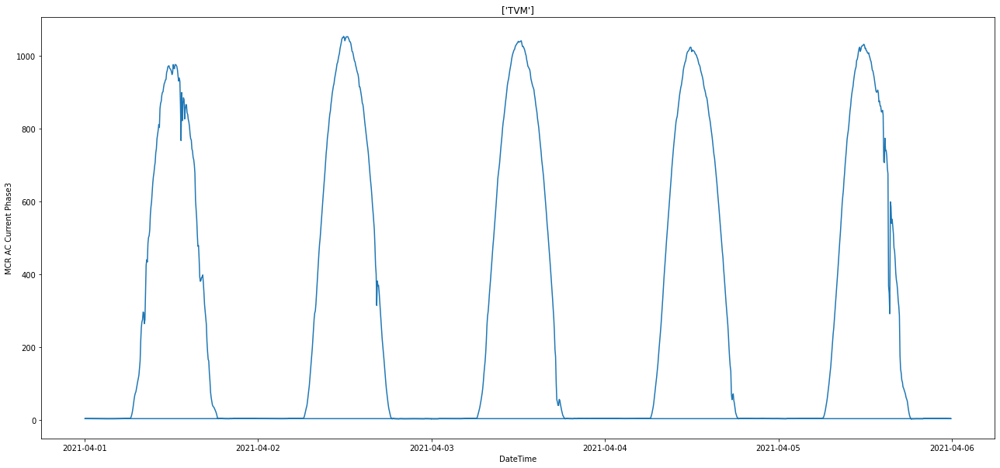

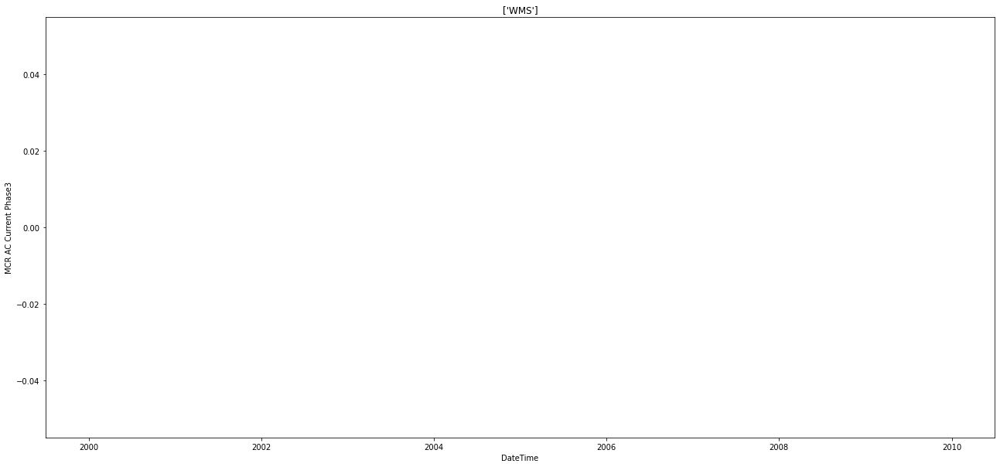

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['MCR AC Current Phase3'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('MCR AC Current Phase3')
  plt.show()

#Conclusion: DateTime vs AC Power for various AssetName
We can make the following very important conclusions from the above results :


*   All the ICR_INV values for AC Current values are almost same with +_2% variance. Very similar variance levels were found for DC Power wrt ICR_INV values. Hence we need not take all ICR_INV columns values and just take one out of the 22 ICR_INV values.
*   There are 3 different AC Phase current values and all of them have almost the same values and hence we need not take all three columns into consideration.

*   The MCR AC Current values are being measured only by AssetName 'TVM', hence this sensor might be the only one measuring MCR values. All the three phase MCR Current values are also with very small variance, hence we need not take all three columns into consideration.<br>**Take one of the 3 AC Current Phase values with one of the ICR_INV as input, and take one of the 3 MCR AC Current values with AssetName TVM.**





# **Analysis: Voltage values vs DateTime for different AssetNames**

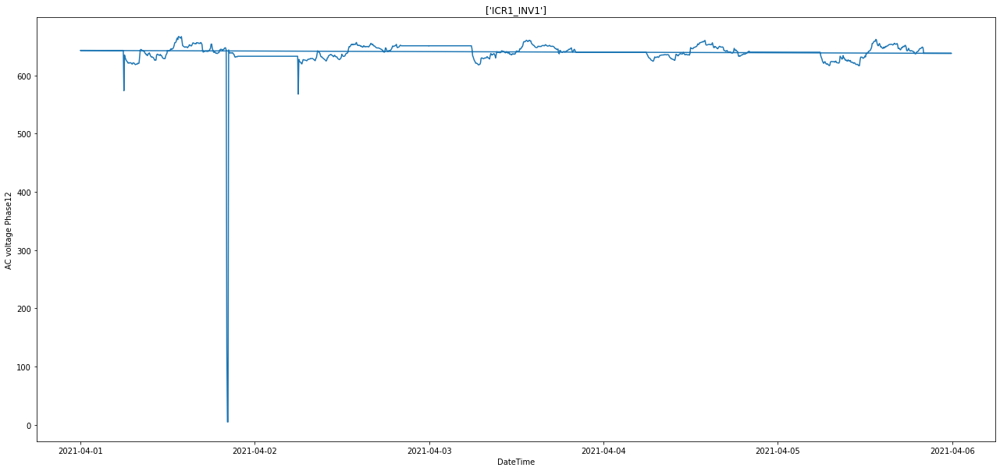

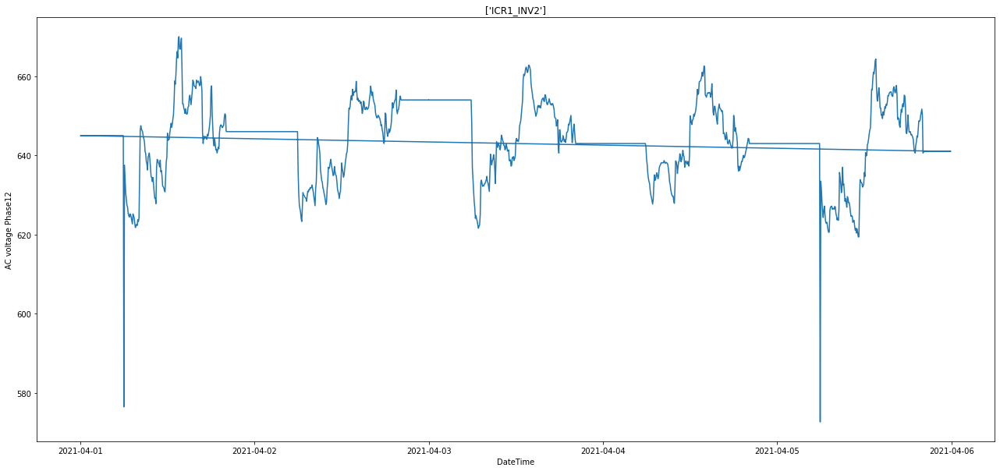

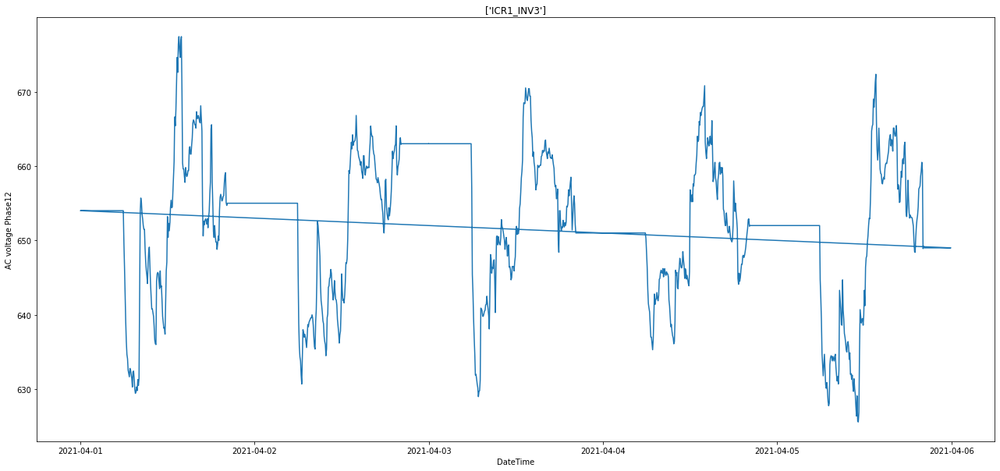

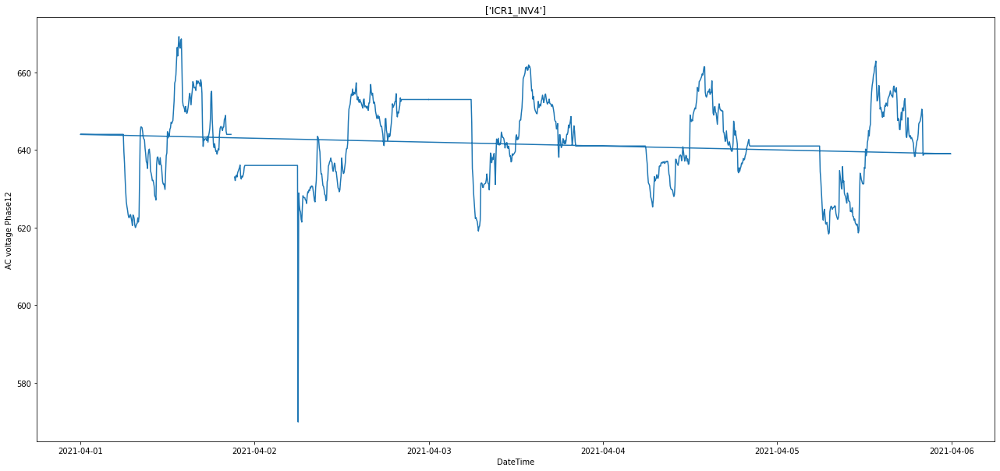

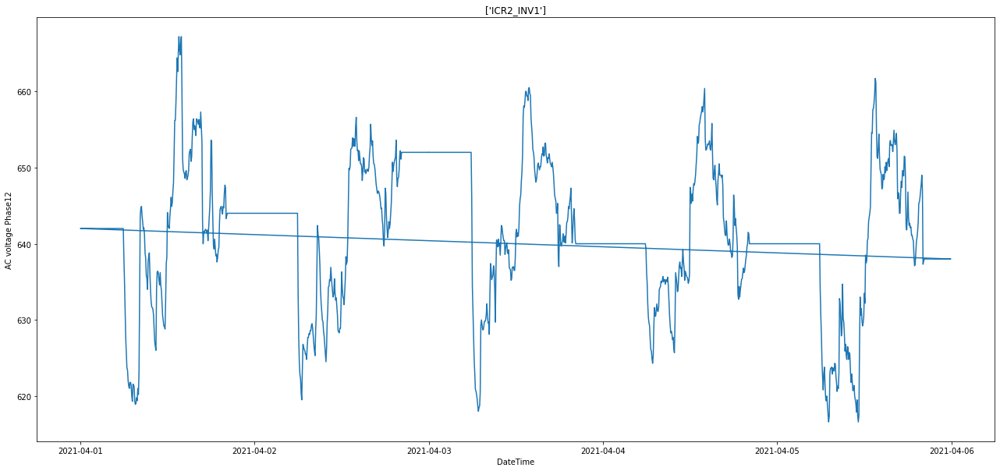

...

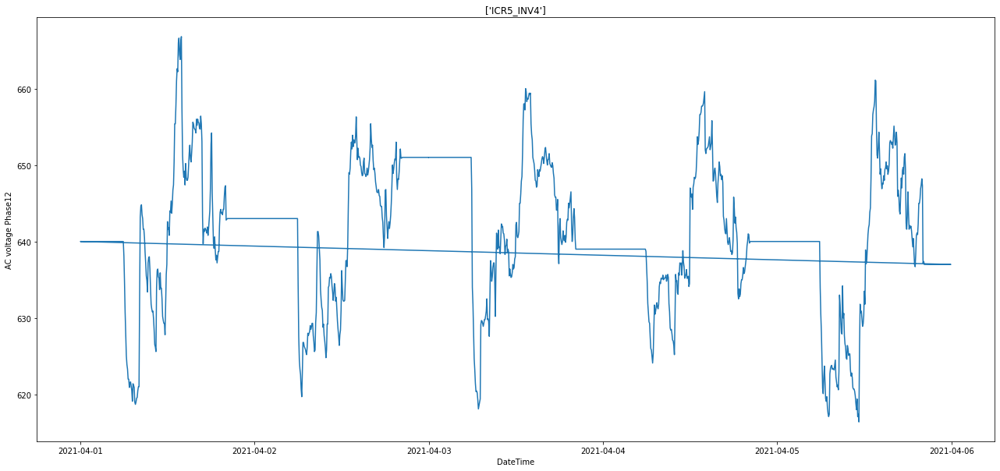

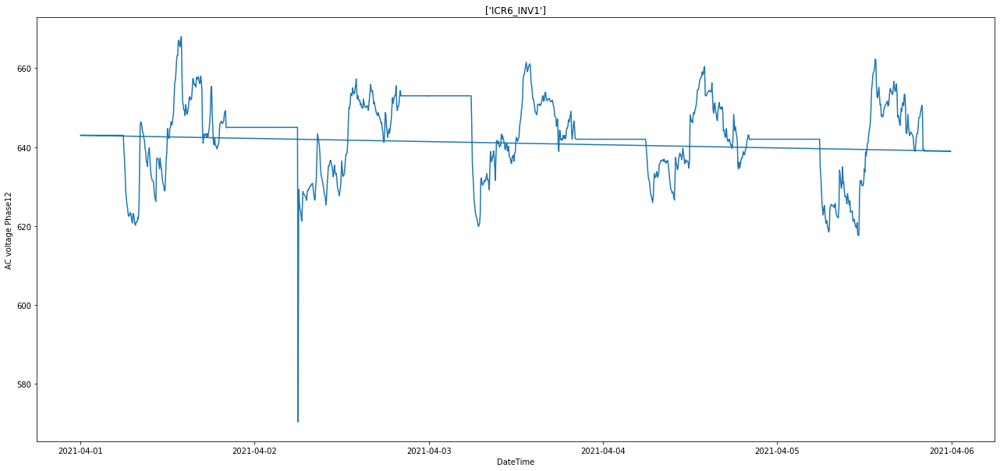

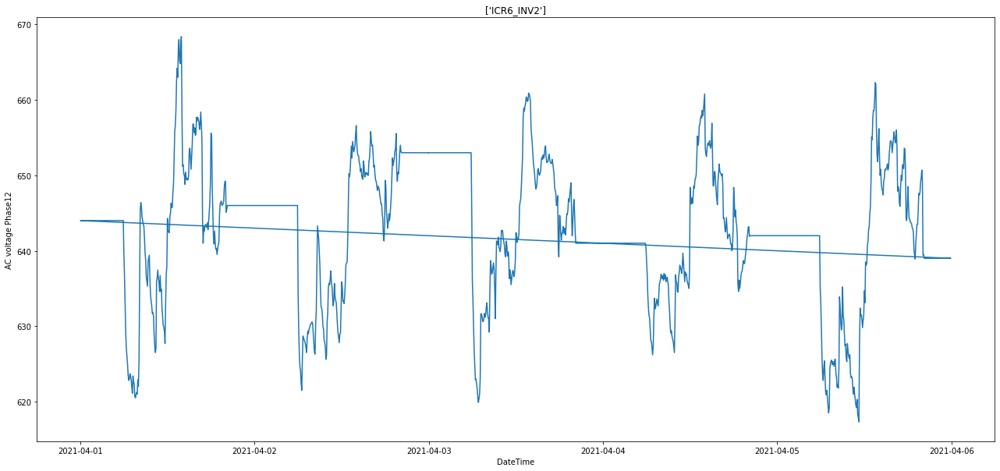

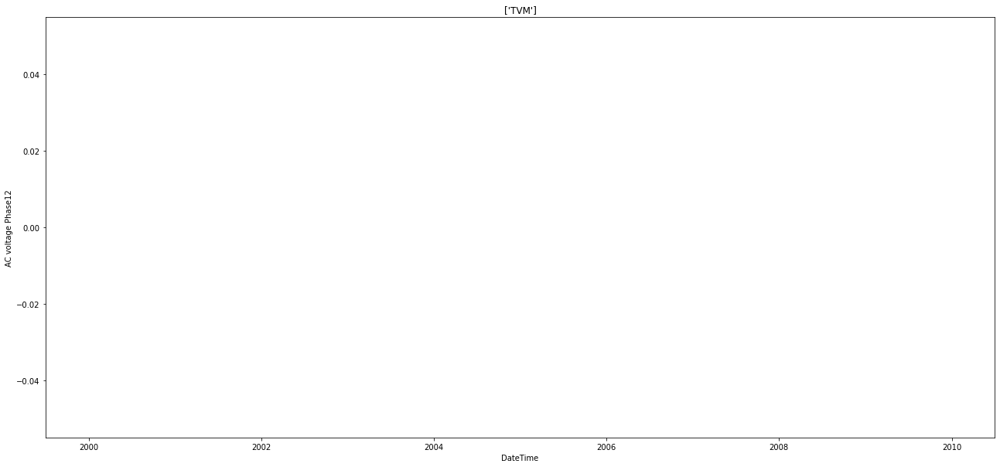

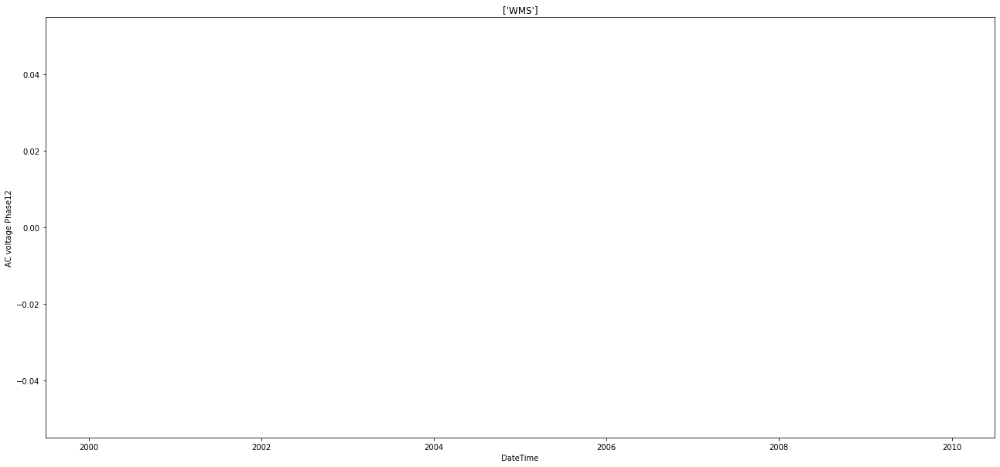

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['AC voltage Phase12'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('AC voltage Phase12')
  plt.show()

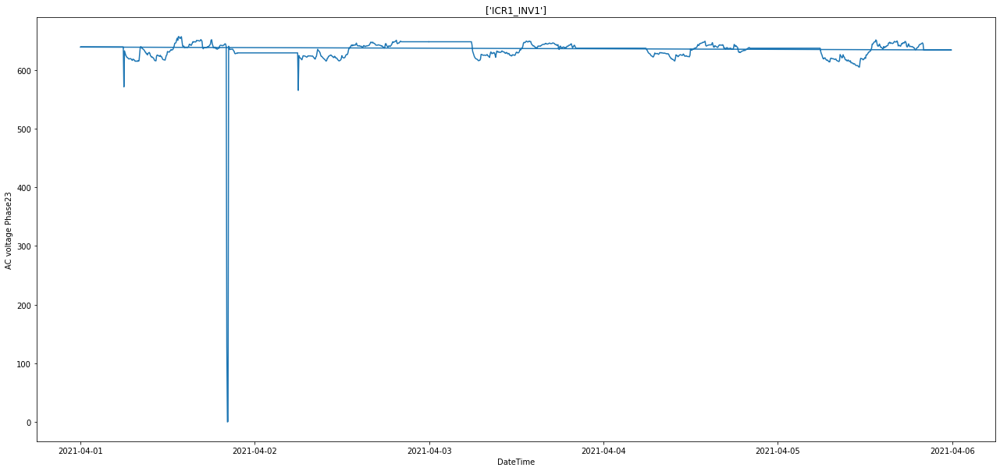

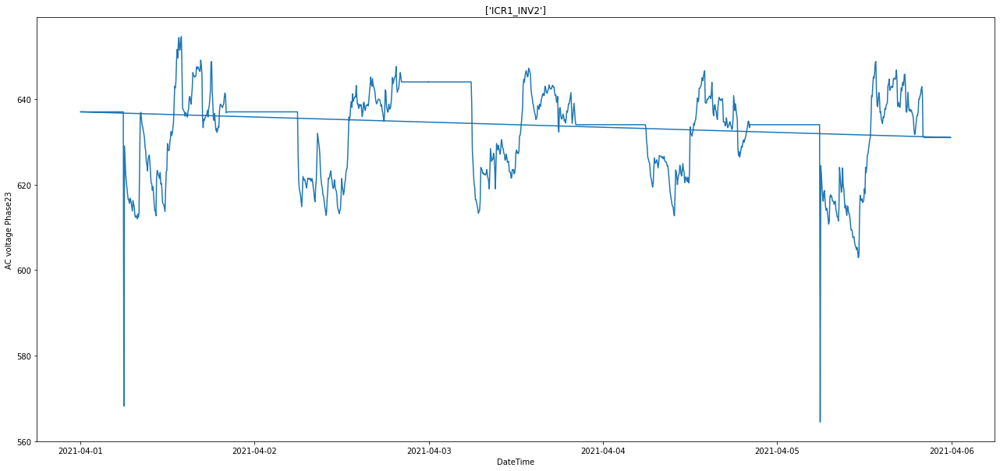

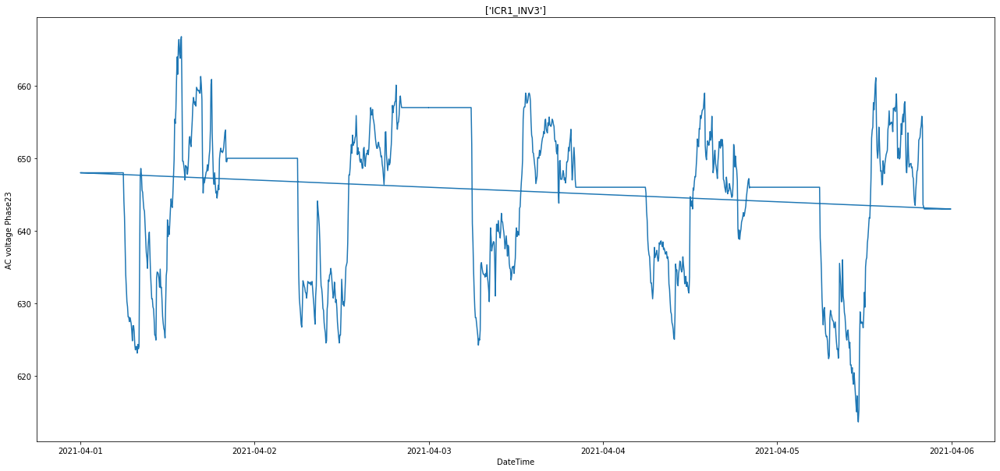

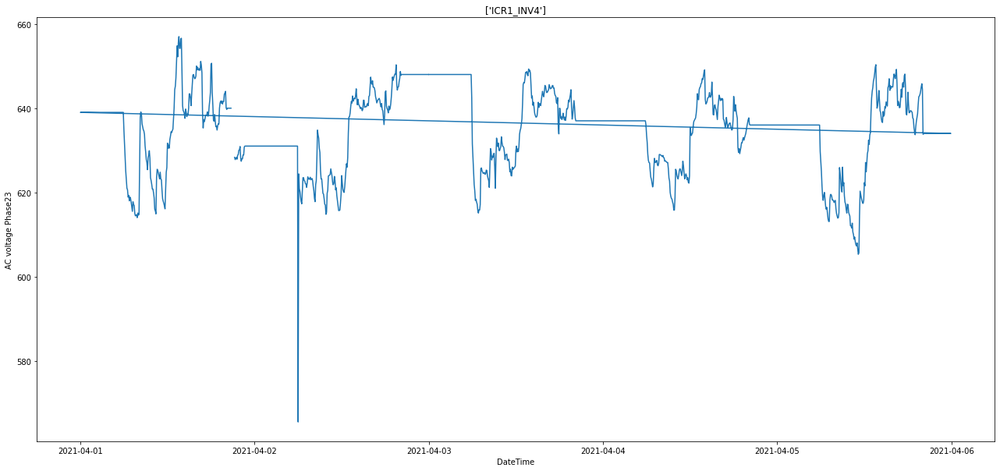

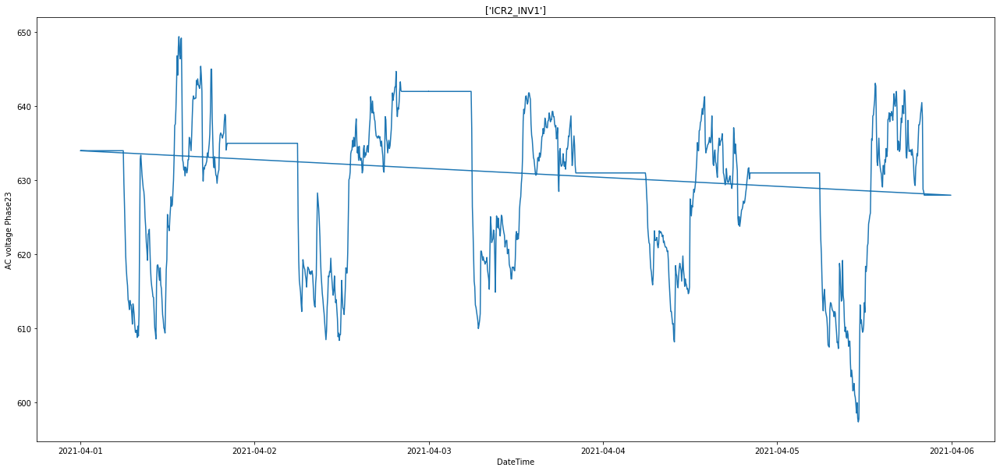

...

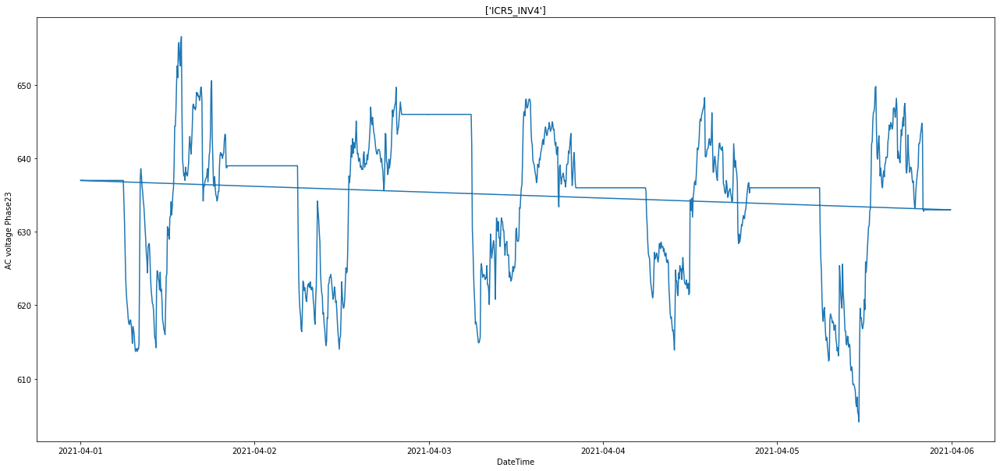

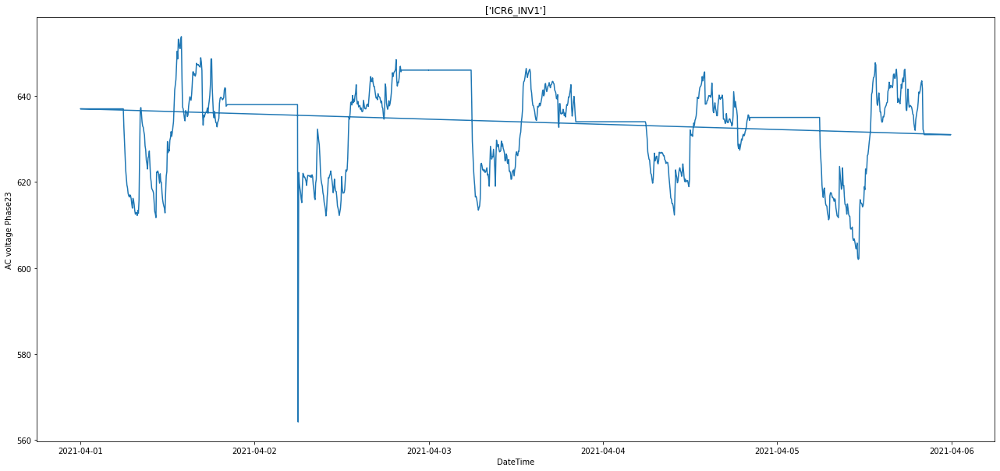

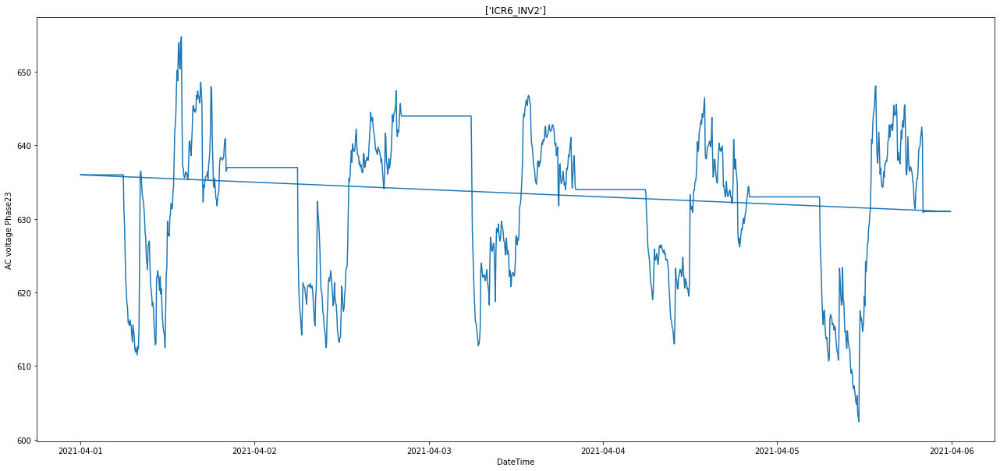

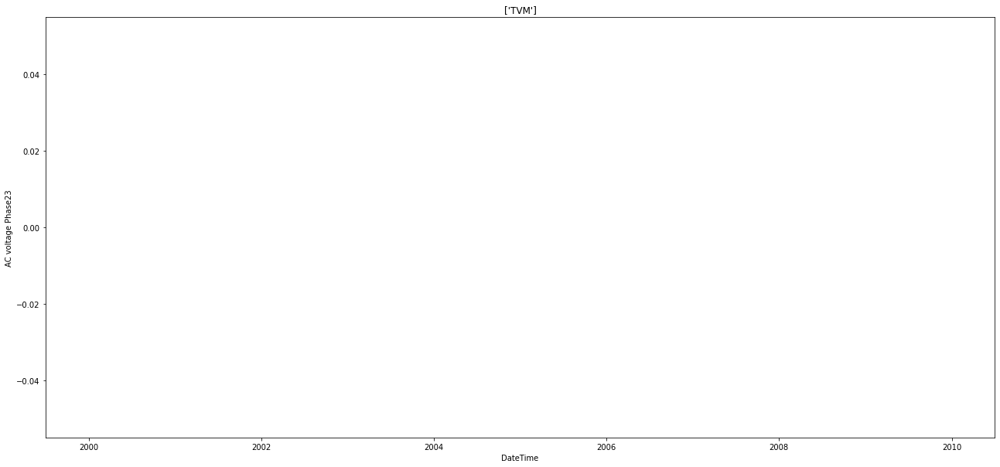

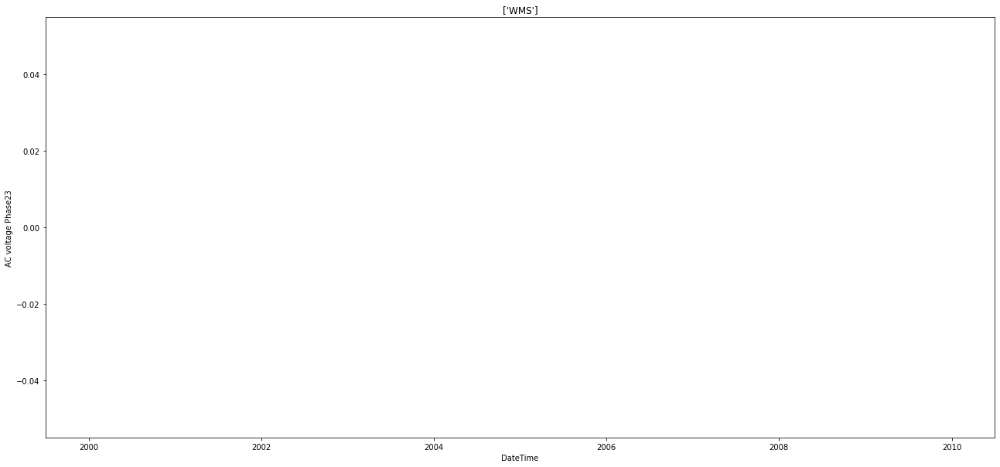

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['AC voltage Phase23'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('AC voltage Phase23')
  plt.show()

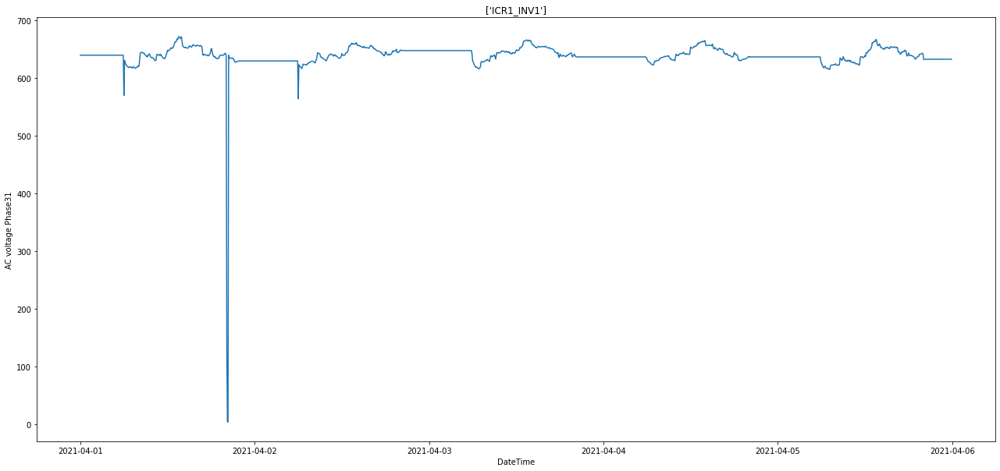

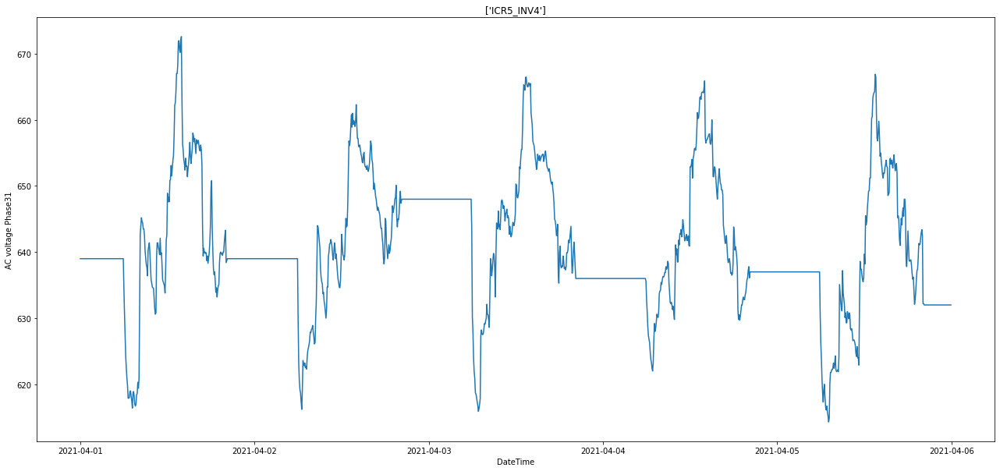

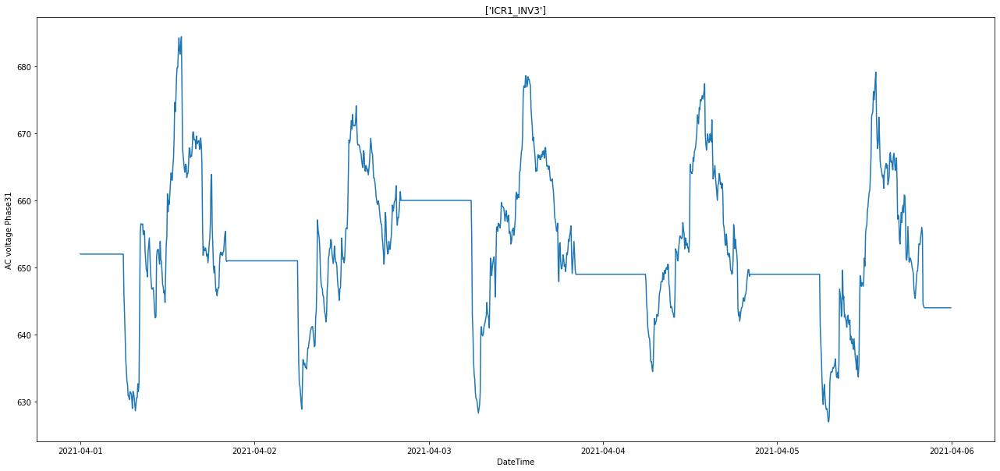

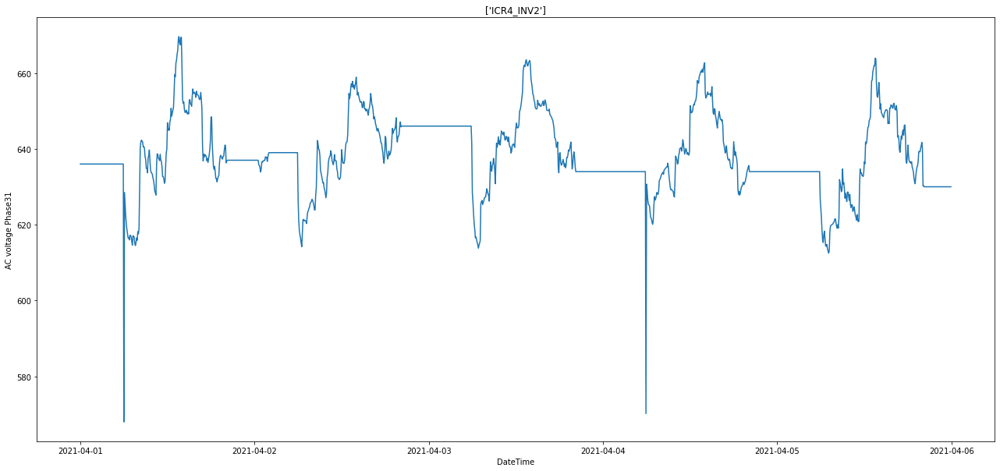

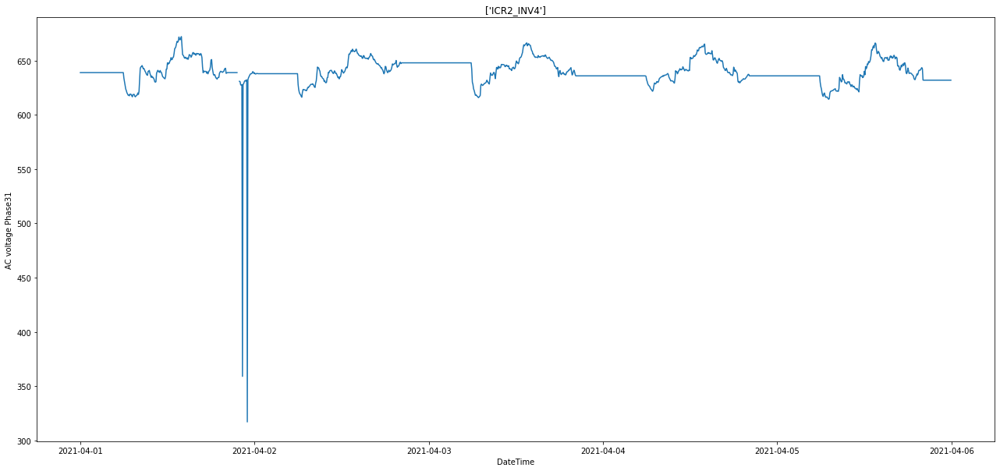

...

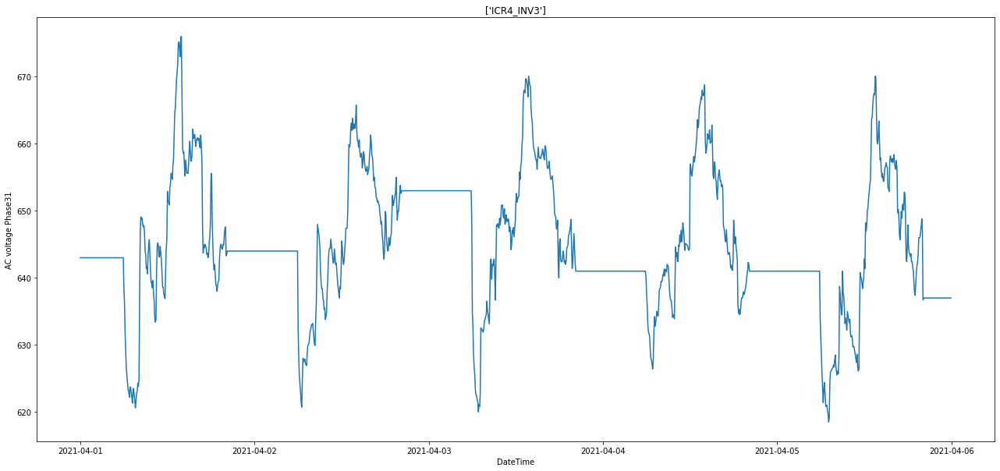

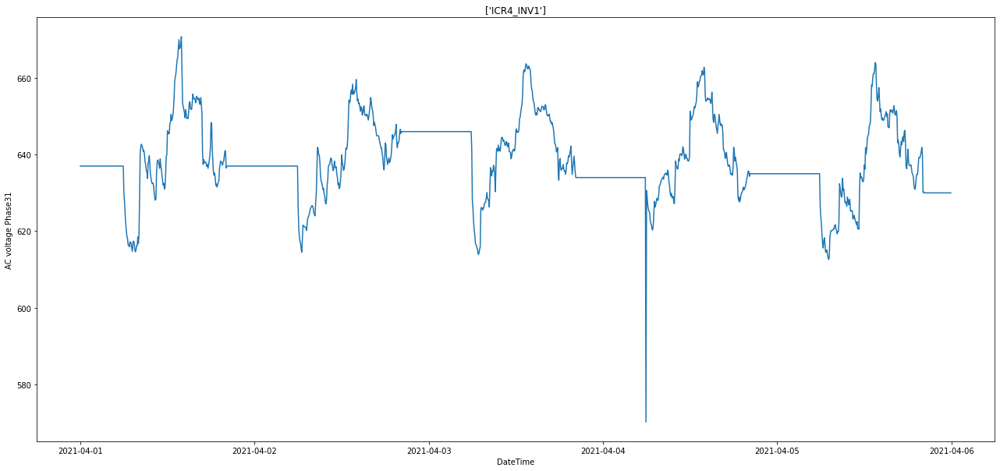

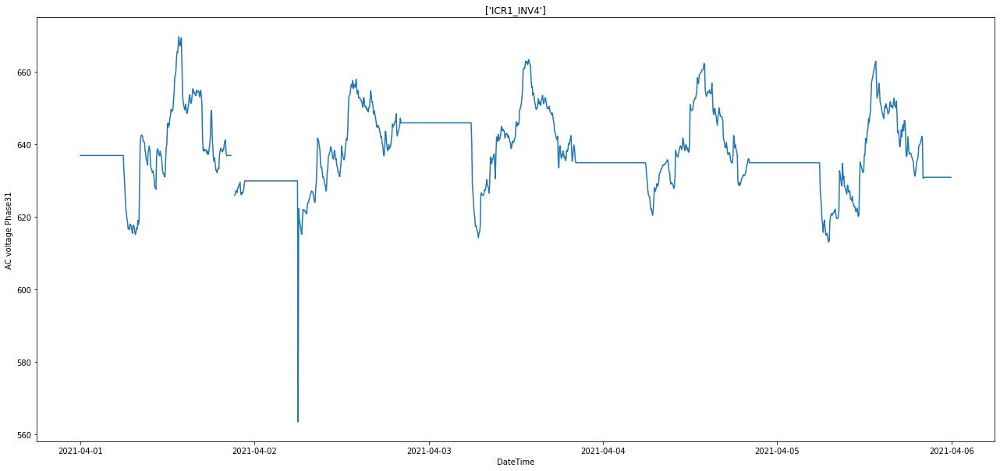

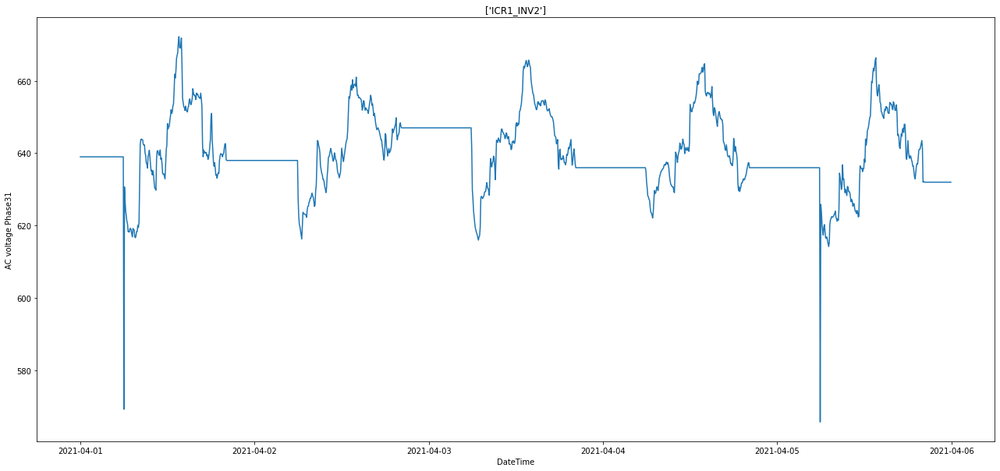

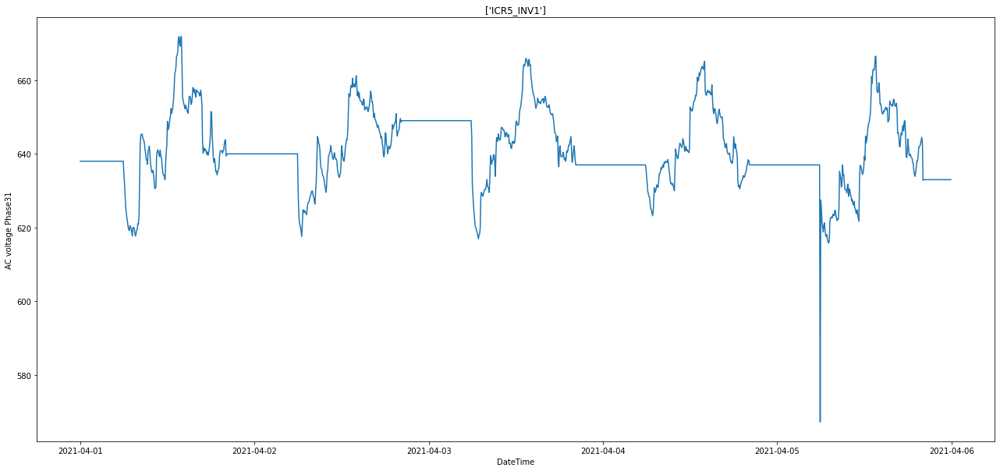

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['AC voltage Phase31'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('AC voltage Phase31')
  plt.show()

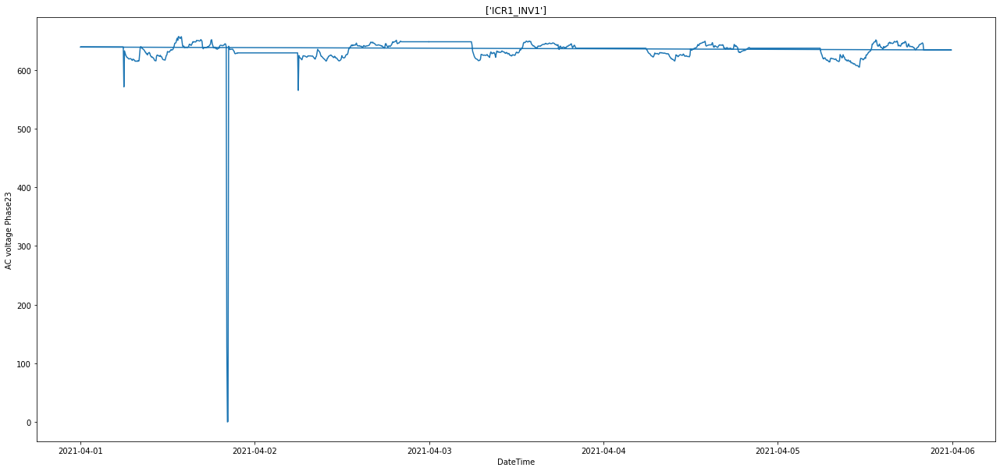

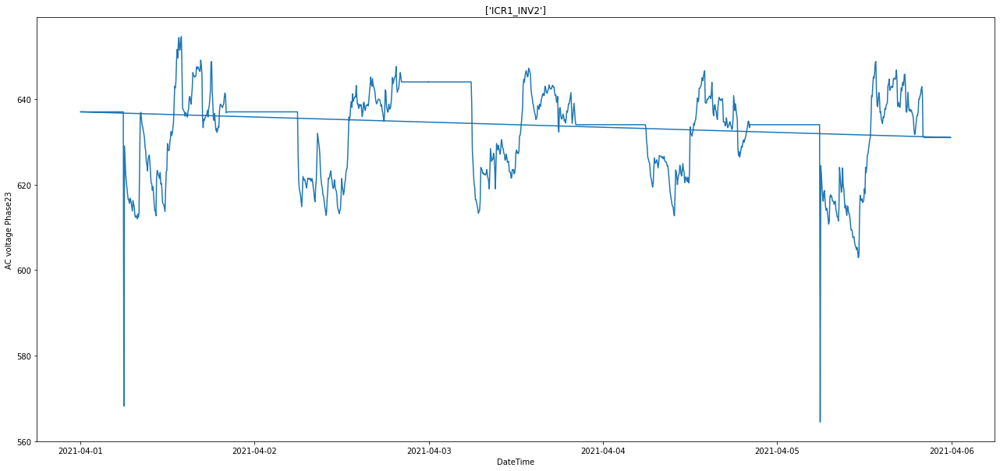

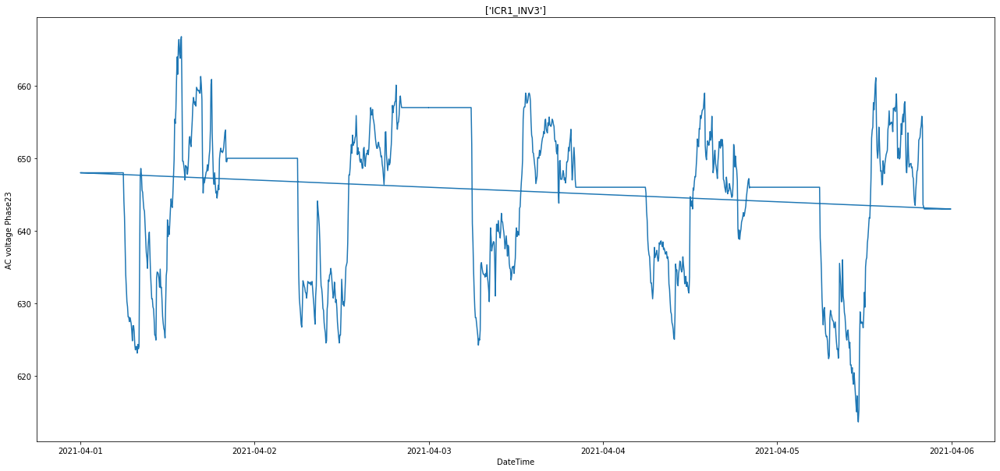

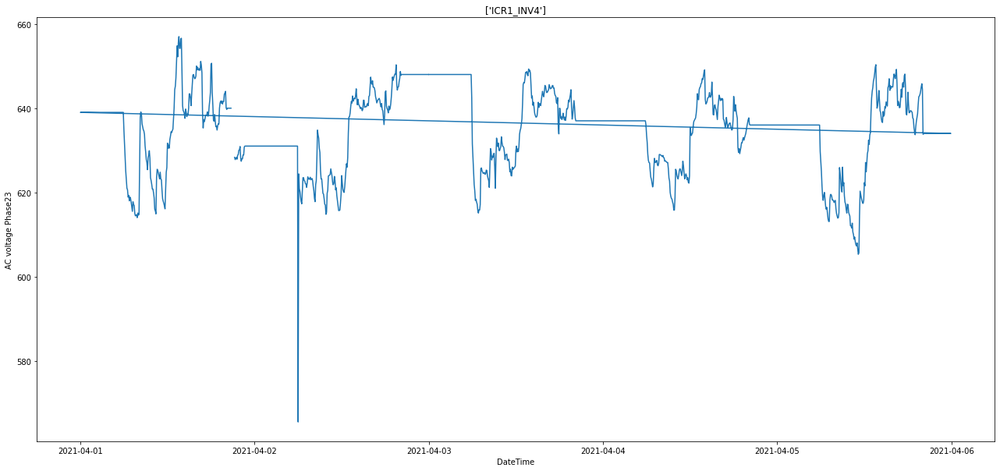

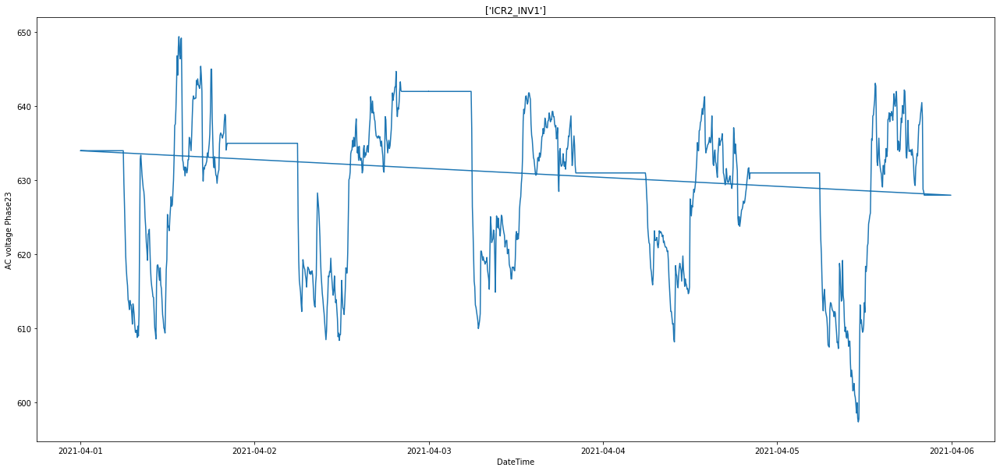

...

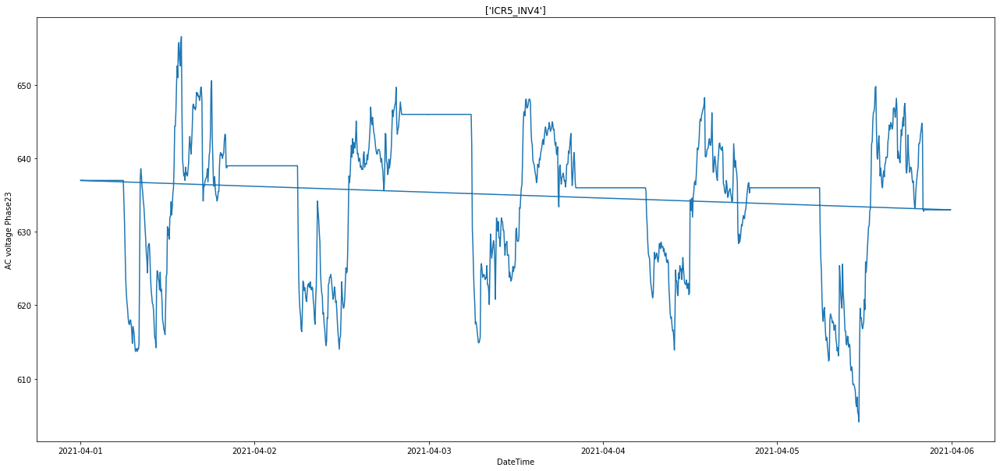

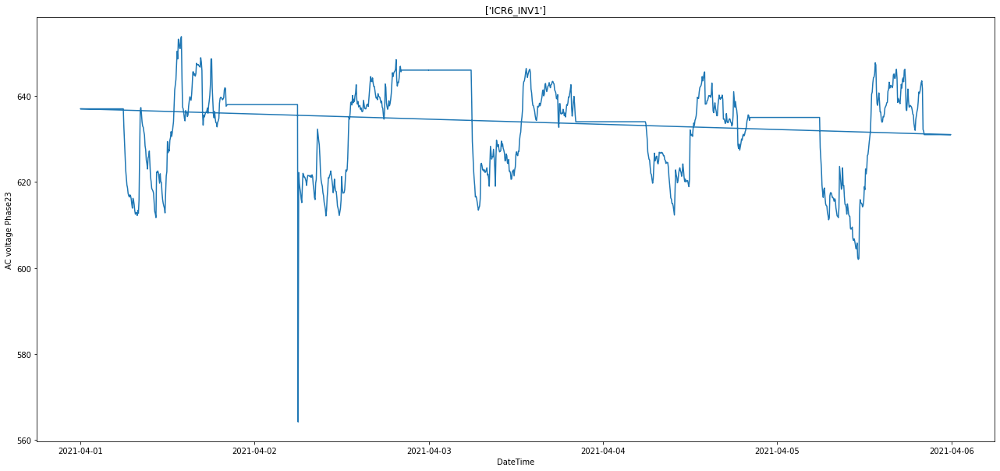

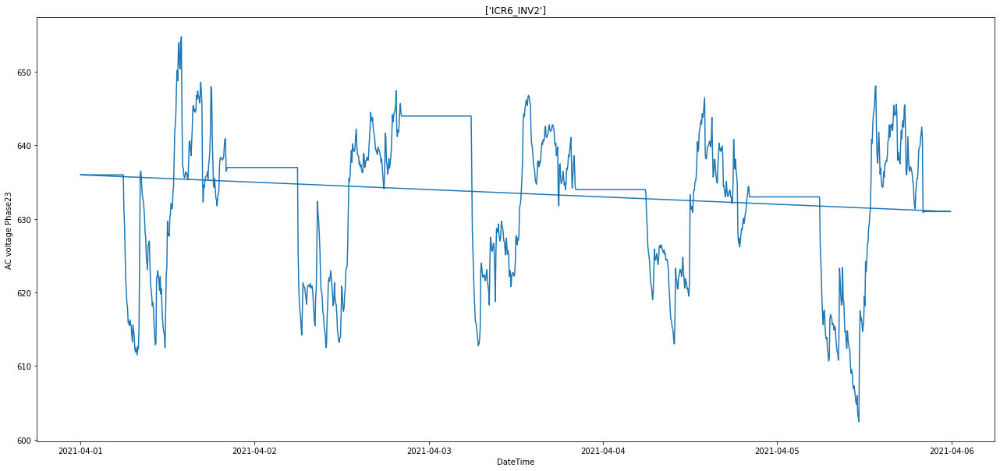

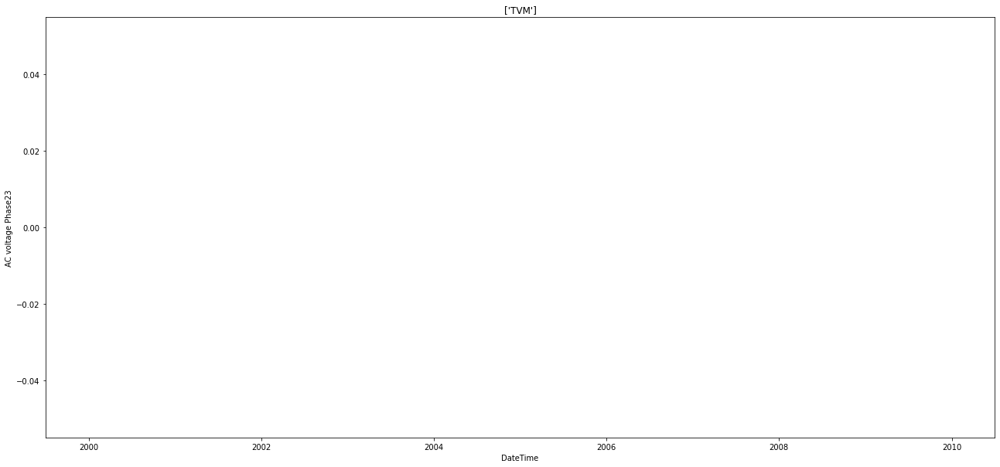

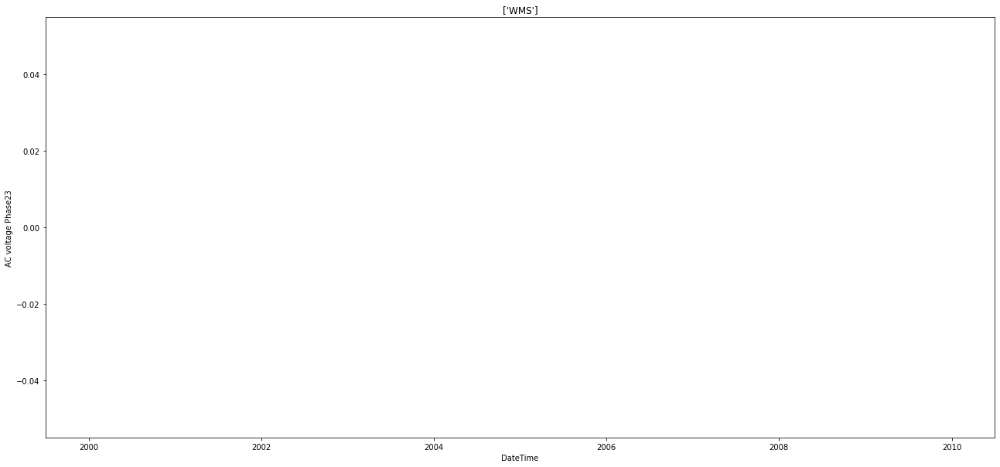

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['AC voltage Phase23'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('AC voltage Phase23')
  plt.show()

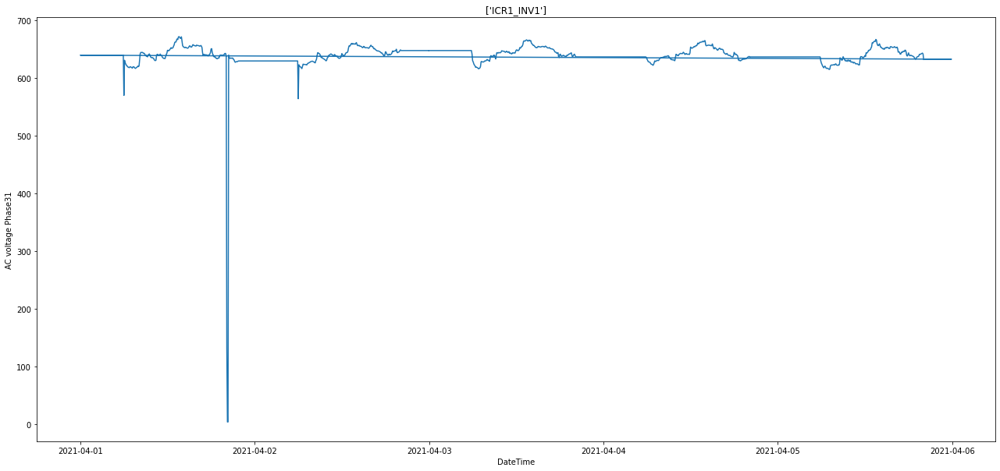

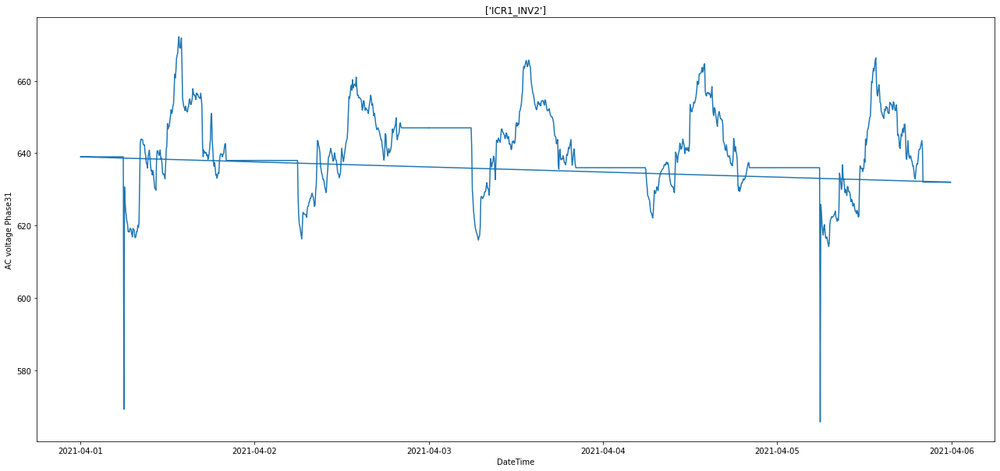

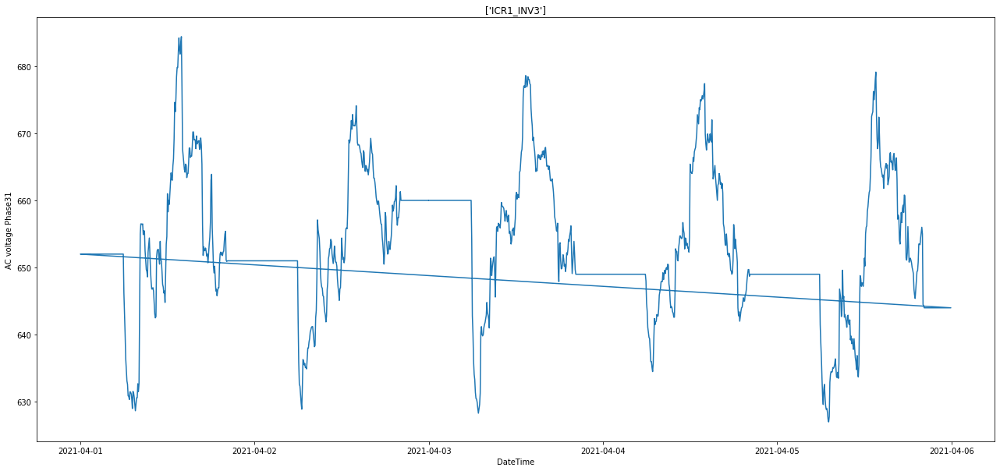

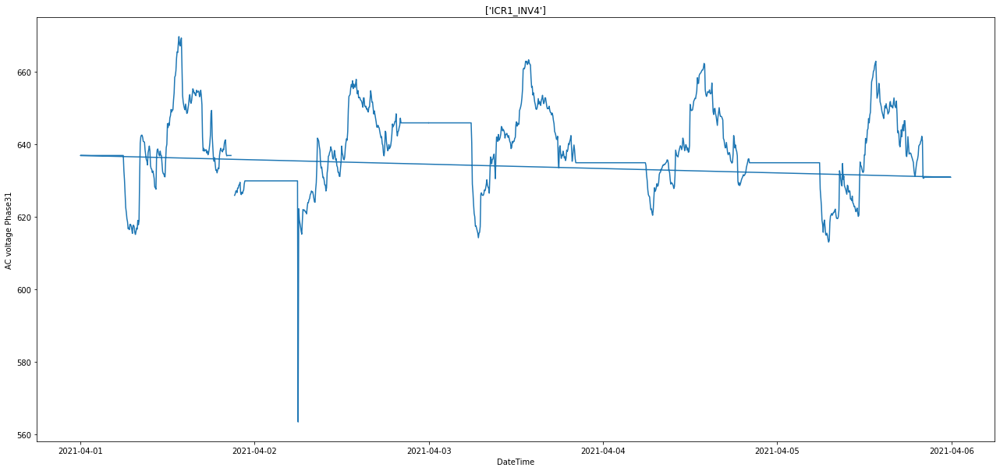

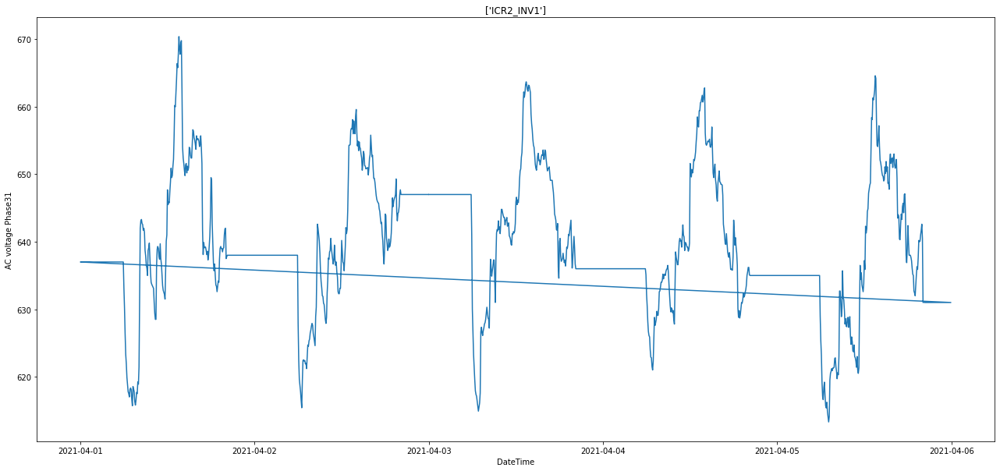

...

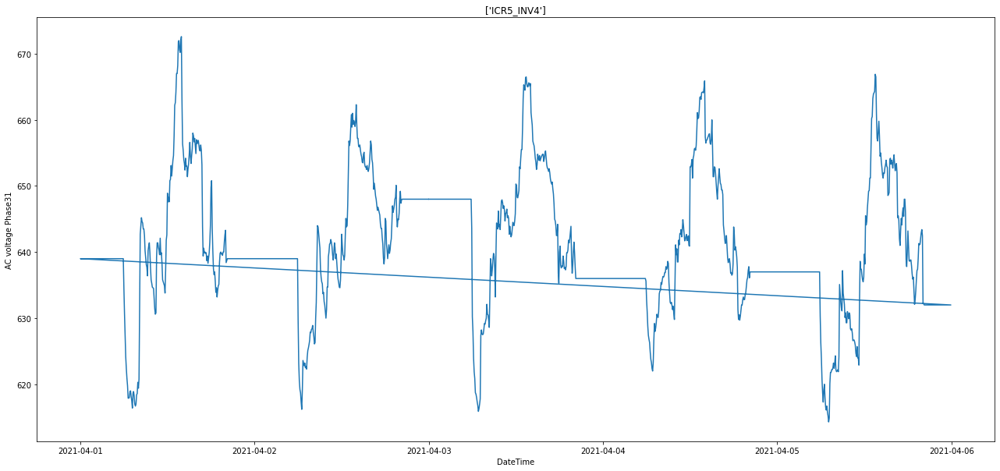

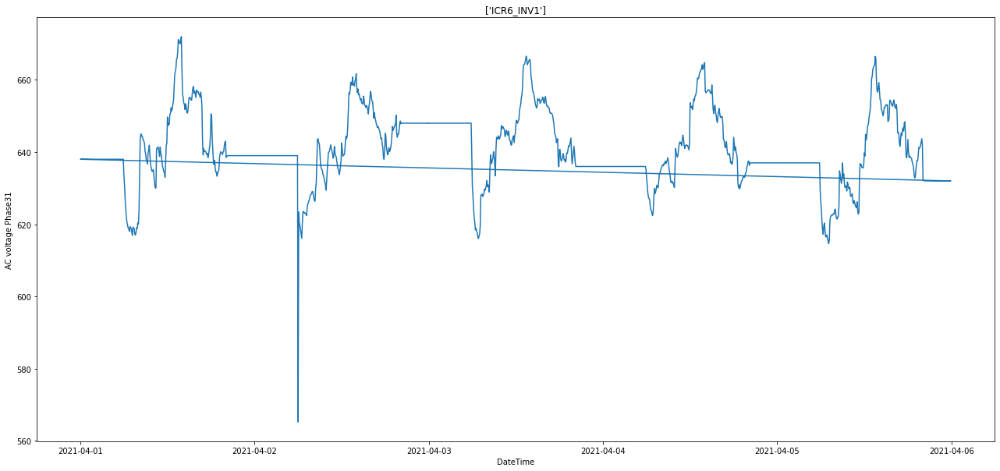

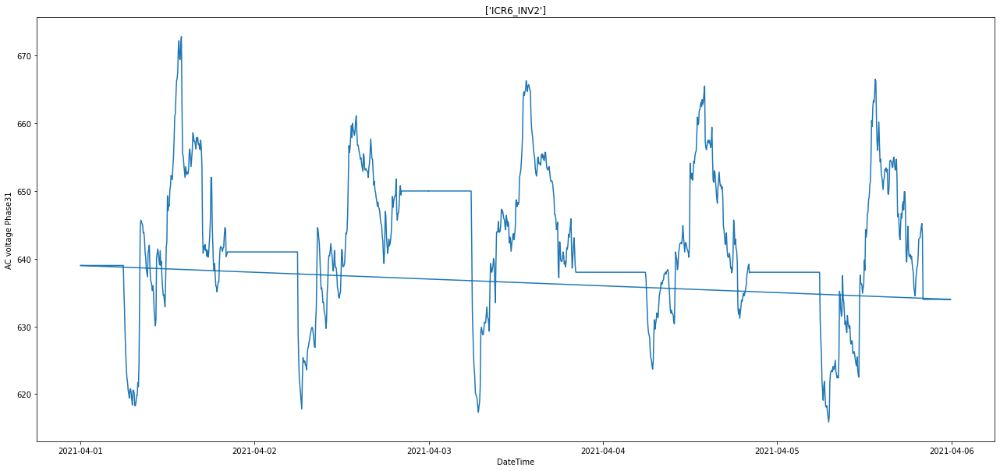

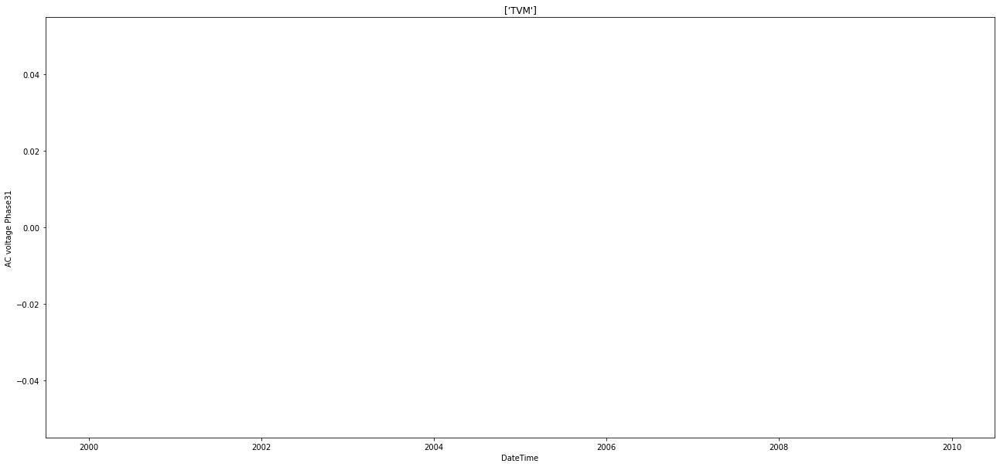

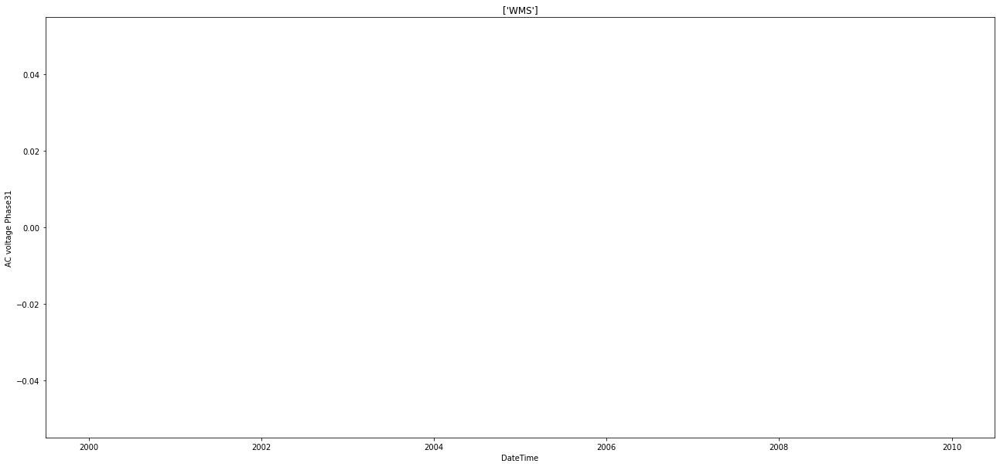

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['AC voltage Phase31'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('AC voltage Phase31')
  plt.show()

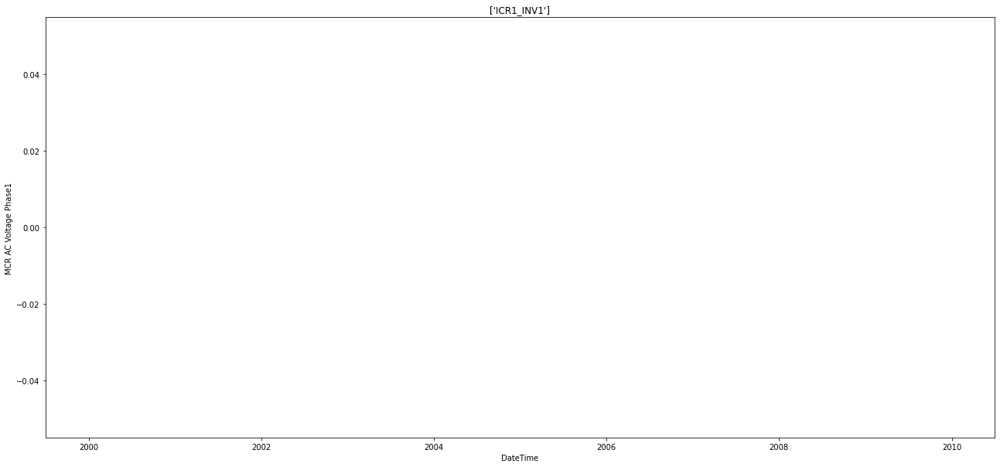

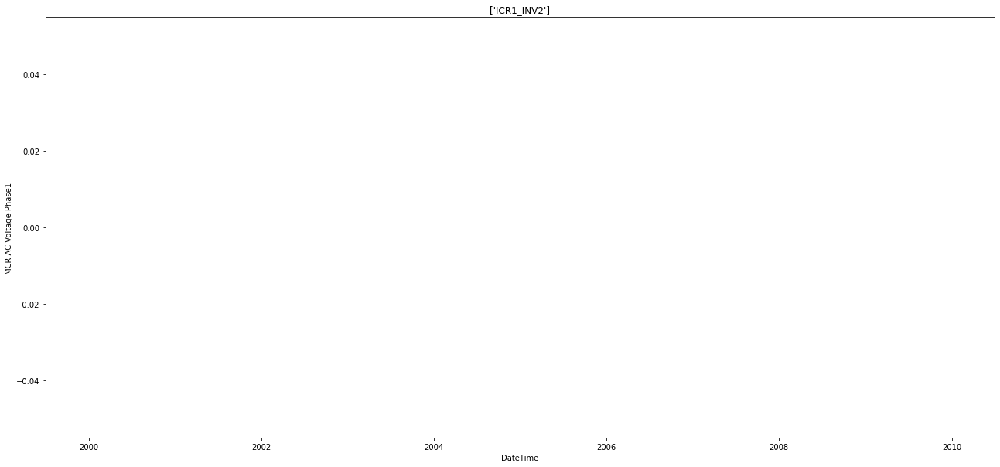

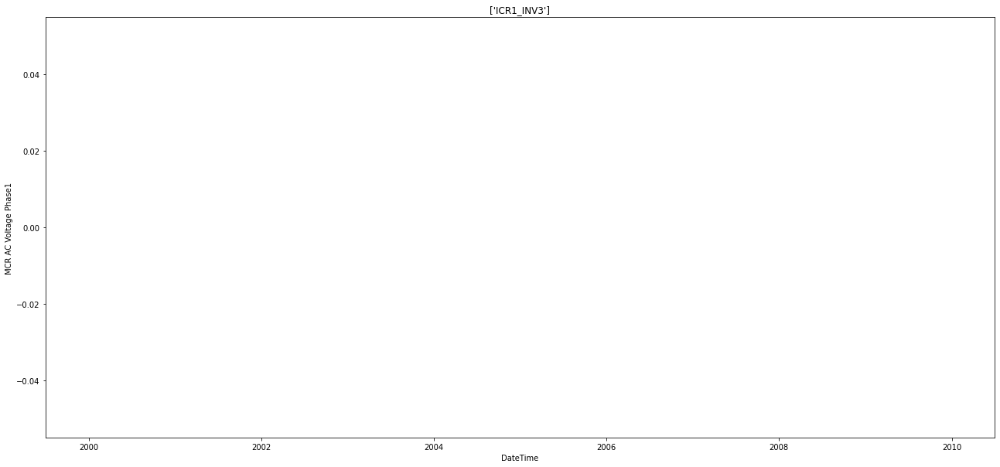

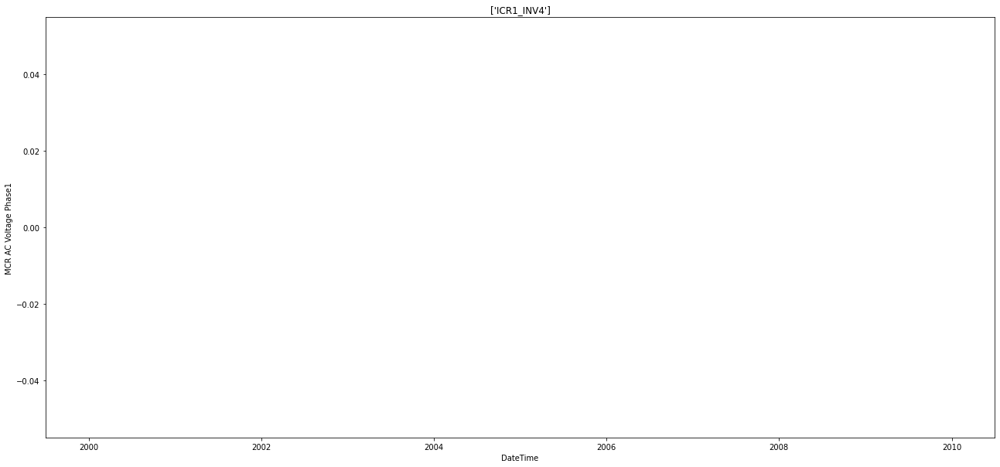

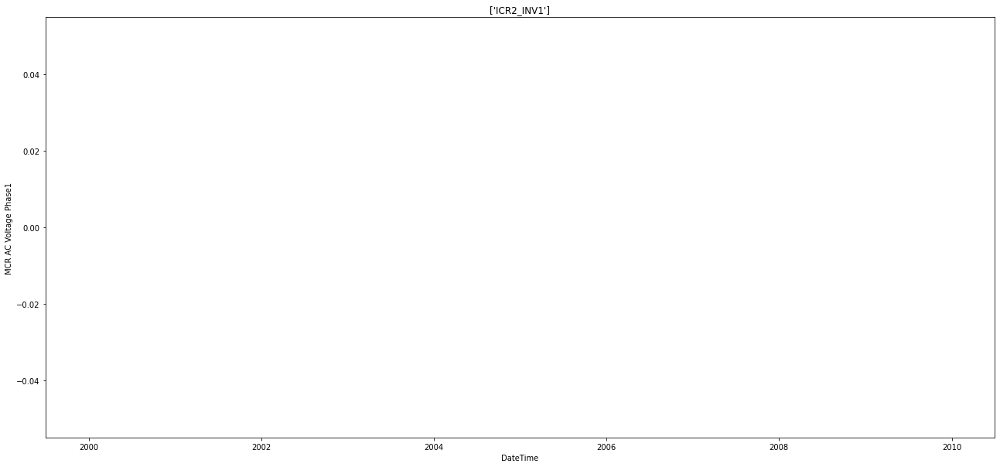

...

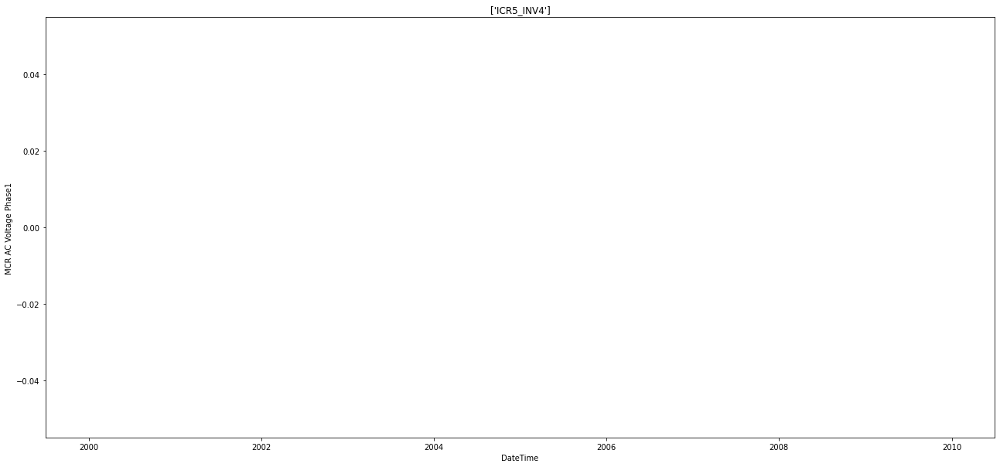

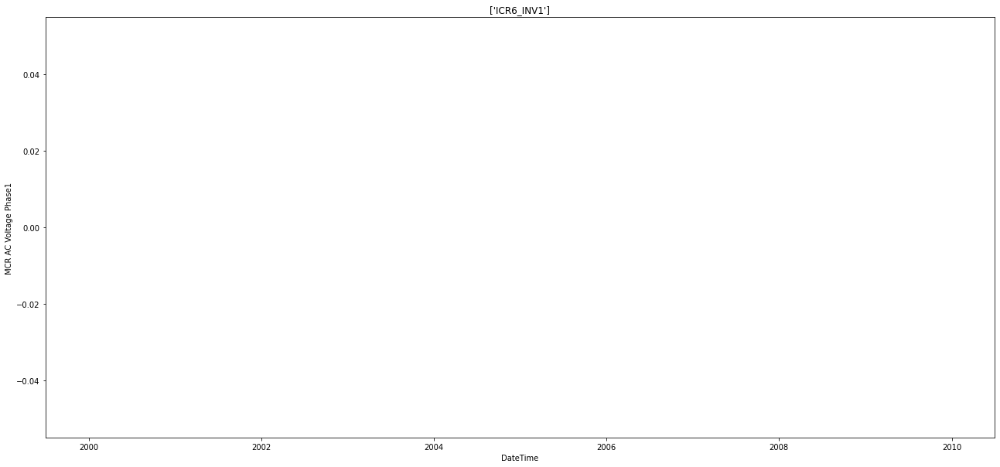

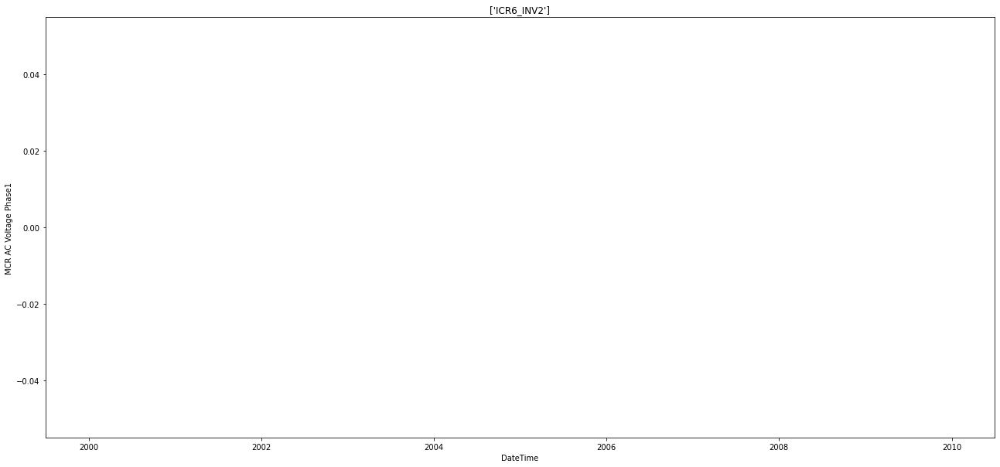

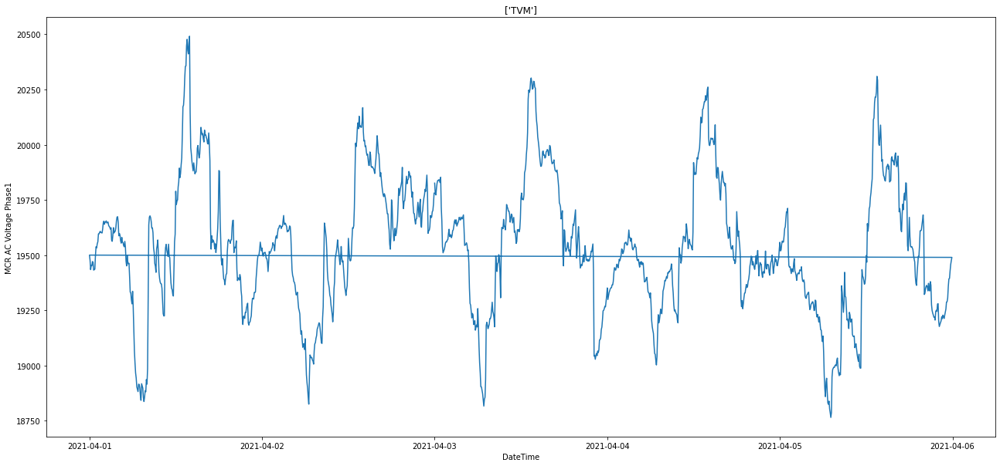

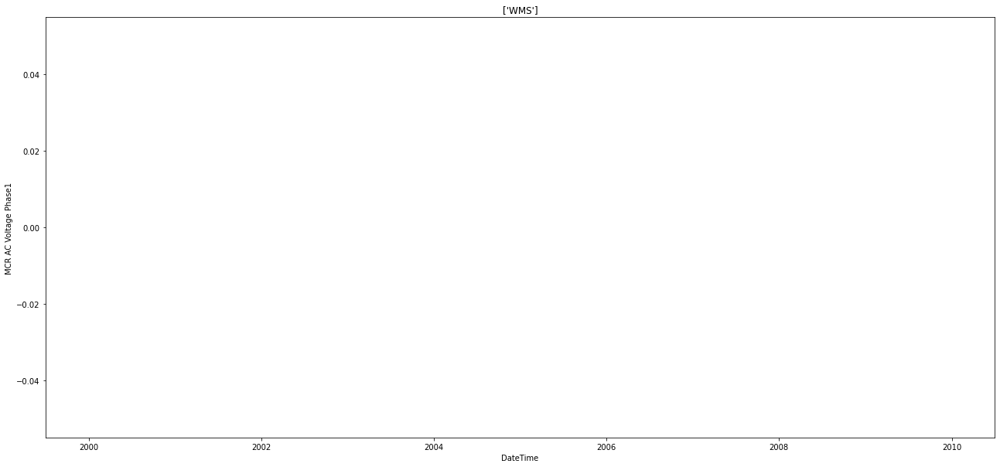

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['MCR AC Voltage Phase1'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('MCR AC Voltage Phase1')
  plt.show()

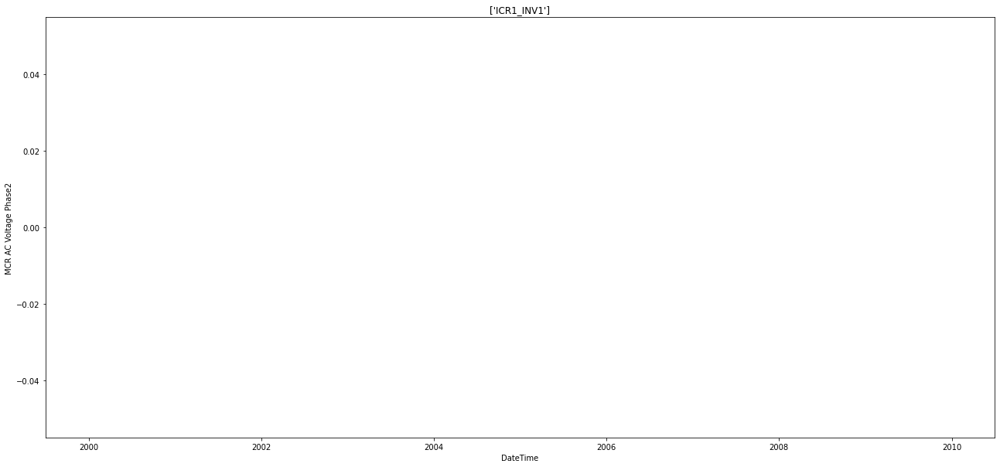

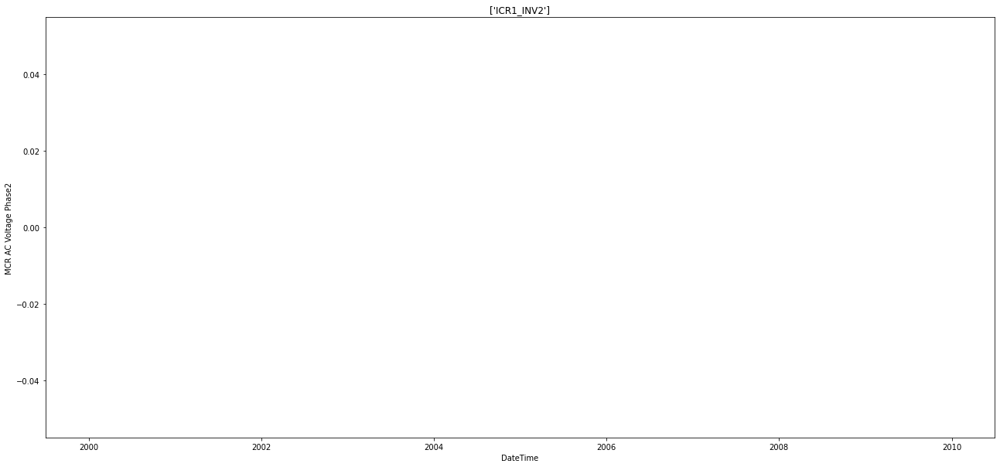

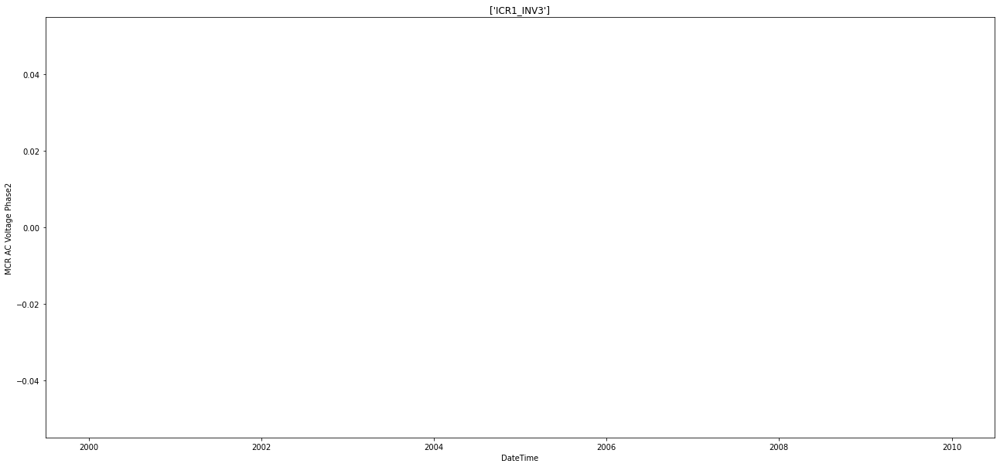

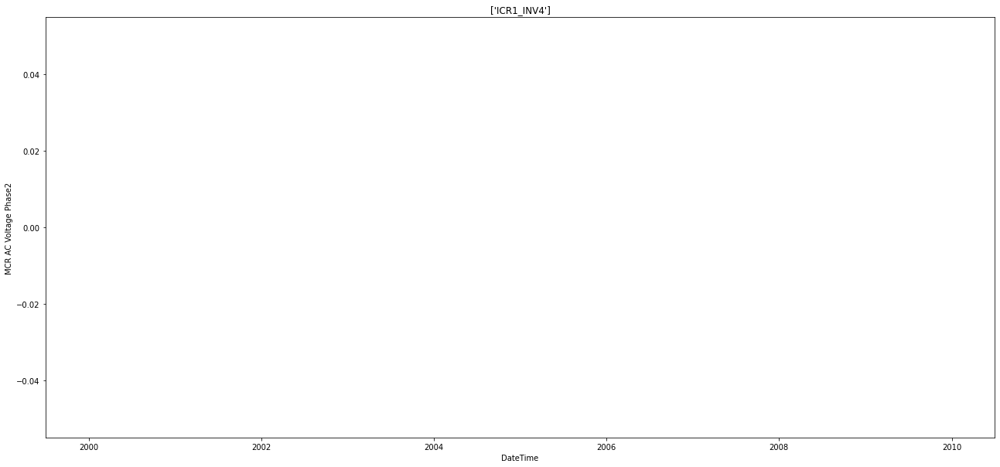

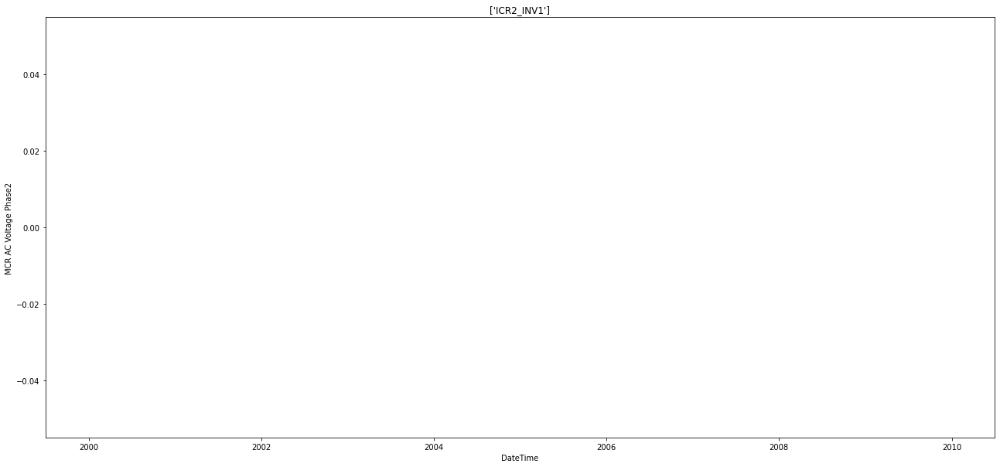

...

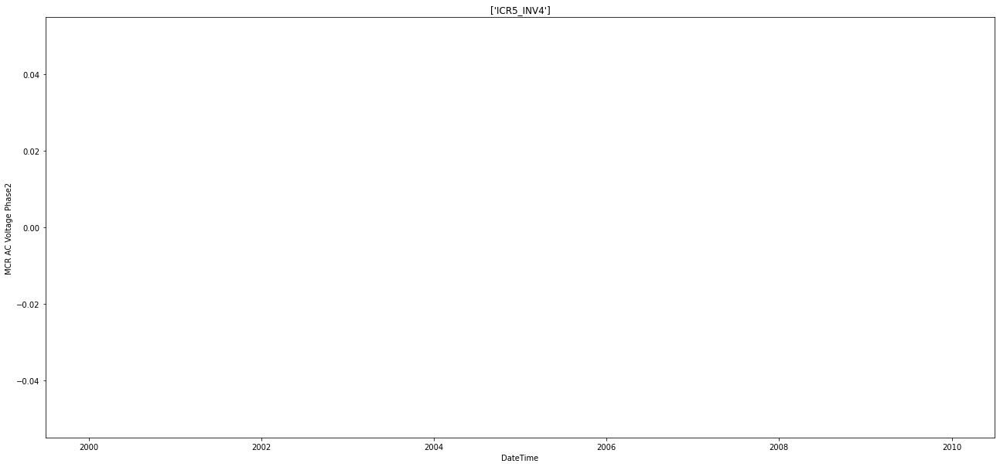

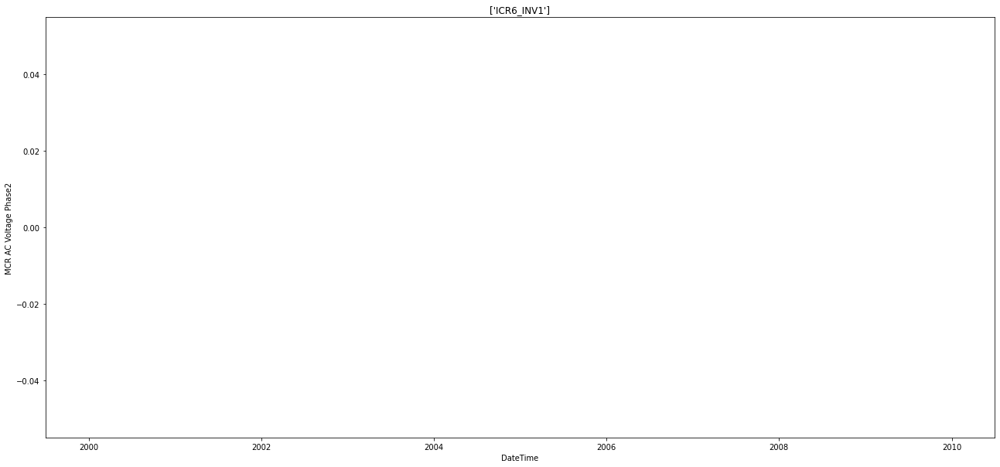

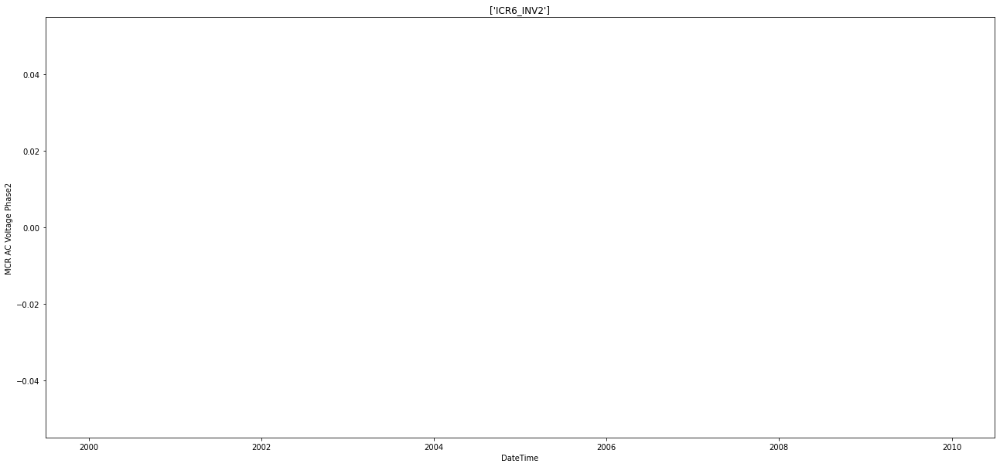

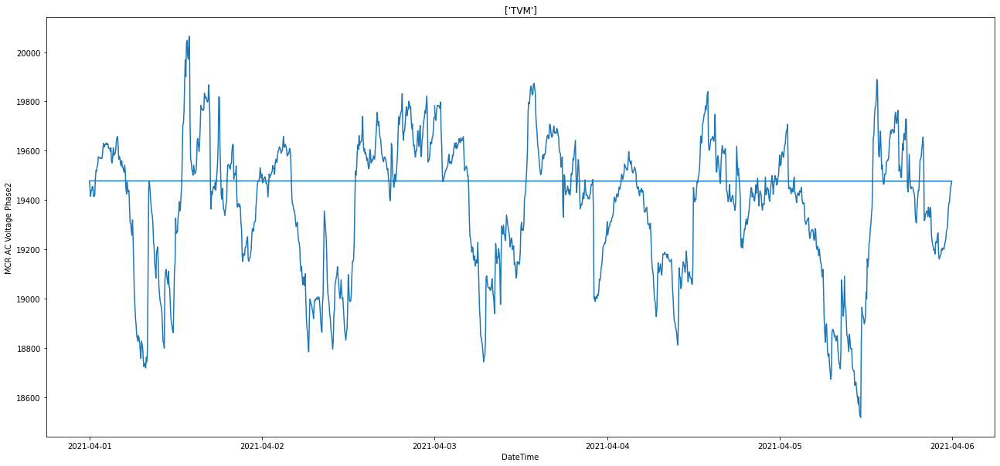

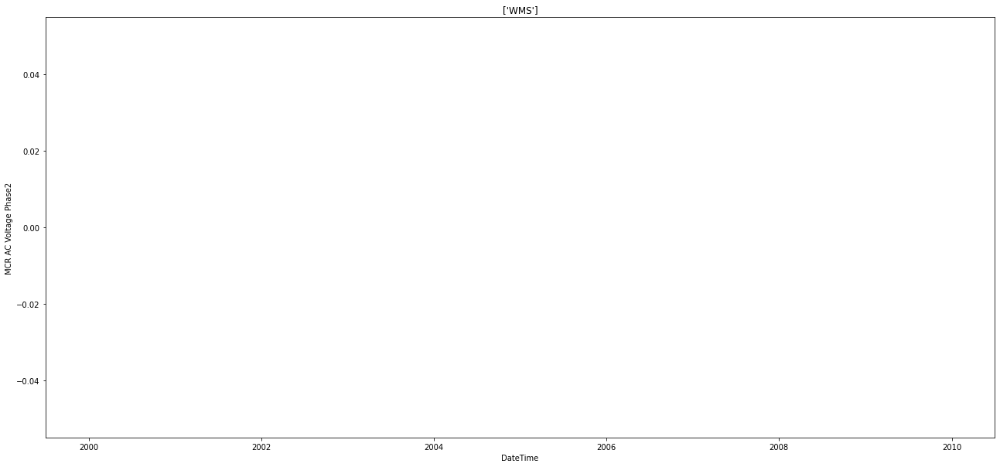

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['MCR AC Voltage Phase2'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('MCR AC Voltage Phase2')
  plt.show()

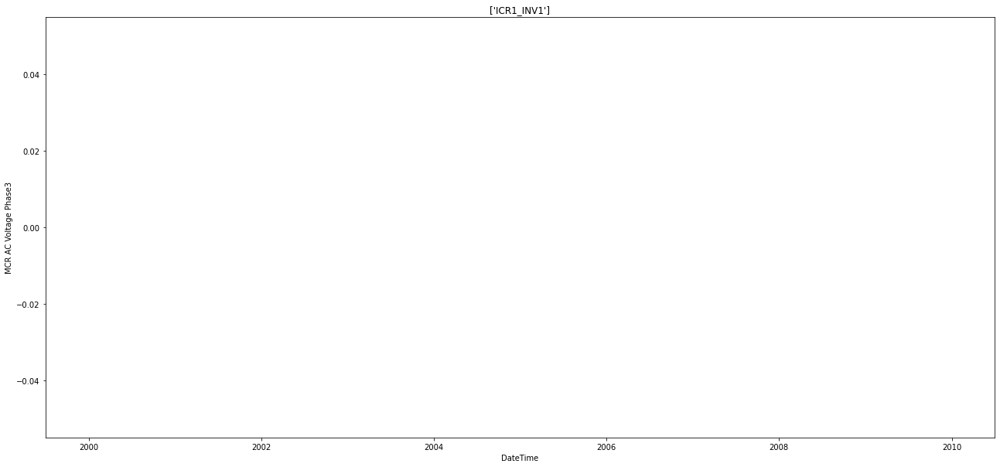

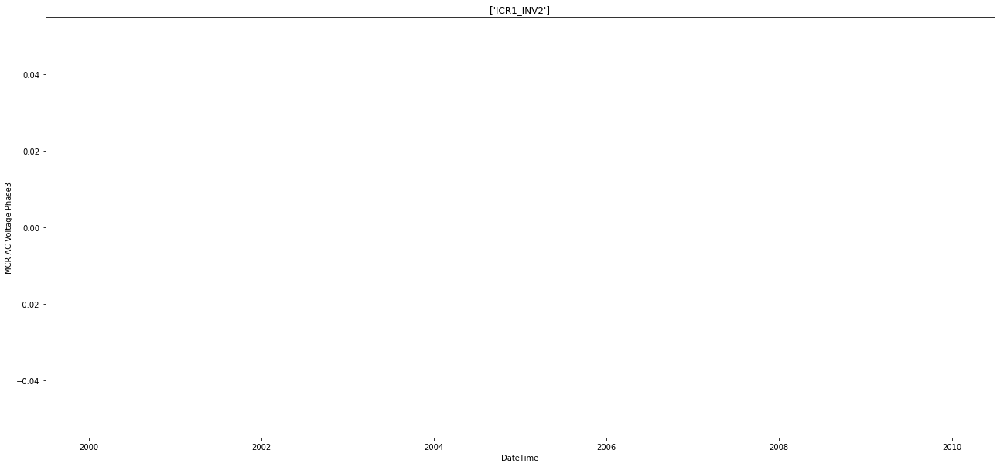

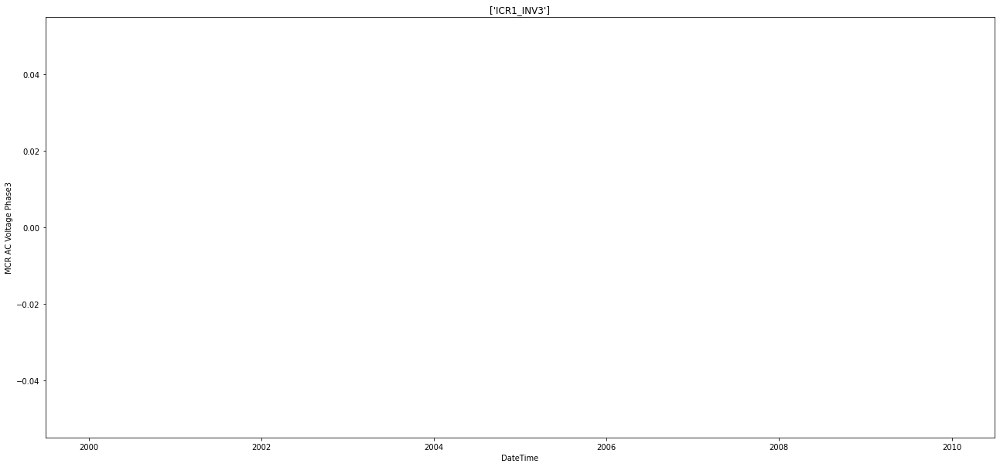

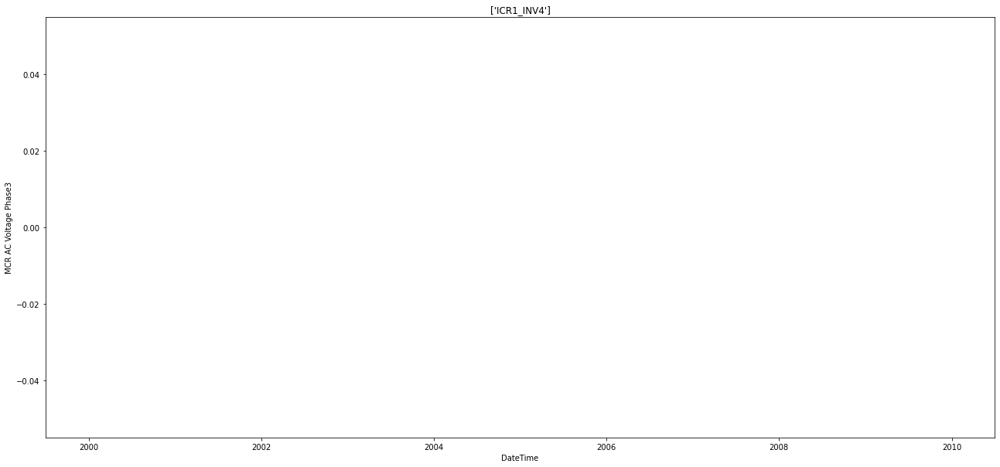

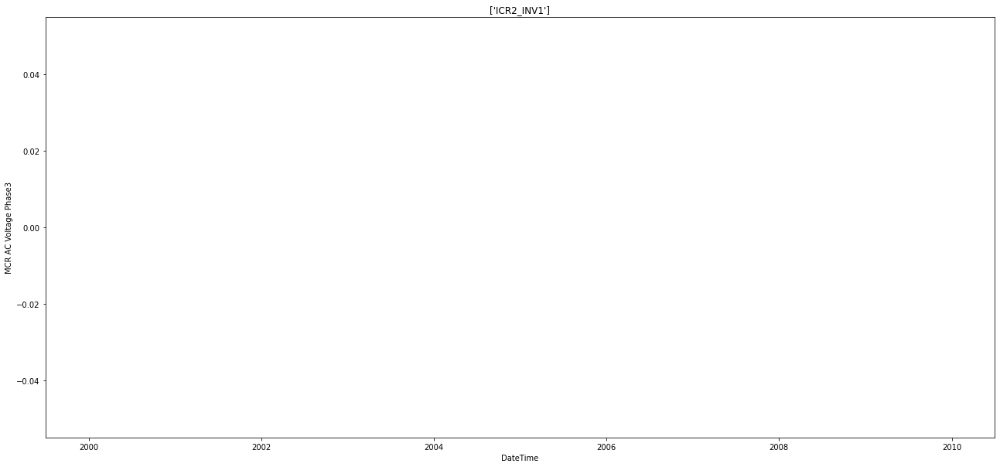

...

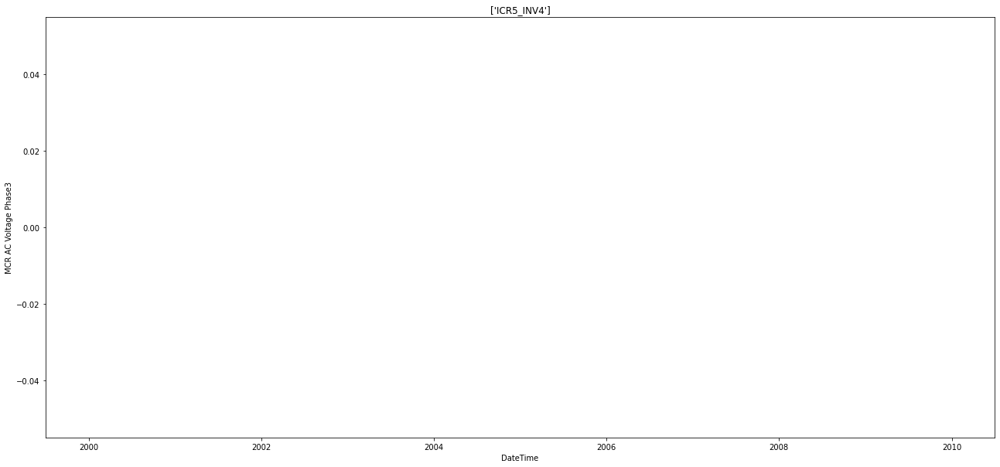

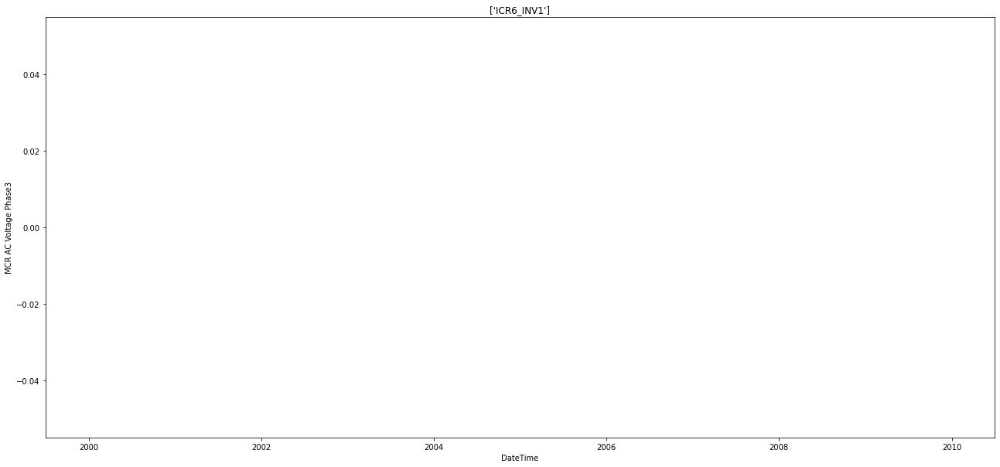

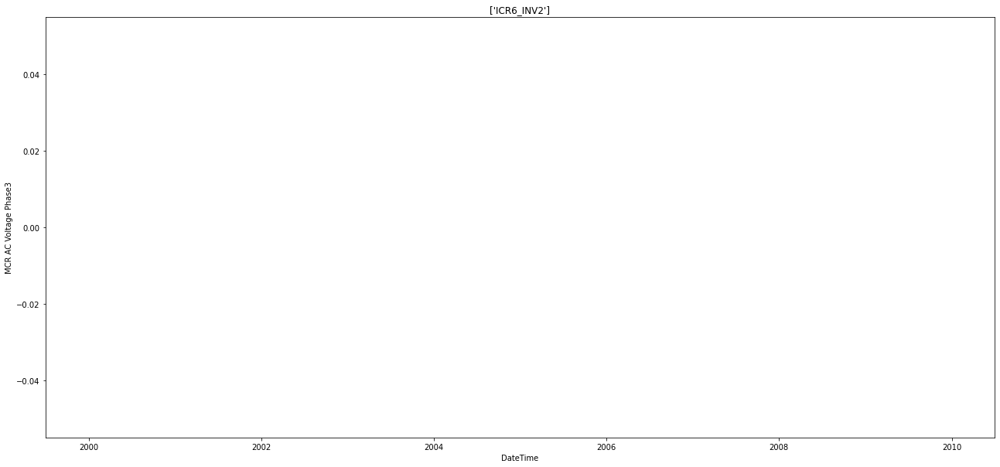

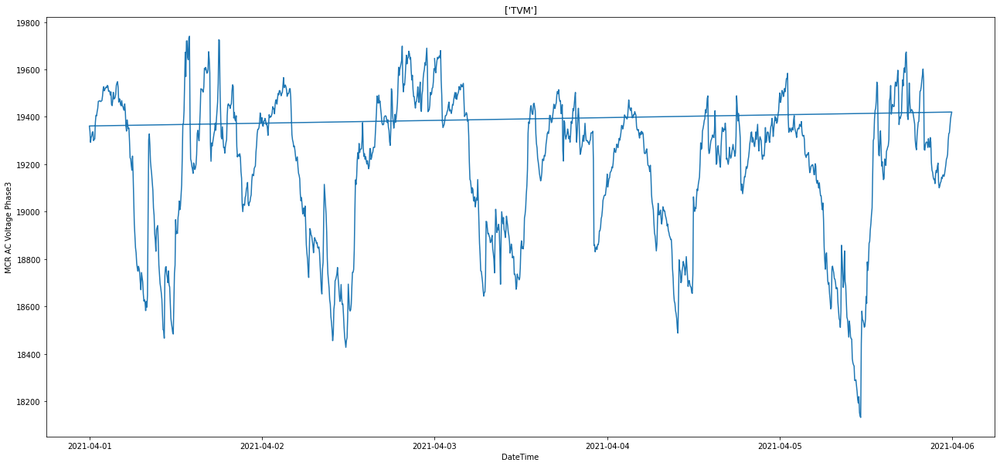

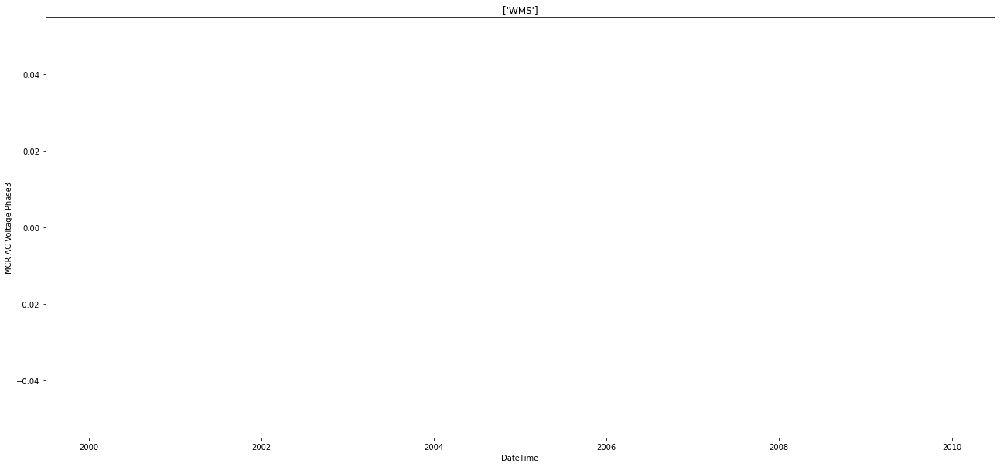

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['MCR AC Voltage Phase3'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('MCR AC Voltage Phase3')
  plt.show()

# Conclusion: DateTime vs Voltage for various AssetNames
Similar to current we can take one of the 22 ICR_INV and one of the 3 phase values and one of the 3 MCR voltage values which is being measured by TVM.

# **Analysis of MCR Export Power vs DateTime for different AssetName**

In [ ]:
df.head()

,Date_Time,AssetName,AC Power,DC Power,AC Current Phase12,AC Current Phase23,AC Current Phase31,AC voltage Phase12,AC voltage Phase23,AC voltage Phase31,MCR Export Power,MCR AC Voltage Phase1,MCR AC Voltage Phase2,MCR AC Voltage Phase3,MCR AC Current Phase1,MCR AC Current Phase2,MCR AC Current Phase3,Ambient Temp,GHI,Module Temp,GTI
20736,2021-04-01,ICR1_INV1,0.0,0.0,1.0,4.0,2.0,643.0,639.0,639.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
26208,2021-04-01,ICR5_INV4,0.0,0.0,1.0,2.0,1.0,640.0,637.0,639.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
21312,2021-04-01,ICR1_INV3,0.0,0.0,2.0,3.0,1.0,654.0,648.0,652.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
24480,2021-04-01,ICR4_INV2,0.0,0.0,1.0,1.0,1.0,644.0,636.0,636.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
22752,2021-04-01,ICR2_INV4,0.0,0.0,2.0,3.0,2.0,642.0,635.0,639.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


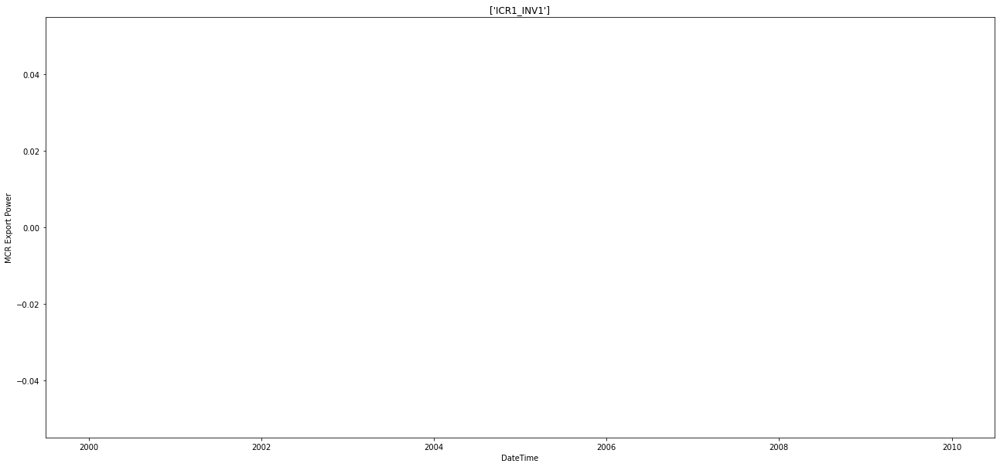

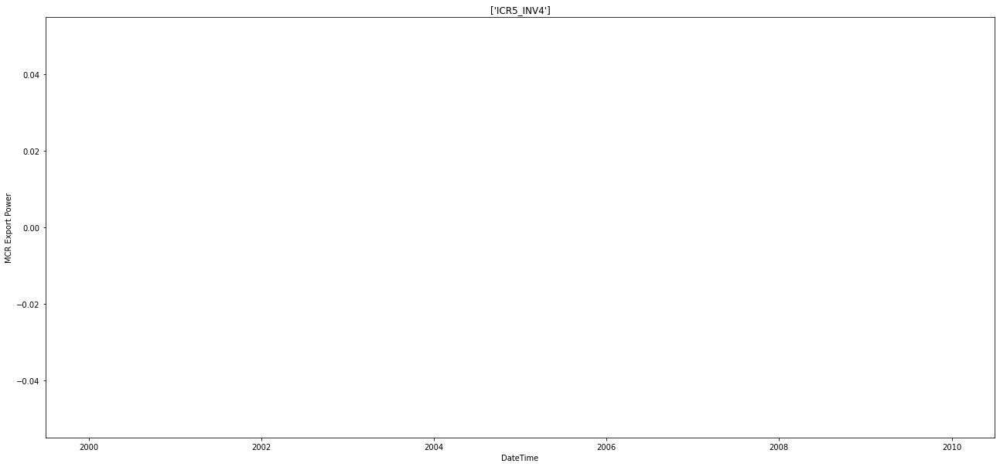

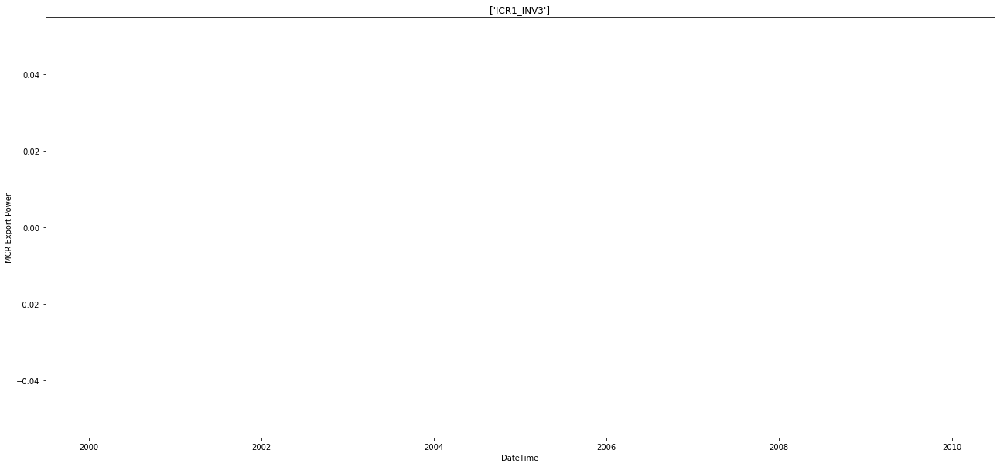

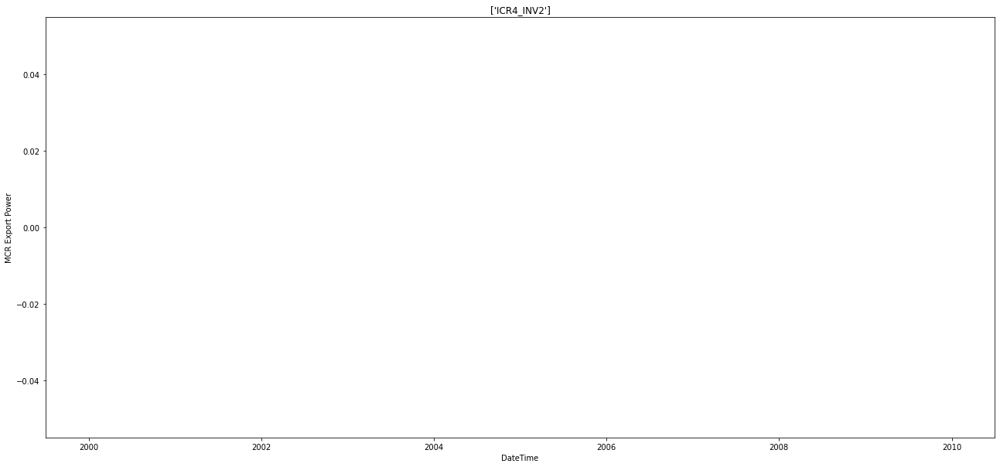

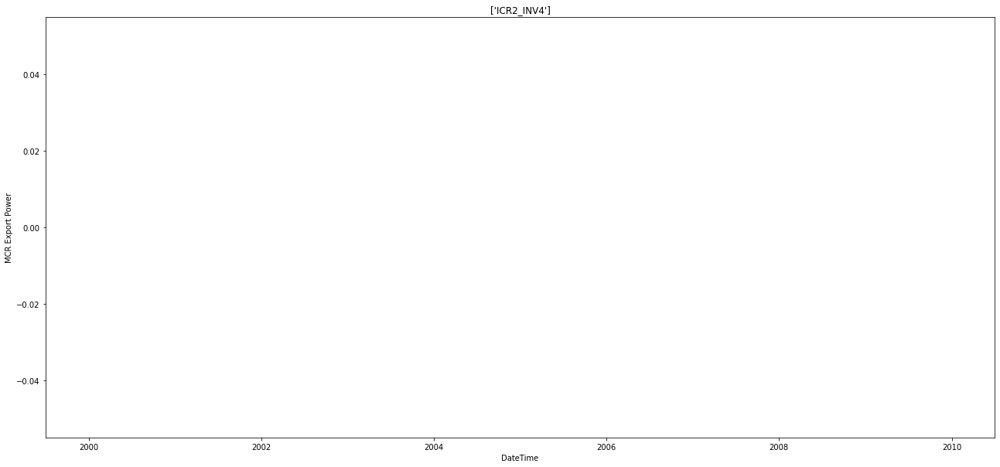

...

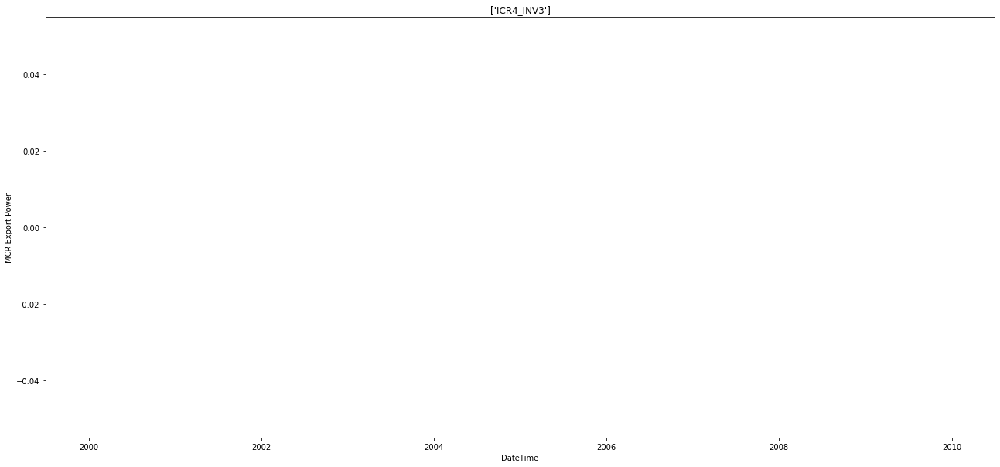

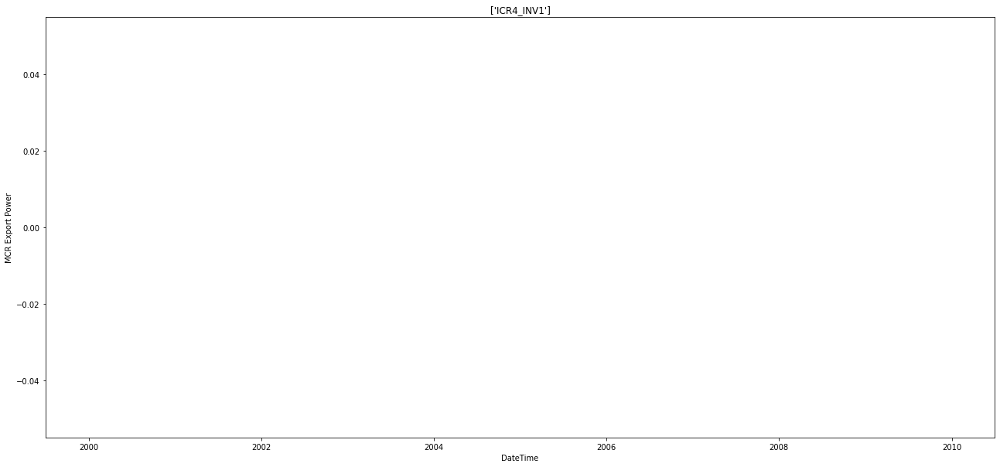

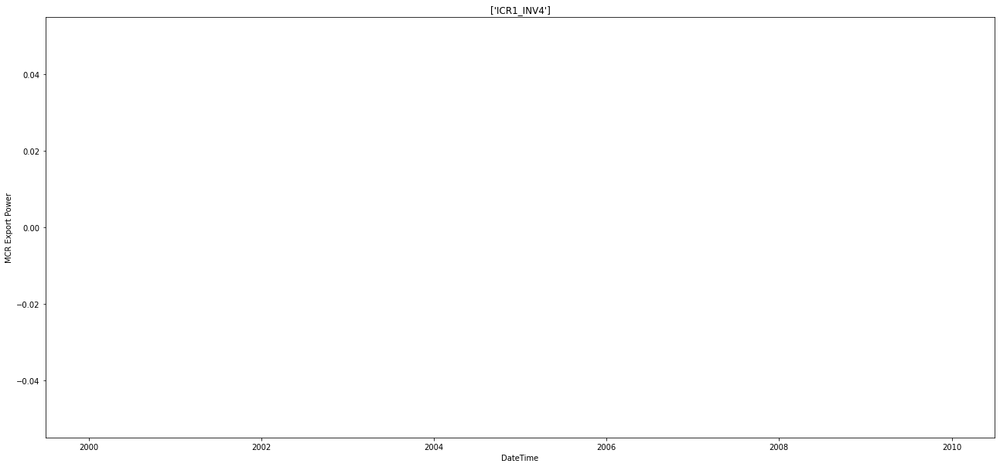

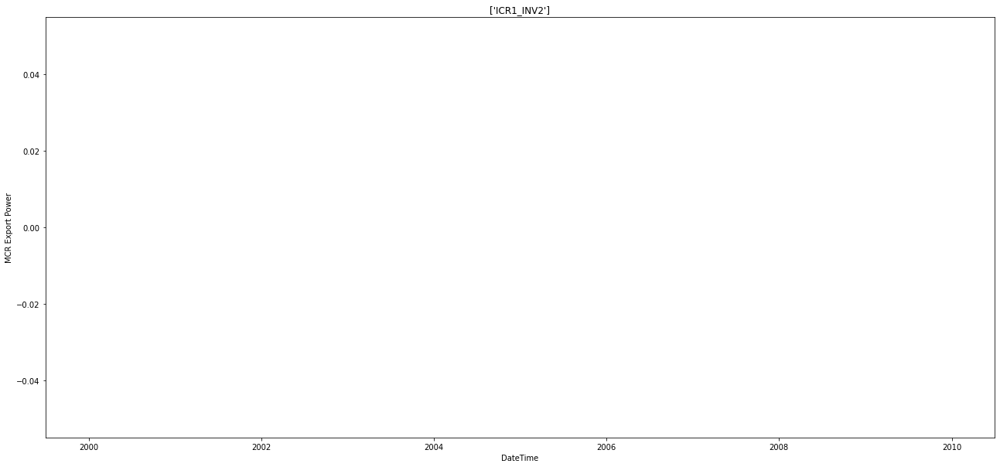

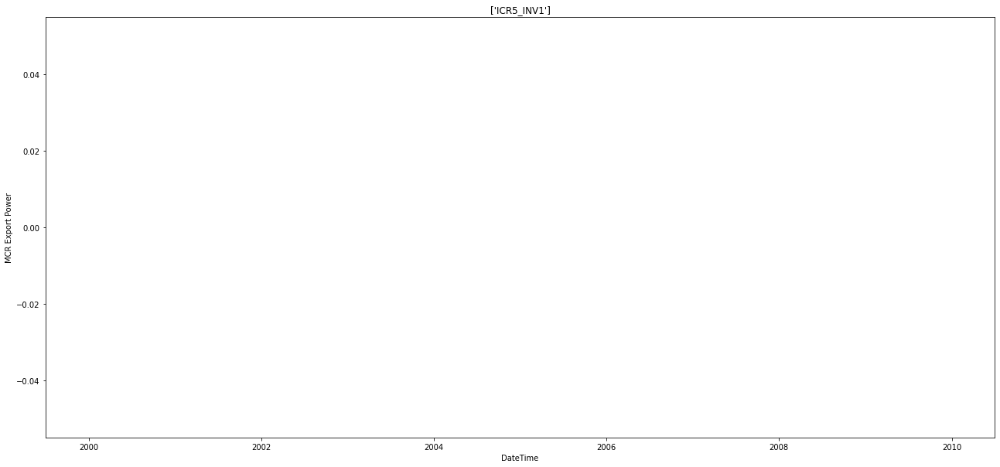

In [ ]:
for asset in assetnames:
  asset = df[df['AssetName'] == asset]
  plt.figure(figsize=(22,10))
  plt.plot(asset['Date_Time'], asset['MCR Export Power'])
  plt.title(asset['AssetName'].unique())
  plt.xlabel('DateTime')
  plt.ylabel('MCR Export Power')
  plt.show()

# Conclusion: MCR Export Power vs DateTime for different AssetName

The AssetName TVM captures the MCR Export Power, we won't be using it as output or input either.

# **We'll create a new df with the features and columns in the way we want - PREPROCESSING**
The first step is to remove the 22 ICR_INV values with a single value and keep the TVM and WMS values. We'll also need to mean the different phase values. So we'll have the columns DateTime, AssetName(ICR_INV, WMS, TVM), DC Power(avg. of 22 values at each time instance), AC Phase values, MCR values, Amb Temp, Mod temp, GHI, GTI. 

In [ ]:
datetime = df['Date_Time'].unique()
datetime.sort()
datetime

array(['2021-02-16T00:00:00.000000000', '2021-02-16T00:05:00.000000000',
       '2021-02-16T00:10:00.000000000', ...,
       '2021-08-21T23:45:00.000000000', '2021-08-21T23:50:00.000000000',
       '2021-08-21T23:55:00.000000000'], dtype='datetime64[ns]')

In [ ]:
import numpy as np

dc_power = []
ac_curr_phase1 = []
ac_curr_phase2 = []
ac_curr_phase3 = []
amb_temp = []
ghi = []
mod_temp = []
gti = []
for date in datetime:
  #for asset in assetnames:
  val_dc = df[df['Date_Time'] == date]
  dc_power = np.append(dc_power, val_dc['DC Power'].sum(skipna=True))
  ac_curr_phase1 = np.append(ac_curr_phase1, val_dc['AC Current Phase12'].sum(skipna=True))
  ac_curr_phase2 = np.append(ac_curr_phase2, val_dc['AC Current Phase23'].sum(skipna=True))
  ac_curr_phase3 = np.append(ac_curr_phase3, val_dc['AC Current Phase31'].sum(skipna=True))
  amb_temp = np.append(amb_temp, val_dc['Ambient Temp'].sum(skipna=True))
  ghi = np.append(ghi, val_dc['GHI'].sum(skipna=True))
  mod_temp = np.append(mod_temp, val_dc['Module Temp'].sum(skipna=True))
  gti = np.append(gti, val_dc['GTI'].sum(skipna=True))
  
dc_power = dc_power
ac_curr_phase1 = ac_curr_phase1/22
ac_curr_phase2 = ac_curr_phase2/22
ac_curr_phase3 = ac_curr_phase3/22

In [ ]:
df_new = pd.DataFrame(datetime)
df_new['DateTime'] = pd.DataFrame(datetime)
df_new['Hour'] = df_new['DateTime'].dt.hour
df_new['Ambient Temp'] = pd.DataFrame(amb_temp)
df_new['Module Temp'] = pd.DataFrame(mod_temp)
df_new['GHI'] = pd.DataFrame(ghi)
df_new['GTI'] = pd.DataFrame(gti)
df_new['DC Power'] = pd.DataFrame(dc_power)
df_new.drop(df_new.columns[[0]], axis=1,inplace=True)
df_new.sort_values(by='DateTime')
df_new

,DateTime,Hour,Ambient Temp,Module Temp,GHI,GTI,DC Power
0,2021-02-16 00:00:00,0,22.94995,21.33753,0.0,0.0,0.0
1,2021-02-16 00:05:00,0,22.31500,21.14517,0.0,0.0,0.0
2,2021-02-16 00:10:00,0,22.08755,20.96527,0.0,0.0,0.0
3,2021-02-16 00:15:00,0,22.21661,20.83107,0.0,0.0,0.0
4,2021-02-16 00:20:00,0,22.20626,20.66763,0.0,0.0,0.0
...,...,...,...,...,...,...,...
42619,2021-08-21 23:35:00,23,23.69089,23.76144,0.0,0.0,0.0
42620,2021-08-21 23:40:00,23,23.66865,23.73989,0.0,0.0,0.0
42621,2021-08-21 23:45:00,23,23.64114,23.70236,0.0,0.0,0.0
42622,2021-08-21 23:50:00,23,23.62848,23.65339,0.0,0.0,0.0


In [ ]:
df_new.to_csv (r'\export_dataframe.csv', index = False, header=True)

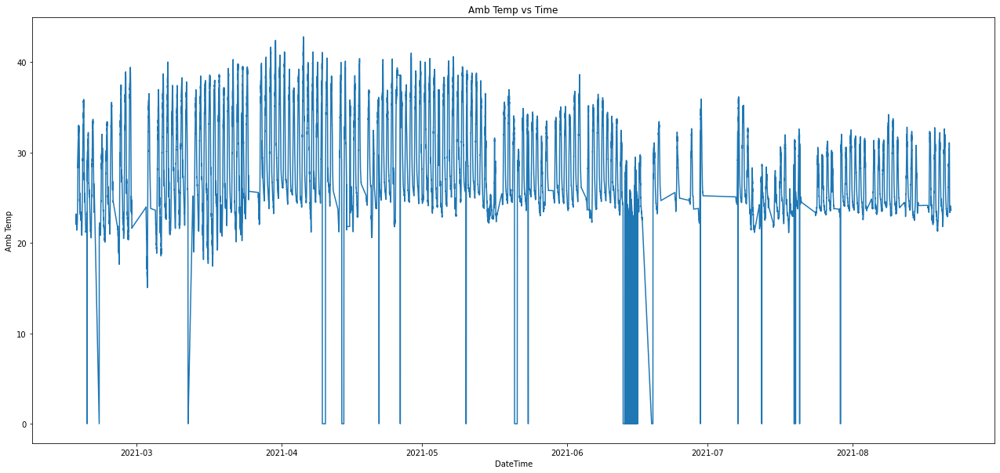

In [ ]:
plt.figure(figsize=(22,10))
plt.plot(df_new['DateTime'], df_new['Ambient Temp'])
plt.title('Amb Temp vs Time')
plt.xlabel('DateTime')
plt.ylabel('Amb Temp')
plt.show()

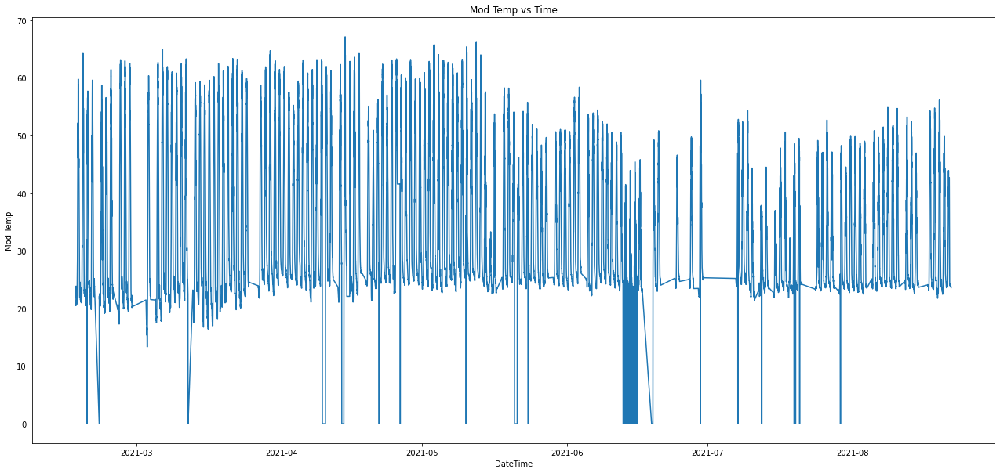

In [ ]:
plt.figure(figsize=(22,10))
plt.plot(df_new['DateTime'], df_new['Module Temp'])
plt.title('Mod Temp vs Time')
plt.xlabel('DateTime')
plt.ylabel('Mod Temp')
plt.show()

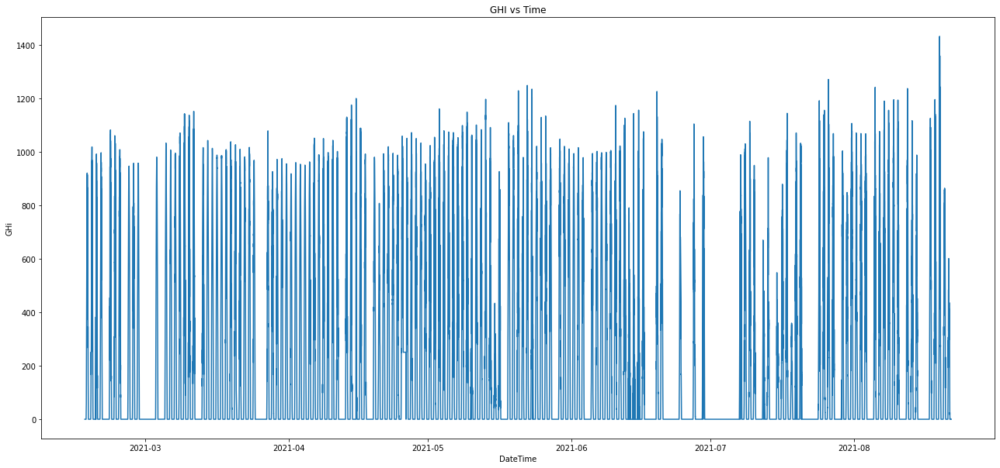

In [ ]:
plt.figure(figsize=(22,10))
plt.plot(df_new['DateTime'], df_new['GHI'])
plt.title('GHI vs Time')
plt.xlabel('DateTime')
plt.ylabel('GHi')
plt.show()

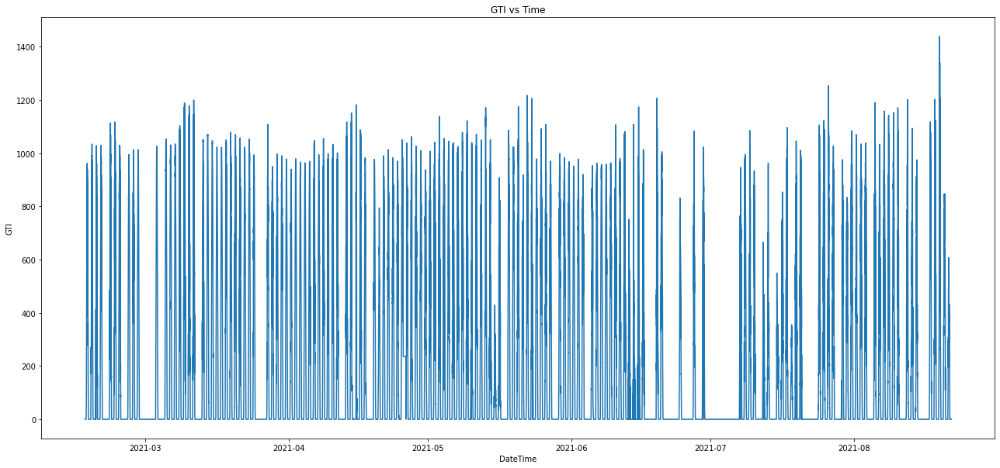

In [ ]:
plt.figure(figsize=(22,10))
plt.plot(df_new['DateTime'], df_new['GTI'])
plt.title('GTI vs Time')
plt.xlabel('DateTime')
plt.ylabel('GTI')
plt.show()

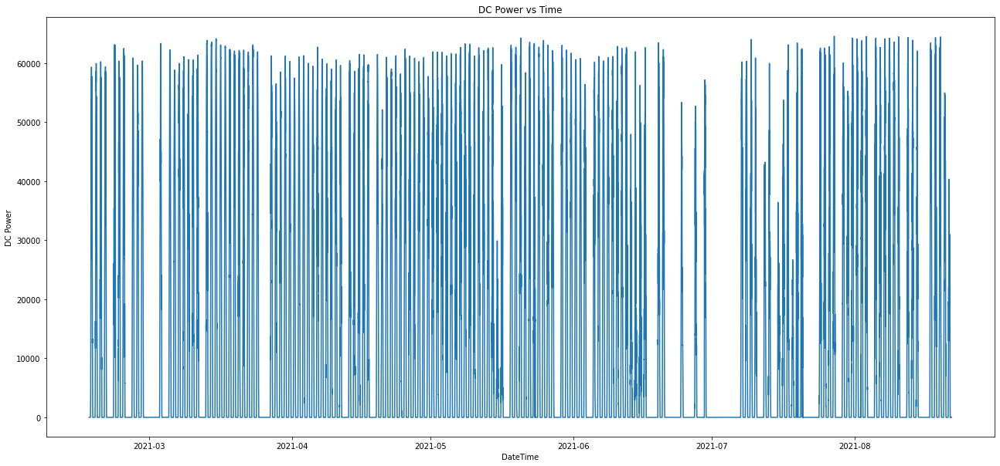

In [ ]:
plt.figure(figsize=(22,10))
plt.plot(df_new['DateTime'], df_new['DC Power'])
plt.title('DC Power vs Time')
plt.xlabel('DateTime')
plt.ylabel('DC Power')
plt.show()

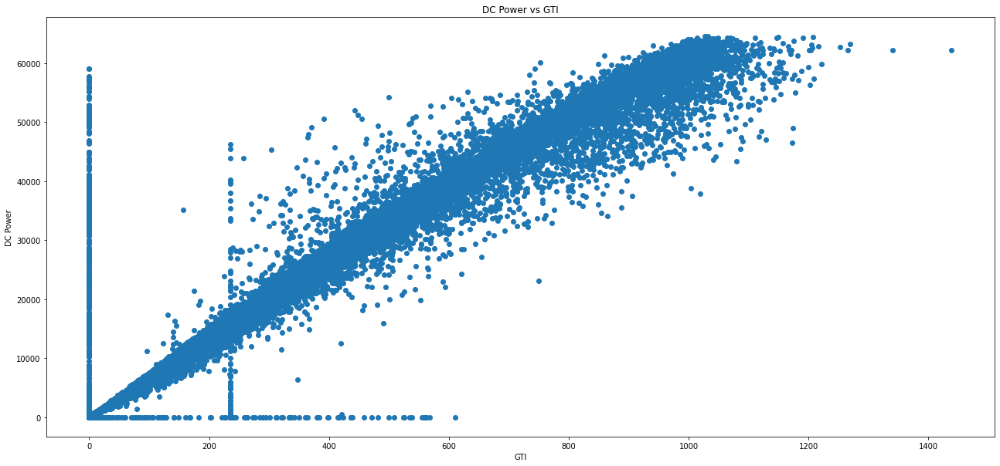

In [ ]:
plt.figure(figsize=(22,10))
plt.scatter(df_new['GTI'], df_new['DC Power'])
plt.title('DC Power vs GTI')
plt.xlabel('GTI')
plt.ylabel('DC Power')
plt.show()

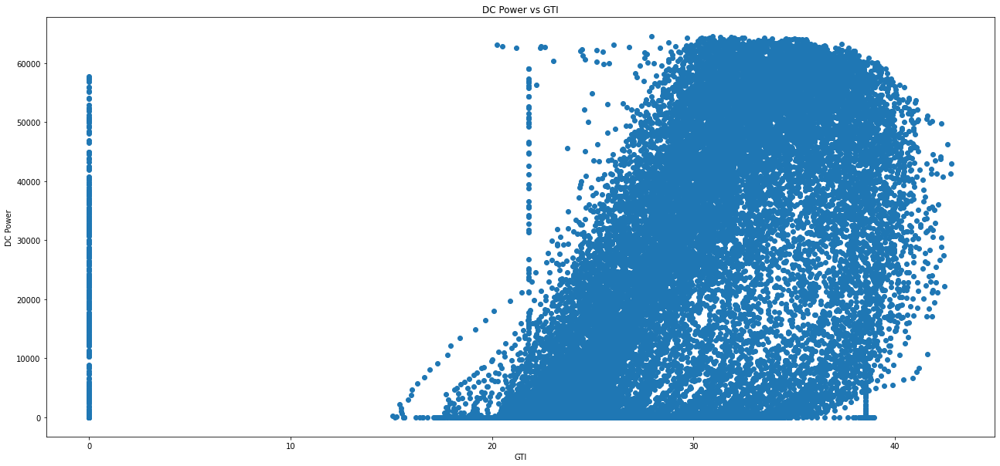

In [ ]:
plt.figure(figsize=(22,10))
plt.scatter(df_new['Ambient Temp'], df_new['DC Power'])
plt.title('DC Power vs GTI')
plt.xlabel('GTI')
plt.ylabel('DC Power')
plt.show()

In [ ]:
#counting datapoints for each day
daily_datapoint_count = df_new.groupby(by = df_new['DateTime'].dt.date).count()
print(daily_datapoint_count[daily_datapoint_count['DateTime']<288])

Empty DataFrame
Columns: [DateTime, Hour, Ambient Temp, Module Temp, GHI, GTI, DC Power]
Index: []


# **Frequency Domain Analysis**
We'll work with df_new and look at the frequency domain decomposition for the same.

In [ ]:
import scipy as sp
import scipy.fftpack
import matplotlib.pyplot as plt

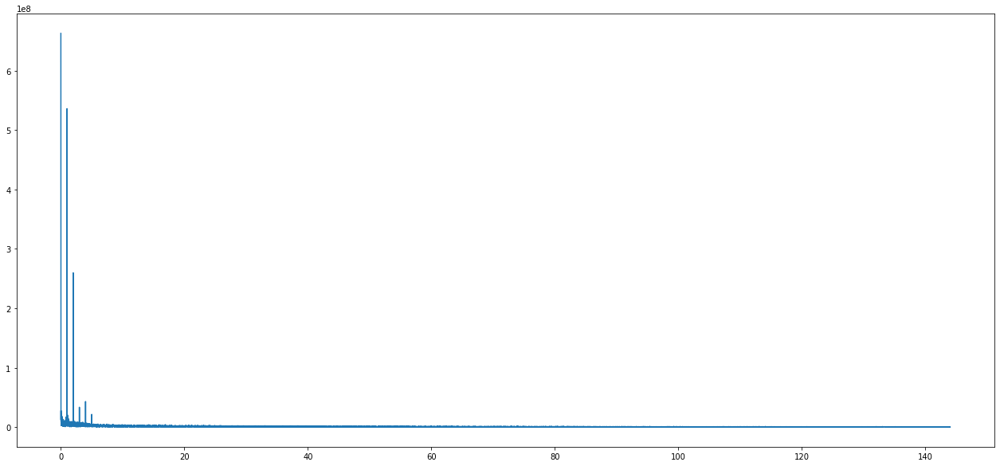

In [ ]:
from scipy.fft import rfft, rfftfreq

plt.figure(figsize=(22,10))
sample_rate = 288
duration = 148
N = int(sample_rate*duration)
yf = rfft((df_new['DC Power']).to_numpy())
xf = rfftfreq(N,1/sample_rate)
plt.plot(xf, np.abs(yf))

In [ ]:
len(xf)

21313

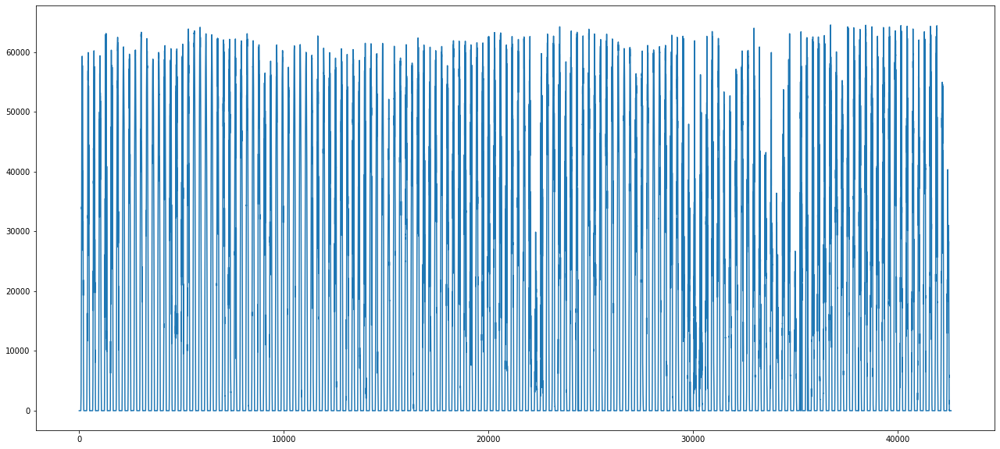

In [ ]:
from scipy.fft import irfft
plt.figure(figsize=(22,10))
new_signal = irfft(yf)
plt.plot(new_signal)

In [ ]:
#filtering the freq domain signal
# The maximum frequency is half the sample rate
points_per_freq = len(xf) / (sample_rate / 2)

# Our target frequency is  Hz
#target_idx = int(points_per_freq * 3)

In [ ]:
from scipy.stats import pearsonr

pearson_low=[]
pearson_high=[]
def cutting_signal(yf, cuttoff_freq):
  yf_low = np.copy(yf)
  target_idx = int(points_per_freq*cuttoff_freq)
  yf_low[target_idx - 1 : target_idx + 10000] = 0
  yf_high = yf - yf_low
  new_sig = irfft(yf)
  new_sig_low = irfft(yf_low)
  new_sig_high = irfft(yf_high)
  pear_low, _ = pearsonr(df_new['DC Power'], new_sig_low)
  pearson_low.append(pear_low)
  pear_high, _ = pearsonr(df_new['DC Power'], new_sig_high)
  pearson_high.append(pear_high)
  return new_sig, new_sig_low, new_sig_high

for i in range (1,30,1):
  new_sig, new_sig_low, new_sig_high = cutting_signal(yf, i)

print(pearson_low)
print(pearson_high)

[0.18066596501649768, 0.8808879119773366, 0.9769248523113009, 0.9807898623142577, 0.9849946320141856, 0.9867702921221826, 0.9876852948000188, 0.9884408105239221, 0.9890701017301654, 0.9895997150463292, 0.9900871440088864, 0.9905487189438296, 0.9909427175134986, 0.9913139505914719, 0.9917016537541683, 0.9920889676959388, 0.992449029950489, 0.9927520848992663, 0.9930033153305129, 0.9932502358429697, 0.9935289688660842, 0.9938174648059708, 0.9940813265786879, 0.9943162680651891, 0.9945269954353186, 0.9947200118821529, 0.994899031220328, 0.9950569136339404, 0.9952014534934984]
[0.983544513016395, 0.47332492701336615, 0.21358331614745404, 0.1950672857800071, 0.17258497878795734, 0.16212461437148504, 0.15645369422228408, 0.15160726925451862, 0.14744603712369006, 0.14384854528365765, 0.14045443128760948, 0.1371613480494353, 0.13428525833822097, 0.13151673415473808, 0.12856060804635372, 0.1255367682235211, 0.12265774720878417, 0.1201802726247537, 0.11808647569730071, 0.1159912453501761, 0.1135

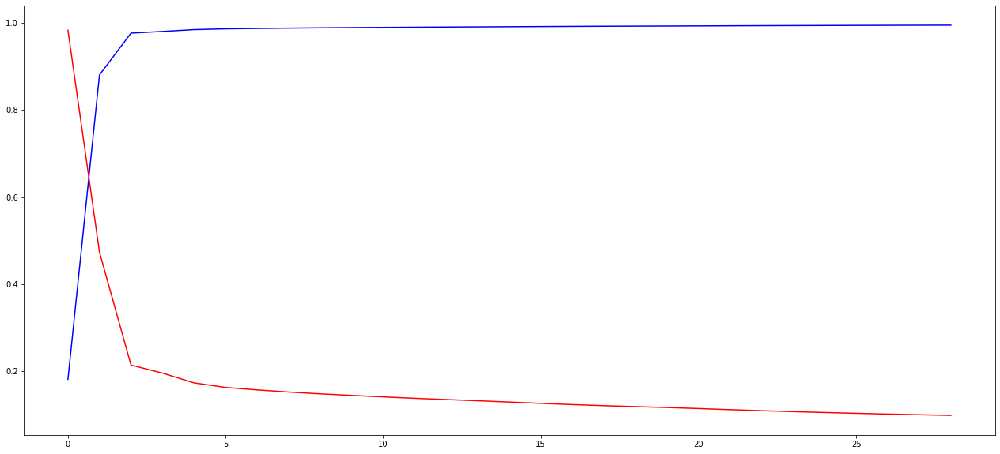

In [ ]:
plt.figure(figsize=(22,10))
XX = list(range(0, 29))

plt.plot(XX, pearson_low,color='blue', label='Raw Data and Low-freq component')
plt.plot(XX, pearson_high,color='red',  label='Raw Data and High-freq component')

plt.show()

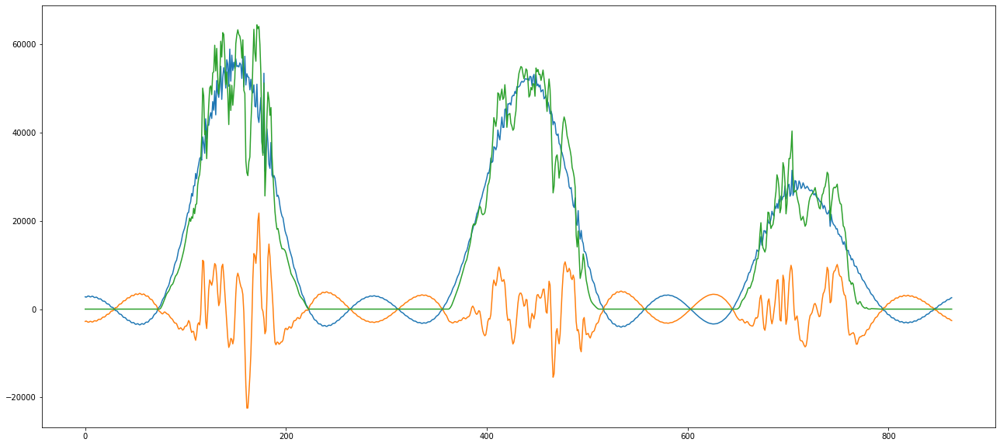

[[1.         0.97692485]
 [0.97692485 1.        ]]
[[1.         0.21358332]
 [0.21358332 1.        ]]
[[1. 1.]
 [1. 1.]]


In [ ]:
from scipy.fft import irfft

new_sig, new_sig_low, new_sig_high = cutting_signal(yf, 3)
plt.figure(figsize=(22,10))
plt.plot(new_sig_low[-864:])
plt.plot(new_sig_high[-864:])
plt.plot(new_sig[-864:])
plt.show()
print(np.corrcoef(df_new['DC Power'], new_sig_low))
print(np.corrcoef(df_new['DC Power'], new_sig_high))
print(np.corrcoef(df_new['DC Power'], new_sig))

In [ ]:
df_low = df_new.copy()
df_low['DC Power Low'] = new_sig_low
df_low.drop(['DC Power'], axis=1, inplace=True)
df_low

,DateTime,Hour,Ambient Temp,Module Temp,GHI,GTI,DC Power Low
0,2021-02-16 00:00:00,0,22.94995,21.33753,0.0,0.0,2568.698773
1,2021-02-16 00:05:00,0,22.31500,21.14517,0.0,0.0,2628.001305
2,2021-02-16 00:10:00,0,22.08755,20.96527,0.0,0.0,2817.418555
3,2021-02-16 00:15:00,0,22.21661,20.83107,0.0,0.0,2911.228705
4,2021-02-16 00:20:00,0,22.20626,20.66763,0.0,0.0,2849.319797
...,...,...,...,...,...,...,...
42619,2021-08-21 23:35:00,23,23.69089,23.76144,0.0,0.0,2143.278865
42620,2021-08-21 23:40:00,23,23.66865,23.73989,0.0,0.0,2144.830146
42621,2021-08-21 23:45:00,23,23.64114,23.70236,0.0,0.0,2256.066877
42622,2021-08-21 23:50:00,23,23.62848,23.65339,0.0,0.0,2484.321127


In [ ]:
df_high = df_new.copy()
df_high['DC Power High'] = new_sig_high
df_high.drop(['DC Power'], axis=1, inplace=True)

df_high

,DateTime,Hour,Ambient Temp,Module Temp,GHI,GTI,DC Power High
0,2021-02-16 00:00:00,0,22.94995,21.33753,0.0,0.0,-2568.698773
1,2021-02-16 00:05:00,0,22.31500,21.14517,0.0,0.0,-2628.001305
2,2021-02-16 00:10:00,0,22.08755,20.96527,0.0,0.0,-2817.418555
3,2021-02-16 00:15:00,0,22.21661,20.83107,0.0,0.0,-2911.228705
4,2021-02-16 00:20:00,0,22.20626,20.66763,0.0,0.0,-2849.319797
...,...,...,...,...,...,...,...
42619,2021-08-21 23:35:00,23,23.69089,23.76144,0.0,0.0,-2143.278865
42620,2021-08-21 23:40:00,23,23.66865,23.73989,0.0,0.0,-2144.830146
42621,2021-08-21 23:45:00,23,23.64114,23.70236,0.0,0.0,-2256.066877
42622,2021-08-21 23:50:00,23,23.62848,23.65339,0.0,0.0,-2484.321127


# Exporting DFs

In [ ]:
df_low.to_csv (r'df_low.csv', index = False, header=True)
df_high.to_csv (r'df_high.csv', index = False, header=True)

# LSTM models for the different dfs

In [ ]:
from sklearn.model_selection import train_test_split
from keras.preprocessing.sequence import TimeseriesGenerator
from sklearn.preprocessing import MinMaxScaler, StandardScaler
import tensorflow as tf

In [ ]:
df_low.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42624 entries, 0 to 42623
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   DateTime      42624 non-null  datetime64[ns]
 1   Hour          42624 non-null  int64         
 2   Ambient Temp  42624 non-null  float64       
 3   Module Temp   42624 non-null  float64       
 4   GHI           42624 non-null  float64       
 5   GTI           42624 non-null  float64       
 6   DC Power Low  42624 non-null  float64       
dtypes: datetime64[ns](1), float64(5), int64(1)
memory usage: 2.3 MB


In [ ]:
df_low.set_index('DateTime')[['Hour', 'Ambient Temp', 'Module Temp', 'GHI', 'GTI', 'DC Power Low']]
df_high.set_index('DateTime')[['Hour',  'Ambient Temp', 'Module Temp', 'GHI', 'GTI', 'DC Power High']]
df_low.head(15)

,DateTime,Hour,Ambient Temp,Module Temp,GHI,GTI,DC Power Low
0,2021-02-16 00:00:00,0,22.94995,21.33753,0.0,0.0,2568.698773
1,2021-02-16 00:05:00,0,22.31500,21.14517,0.0,0.0,2628.001305
2,2021-02-16 00:10:00,0,22.08755,20.96527,0.0,0.0,2817.418555
3,2021-02-16 00:15:00,0,22.21661,20.83107,0.0,0.0,2911.228705
4,2021-02-16 00:20:00,0,22.20626,20.66763,0.0,0.0,2849.319797
5,2021-02-16 00:25:00,0,22.21878,20.57633,0.0,0.0,2851.691396
6,2021-02-16 00:30:00,0,22.18549,20.47995,0.0,0.0,2994.603929
7,2021-02-16 00:35:00,0,22.38576,20.64016,0.0,0.0,3063.856950
8,2021-02-16 00:40:00,0,22.49356,20.77236,0.0,0.0,2966.517199
9,2021-02-16 00:45:00,0,22.67795,21.13061,0.0,0.0,2908.999300


In [ ]:
df_low_input = df_low[['Hour', 'Ambient Temp', 'Module Temp', 'GHI', 'GTI', 'DC Power Low']]
df_high_input = df_high[['Hour', 'Ambient Temp', 'Module Temp', 'GHI', 'GTI', 'DC Power High']]

In [ ]:
scaler_low = MinMaxScaler()
scaler_high = MinMaxScaler()
df_low_scaled = scaler_low.fit_transform(df_low_input)
df_high_scaled = scaler_high.fit_transform(df_high_input) 

In [ ]:
df_low_scaled

array([[0.        , 0.53598374, 0.31781036, 0.        , 0.        ,
        0.1292884 ],
       [0.        , 0.52115482, 0.31494527, 0.        , 0.        ,
        0.13008588],
       [0.        , 0.51584285, 0.31226576, 0.        , 0.        ,
        0.13263309],
       ...,
       [1.        , 0.55212611, 0.35303315, 0.        , 0.        ,
        0.12508425],
       [1.        , 0.55183044, 0.35230377, 0.        , 0.        ,
        0.12815372],
       [1.        , 0.55140796, 0.35142768, 0.        , 0.        ,
        0.12967062]])

In [ ]:
features_low = df_low_scaled[:,0:5]
features_high = df_high_scaled[:,0:5]
target_low = df_low_scaled[:,5]
target_high = df_high_scaled[:,5]

In [ ]:
features_low

array([[0.        , 0.53598374, 0.31781036, 0.        , 0.        ],
       [0.        , 0.52115482, 0.31494527, 0.        , 0.        ],
       [0.        , 0.51584285, 0.31226576, 0.        , 0.        ],
       ...,
       [1.        , 0.55212611, 0.35303315, 0.        , 0.        ],
       [1.        , 0.55183044, 0.35230377, 0.        , 0.        ],
       [1.        , 0.55140796, 0.35142768, 0.        , 0.        ]])

In [ ]:
target_low

array([0.1292884 , 0.13008588, 0.13263309, ..., 0.12508425, 0.12815372,
       0.12967062])

In [ ]:
x_train_low, x_test_low, y_train_low, y_test_low = train_test_split(features_low, target_low, test_size=0.20, random_state=123, shuffle=False)
x_train_high, x_test_high, y_train_high, y_test_high = train_test_split(features_high, target_high, test_size=0.20, random_state=123, shuffle=False)

In [ ]:
x_train_low.shape,y_train_low.shape

((34099, 5), (34099,))

In [ ]:
x_test_low.shape

(8525, 5)

In [ ]:
#Add stride to define output length it goes till 2*stride
wind_length = 30
batch_size = 32
num_features = 5
train_generator_low = TimeseriesGenerator(x_train_low[0:34081,], y_train_low[0:34081,], length = wind_length, sampling_rate=1, batch_size=batch_size)
test_generator_low = TimeseriesGenerator(x_test_low, y_test_low, length = wind_length, sampling_rate=1, batch_size=batch_size)
train_generator_high = TimeseriesGenerator(x_train_high, y_train_high, length = wind_length, sampling_rate=1, batch_size=batch_size)
test_generator_high = TimeseriesGenerator(x_test_high, y_test_high, length = wind_length, sampling_rate=1, batch_size=batch_size)

# **Low Frequency Domain model**

In [ ]:
model_low = tf.keras.Sequential()
model_low.add(tf.keras.layers.LSTM(256, input_shape=(wind_length, num_features), return_sequences=True))
model_low.add(tf.keras.layers.LeakyReLU(alpha=0.5))
model_low.add(tf.keras.layers.LSTM(128, return_sequences=True))
model_low.add(tf.keras.layers.LeakyReLU(alpha=0.5))
model_low.add(tf.keras.layers.Dropout(0.3))
model_low.add(tf.keras.layers.LSTM(64, return_sequences=False))
model_low.add(tf.keras.layers.Dropout(0.3))
model_low.add(tf.keras.layers.Dense(1))

In [ ]:
model_low.summary()

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_16 (LSTM)              (None, 30, 256)           268288    
                                                                 
 leaky_re_lu_11 (LeakyReLU)  (None, 30, 256)           0         
                                                                 
 lstm_17 (LSTM)              (None, 30, 128)           197120    
                                                                 
 leaky_re_lu_12 (LeakyReLU)  (None, 30, 128)           0         
                                                                 
 dropout_10 (Dropout)        (None, 30, 128)           0         
                                                                 
 lstm_18 (LSTM)              (None, 64)                49408     
                                                                 
 dropout_11 (Dropout)        (None, 64)               

In [ ]:
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss',
                                                  patience=5,
                                                  mode='min')
model_low.compile(loss=tf.losses.MeanSquaredError(),
              optimizer=tf.optimizers.Adam(),
              metrics=[tf.metrics.MeanAbsoluteError()])
history = model_low.fit(train_generator_low, epochs=50,
                        validation_data=test_generator_low,
                        shuffle=False,
                        callbacks=[early_stopping])

Epoch 1/50
1065/1065 [==============================] - 250s 226ms/step - loss: 0.0134 - mean_absolute_error: 0.0775 - val_loss: 0.0044 - val_mean_absolute_error: 0.0476
Epoch 2/50
1065/1065 [==============================] - 239s 224ms/step - loss: 0.0072 - mean_absolute_error: 0.0593 - val_loss: 0.0047 - val_mean_absolute_error: 0.0482
Epoch 3/50
1065/1065 [==============================] - 238s 224ms/step - loss: 0.0065 - mean_absolute_error: 0.0562 - val_loss: 0.0050 - val_mean_absolute_error: 0.0499
Epoch 4/50
1065/1065 [==============================] - 237s 223ms/step - loss: 0.0058 - mean_absolute_error: 0.0527 - val_loss: 0.0047 - val_mean_absolute_error: 0.0483
Epoch 5/50
1065/1065 [==============================] - 239s 225ms/step - loss: 0.0054 - mean_absolute_error: 0.0506 - val_loss: 0.0052 - val_mean_absolute_error: 0.0516
Epoch 6/50
1065/1065 [==============================] - 235s 220ms/step - loss: 0.0047 - mean_absolute_error: 0.0468 - val_loss: 0.0053 - val_mean_abs

In [ ]:
model_low.evaluate(test_generator_low, verbose=0)

[0.0052667036652565, 0.05035519599914551]

In [ ]:
predictions_low = model_low.predict(test_generator_low)

In [ ]:
predictions_low.shape

(8495, 1)

In [ ]:
predictions_low

array([[0.35037482],
       [0.3475396 ],
       [0.33955544],
       ...,
       [0.0929691 ],
       [0.09305999],
       [0.09313932]], dtype=float32)

#**LGBM Low Frequency Model**

In [ ]:
import lightgbm as lgb

model = lgb.LGBMRegressor()
model.fit(x_train_low, y_train_low,eval_set=[(x_test_low, y_test_low),(x_train_low, y_train_low)],
verbose=20,eval_metric='mae')

[20]	training's l2: 0.00299203	training's l1: 0.0410346	valid_0's l2: 0.00427673	valid_0's l1: 0.04786
[40]	training's l2: 0.00152697	training's l1: 0.0260101	valid_0's l2: 0.00297815	valid_0's l1: 0.0364007
[60]	training's l2: 0.00138242	training's l1: 0.0243435	valid_0's l2: 0.00300997	valid_0's l1: 0.036553
[80]	training's l2: 0.00131012	training's l1: 0.0235947	valid_0's l2: 0.00307293	valid_0's l1: 0.0369439
[100]	training's l2: 0.00125824	training's l1: 0.0230787	valid_0's l2: 0.00310405	valid_0's l1: 0.0371562


LGBMRegressor()

In [ ]:
lgbm_low_predictions = model.predict(x_test_low)
lgbm_low_predictions.shape

(8525,)

In [ ]:
df_lightgbm_low_pred = pd.concat([pd.DataFrame(x_test_low[:,:]), pd.DataFrame(lgbm_low_predictions)], axis=1)
rev_trans_df_lightgbm_low = scaler_low.inverse_transform(df_lightgbm_low_pred)


In [ ]:
#Future prediction
x_train_lgbm_low = x_train_low[0:34081,]
y_train_lgbm_low = y_train_low[18:34099,]
x_test_lgbm_low = x_test_low[0:8508,]
y_test_lgbm_low = y_test_low[17:8595,]
print(x_train_lgbm_low.shape, y_train_lgbm_low.shape,x_test_lgbm_low.shape,  y_test_lgbm_low.shape) 
model_18_steps_ahead = lgb.LGBMRegressor()
model_18_steps_ahead.fit(x_train_lgbm_low, y_train_lgbm_low,eval_set=[(x_test_lgbm_low, y_test_lgbm_low),(x_train_lgbm_low, y_train_lgbm_low)],
verbose=20,eval_metric='mae')

(34081, 5) (34081,) (8508, 5) (8508,)
[20]	training's l2: 0.00354684	training's l1: 0.0449191	valid_0's l2: 0.00520668	valid_0's l1: 0.0527098
[40]	training's l2: 0.00213445	training's l1: 0.0303438	valid_0's l2: 0.00431192	valid_0's l1: 0.043135
[60]	training's l2: 0.00196436	training's l1: 0.0286339	valid_0's l2: 0.00445776	valid_0's l1: 0.0436078
[80]	training's l2: 0.00187139	training's l1: 0.0278982	valid_0's l2: 0.00454167	valid_0's l1: 0.0439496
[100]	training's l2: 0.00180885	training's l1: 0.0273664	valid_0's l2: 0.00456973	valid_0's l1: 0.0441606


LGBMRegressor()

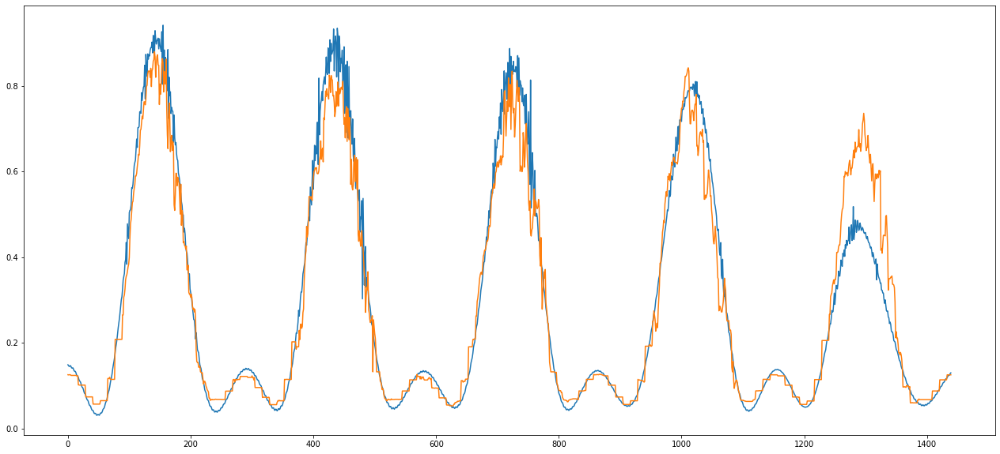

In [ ]:
plt.figure(figsize=(22,10))
lgbm_low_predictions_18_steps_ahead = model_18_steps_ahead.predict(x_test_lgbm_low)
lgbm_low_predictions_18_steps_ahead.shape
plt.plot(y_test_lgbm_low[-1440:,])
plt.plot(lgbm_low_predictions_18_steps_ahead[-1440:,])

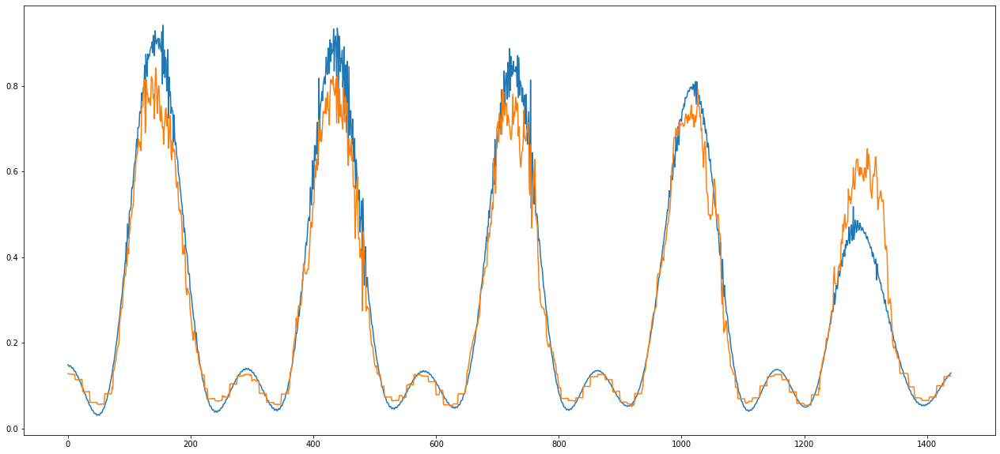

In [ ]:
plt.figure(figsize=(22,10))

plt.plot(y_test_low[-1440:,])
plt.plot(lgbm_low_predictions[-1440:,])

In [ ]:
plt.figure(figsize=(22,10))
lgbm_low_predictions_3_steps_ahead = model_3_steps_ahead.predict(x_test_lgbm_low_3)
lgbm_low_predictions_3_steps_ahead.shape
plt.plot(y_test_lgbm_low_3[-1440:,])
plt.plot(lgbm_low_predictions_3_steps_ahead[-1440:,])

In [ ]:
x_train_lgbm_low_3 = x_train_low[0:34096,]
y_train_lgbm_low_3 = y_train_low[3:34099,]
x_test_lgbm_low_3 = x_test_low[0:8522,]
y_test_lgbm_low_3 = y_test_low[3:8525,]
print(x_train_lgbm_low_3.shape, y_train_lgbm_low_3.shape,x_test_lgbm_low_3.shape,  y_test_lgbm_low_3.shape) 
model_3_steps_ahead = lgb.LGBMRegressor()
model_3_steps_ahead.fit(x_train_lgbm_low_3, y_train_lgbm_low_3,eval_set=[(x_test_lgbm_low_3, y_test_lgbm_low_3),(x_train_lgbm_low_3, y_train_lgbm_low_3)],
verbose=20,eval_metric='mae')

(34096, 5) (34096,) (8522, 5) (8522,)
[20]	training's l2: 0.00307294	training's l1: 0.0416707	valid_0's l2: 0.00455053	valid_0's l1: 0.0494406
[40]	training's l2: 0.00164155	training's l1: 0.0267949	valid_0's l2: 0.00333976	valid_0's l1: 0.0382621
[60]	training's l2: 0.00149342	training's l1: 0.0251017	valid_0's l2: 0.00339679	valid_0's l1: 0.0384151
[80]	training's l2: 0.00142082	training's l1: 0.0244103	valid_0's l2: 0.00346253	valid_0's l1: 0.0387725
[100]	training's l2: 0.00137171	training's l1: 0.0239099	valid_0's l2: 0.00350014	valid_0's l1: 0.0390299


LGBMRegressor()

# **Creating a final df to compare all the models**

In [ ]:
x_test_low[:,0:][wind_length:]

array([[0.52173913, 0.59387384, 0.47183992, 0.15508971, 0.15165988],
       [0.52173913, 0.59505021, 0.46647331, 0.11736354, 0.1148745 ],
       [0.52173913, 0.59624666, 0.46130211, 0.09284916, 0.0911712 ],
       ...,
       [1.        , 0.55212611, 0.35303315, 0.        , 0.        ],
       [1.        , 0.55183044, 0.35230377, 0.        , 0.        ],
       [1.        , 0.55140796, 0.35142768, 0.        , 0.        ]])

In [ ]:
df_low_pred = pd.concat([pd.DataFrame(x_test_low[:,:][wind_length:]), pd.DataFrame(predictions_low)], axis=1)

In [ ]:
df_low_pred

,0,1,2,3,4,0
0,0.521739,0.593874,0.471840,0.155090,0.151660,0.394009
1,0.521739,0.595050,0.466473,0.117364,0.114875,0.390853
2,0.521739,0.596247,0.461302,0.092849,0.091171,0.383314
3,0.521739,0.594699,0.449581,0.084935,0.083343,0.374318
4,0.521739,0.594430,0.449923,0.146008,0.142765,0.366699
...,...,...,...,...,...,...
8490,1.000000,0.553288,0.353913,0.000000,0.000000,0.108249
8491,1.000000,0.552769,0.353592,0.000000,0.000000,0.108584
8492,1.000000,0.552126,0.353033,0.000000,0.000000,0.108899
8493,1.000000,0.551830,0.352304,0.000000,0.000000,0.109196


In [ ]:
rev_trans_low=scaler_low.inverse_transform(df_low_pred)
df_low_final = df_low_input[predictions_low.shape[0]*-1:]

In [ ]:
df_low_final.count()

Hour            8495
Ambient Temp    8495
Module Temp     8495
GHI             8495
GTI             8495
DC Power Low    8495
dtype: int64

In [ ]:
df_low_final['DC Power Low Pred LSTM'] = rev_trans_low[:,5]
df_low_final['DC Power Low Pred LGBM'] = rev_trans_df_lightgbm_low[30:,5]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [ ]:
df_low_final

,Hour,Ambient Temp,Module Temp,GHI,GTI,DC Power Low,DC Power Low Pred LSTM,DC Power Low Pred LGBM
34129,12,25.42871,31.67895,222.2859,218.1691,21060.726201,19009.269336,26578.144275
34130,12,25.47908,31.31864,168.2140,165.2518,19547.664264,18798.435318,27902.969921
34131,12,25.53031,30.97145,133.0782,131.1536,20229.885181,18204.711972,27393.395344
34132,12,25.46404,30.18450,121.7348,119.8918,19833.564735,17375.495179,26904.227061
34133,12,25.45252,30.20745,209.2692,205.3733,21141.675233,16634.072336,27178.862232
...,...,...,...,...,...,...,...,...
42619,23,23.69089,23.76144,0.0000,0.0000,2143.278865,-148.690259,2009.191073
42620,23,23.66865,23.73989,0.0000,0.0000,2144.830146,-139.736894,2009.191073
42621,23,23.64114,23.70236,0.0000,0.0000,2256.066877,-132.099939,2009.191073
42622,23,23.62848,23.65339,0.0000,0.0000,2484.321127,-125.341700,2073.716102


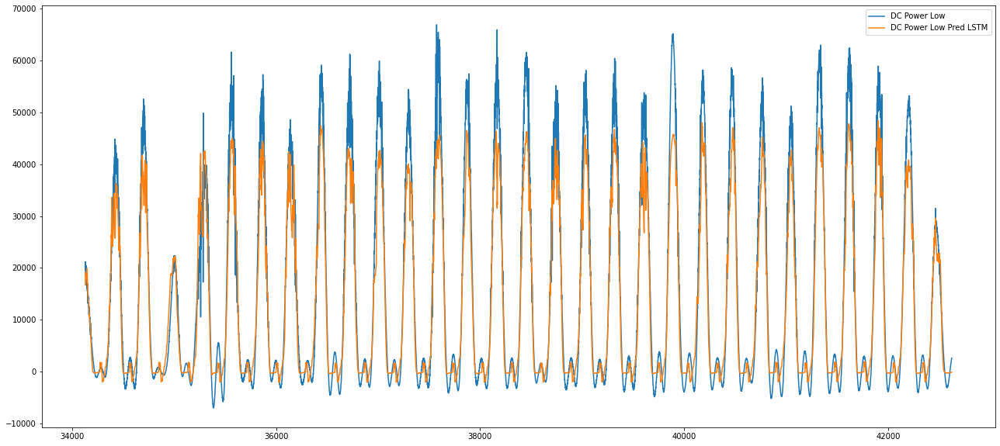

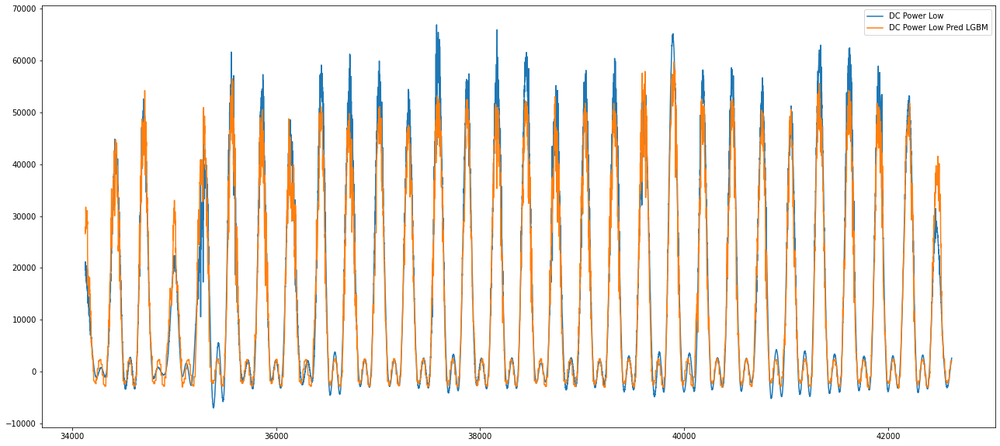

In [ ]:
df_low_final[['DC Power Low', 'DC Power Low Pred LSTM']].plot(figsize=(22,10))
df_low_final[['DC Power Low', 'DC Power Low Pred LGBM']].plot(figsize=(22,10))

In [ ]:
#MAPE
from sklearn.metrics import mean_absolute_error

mape_lgbm = mean_absolute_error(df_low_final['DC Power Low'],df_low_final['DC Power Low Pred LGBM'])
mape_lstm = mean_absolute_error(df_low_final['DC Power Low'],df_low_final['DC Power Low Pred LSTM'])
print(mape_lgbm, mape_lstm)

2749.460907869611 3744.5451409385764


# **High Frequency domain model**

In [ ]:
model_high = tf.keras.Sequential()
model_high.add(tf.keras.layers.LSTM(128, input_shape=(wind_length, num_features), return_sequences=True))
model_high.add(tf.keras.layers.LeakyReLU(alpha=0.5))
model_high.add(tf.keras.layers.LSTM(128, return_sequences=True))
model_high.add(tf.keras.layers.LeakyReLU(alpha=0.5))
model_high.add(tf.keras.layers.Dropout(0.3))
model_high.add(tf.keras.layers.LSTM(64, return_sequences=False))
model_high.add(tf.keras.layers.Dropout(0.3))
model_high.add(tf.keras.layers.Dense(1))

In [ ]:
model_high.summary()

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_19 (LSTM)              (None, 30, 128)           68608     
                                                                 
 leaky_re_lu_13 (LeakyReLU)  (None, 30, 128)           0         
                                                                 
 lstm_20 (LSTM)              (None, 30, 128)           131584    
                                                                 
 leaky_re_lu_14 (LeakyReLU)  (None, 30, 128)           0         
                                                                 
 dropout_12 (Dropout)        (None, 30, 128)           0         
                                                                 
 lstm_21 (LSTM)              (None, 64)                49408     
                                                                 
 dropout_13 (Dropout)        (None, 64)               

In [ ]:
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss',
                                                  patience=5,
                                                  mode='min')
model_high.compile(loss=tf.losses.MeanSquaredError(),
              optimizer=tf.optimizers.Adam(),
              metrics=[tf.metrics.MeanAbsoluteError()])
history = model_high.fit(train_generator_high, epochs=50,
                        validation_data=test_generator_high,
                        shuffle=False,
                        callbacks=[early_stopping])

Epoch 1/50
1065/1065 [==============================] - 125s 111ms/step - loss: 0.0074 - mean_absolute_error: 0.0617 - val_loss: 0.0047 - val_mean_absolute_error: 0.0452
Epoch 2/50
1065/1065 [==============================] - 118s 111ms/step - loss: 0.0044 - mean_absolute_error: 0.0488 - val_loss: 0.0046 - val_mean_absolute_error: 0.0441
Epoch 3/50
1065/1065 [==============================] - 118s 110ms/step - loss: 0.0038 - mean_absolute_error: 0.0442 - val_loss: 0.0045 - val_mean_absolute_error: 0.0439
Epoch 4/50
1065/1065 [==============================] - 118s 111ms/step - loss: 0.0033 - mean_absolute_error: 0.0404 - val_loss: 0.0041 - val_mean_absolute_error: 0.0414
Epoch 5/50
1065/1065 [==============================] - 117s 110ms/step - loss: 0.0029 - mean_absolute_error: 0.0369 - val_loss: 0.0038 - val_mean_absolute_error: 0.0401
Epoch 6/50
1065/1065 [==============================] - 119s 112ms/step - loss: 0.0025 - mean_absolute_error: 0.0337 - val_loss: 0.0035 - val_mean_abs

In [ ]:
model_high.evaluate(test_generator_high, verbose=0)

[0.0034819291904568672, 0.037147775292396545]

In [ ]:
predictions_high = model_high.predict(test_generator_high)

In [ ]:
predictions_high

array([[0.45667616],
       [0.45853442],
       [0.43080756],
       ...,
       [0.49641895],
       [0.4956826 ],
       [0.4950173 ]], dtype=float32)

In [ ]:
df_high_pred = pd.concat([pd.DataFrame(x_test_high[:,:][wind_length:]), pd.DataFrame(predictions_high)], axis=1)

In [ ]:
df_high_pred

,0,1,2,0
0,0.253573,0.256479,0.600763,0.612079
1,0.243378,0.247502,0.599432,0.604385
2,0.236110,0.239901,0.559038,0.558368
3,0.208833,0.211971,0.531102,0.532384
4,0.211555,0.213759,0.542782,0.552303
...,...,...,...,...
8511,0.000000,0.000000,0.494762,0.497647
8512,0.000000,0.000000,0.494741,0.498251
8513,0.000000,0.000000,0.493231,0.495866
8514,0.000000,0.000000,0.490132,0.492087


# **LGBM High Frequency Model**

In [ ]:
model_2 = lgb.LGBMRegressor()
model_2.fit(x_train_high, y_train_high,eval_set=[(x_test_high, y_test_high),(x_train_high, y_train_high)],
verbose=20,eval_metric='mae')

[20]	training's l2: 0.00157696	training's l1: 0.025197	valid_0's l2: 0.00320827	valid_0's l1: 0.034475
[40]	training's l2: 0.00137817	training's l1: 0.0235198	valid_0's l2: 0.00325581	valid_0's l1: 0.0352053
[60]	training's l2: 0.00129446	training's l1: 0.0228109	valid_0's l2: 0.00330066	valid_0's l1: 0.0355979
[80]	training's l2: 0.00123899	training's l1: 0.0223059	valid_0's l2: 0.00333299	valid_0's l1: 0.0358382
[100]	training's l2: 0.00119402	training's l1: 0.0219624	valid_0's l2: 0.00335362	valid_0's l1: 0.0360196


LGBMRegressor()

In [ ]:
lgbm_high_predictions = model_2.predict(x_test_high)
df_lightgbm_high_pred = pd.concat([pd.DataFrame(x_test_high[:,:]), pd.DataFrame(lgbm_high_predictions)], axis=1)
rev_trans_df_lightgbm_high = scaler_high.inverse_transform(df_lightgbm_high_pred)

# **Finalising the final df**

In [ ]:
rev_trans_high=scaler_high.inverse_transform(df_high_pred)

In [ ]:
df_high_final = df_high_input[predictions_high.shape[0]*-1:]

In [ ]:
df_high_final['DC Power High Pred LSTM'] = rev_trans_high[:,5]
df_high_final['DC Power High Pred LGBM'] = rev_trans_df_lightgbm_high[30:,5]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [ ]:
df_high_final

,Hour,Ambient Temp,Module Temp,GHI,GTI,DC Power High,DC Power High Pred LSTM,DC Power High Pred LGBM
34129,12,25.42871,31.67895,222.2859,218.1691,-4527.426201,-4948.780434,-10296.350446
34130,12,25.47908,31.31864,168.2140,165.2518,-7146.664264,-4811.896960,-16042.816534
34131,12,25.53031,30.97145,133.0782,131.1536,-10544.985181,-6854.313068,-17553.157513
34132,12,25.46404,30.18450,121.7348,119.8918,-10579.564735,-7935.412169,-16363.084894
34133,12,25.45252,30.20745,209.2692,205.3733,-5770.475233,-7379.718349,-10149.650176
...,...,...,...,...,...,...,...,...
42619,23,23.69089,23.76144,0.0000,0.0000,-2143.278865,-1899.040440,-2090.122949
42620,23,23.66865,23.73989,0.0000,0.0000,-2144.830146,-1961.854528,-2090.122949
42621,23,23.64114,23.70236,0.0000,0.0000,-2256.066877,-2021.246145,-2090.122949
42622,23,23.62848,23.65339,0.0000,0.0000,-2484.321127,-2075.487591,-2154.842057


In [ ]:
df_high_final.drop('DC Power Low Pred LGBM', inplace=True, axis=1)

/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4913: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


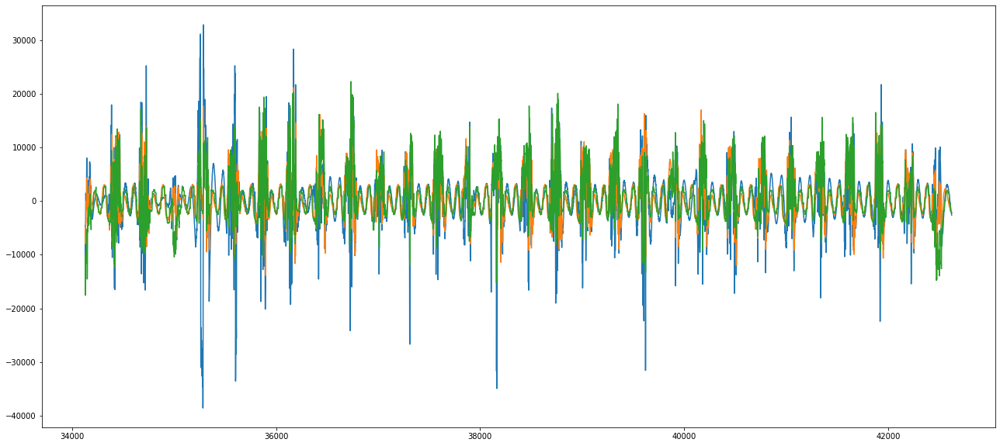

In [ ]:
df_high_final['DC Power High'].plot(figsize=(22,10))
df_high_final['DC Power High Pred LSTM'].plot(figsize=(22,10))
df_high_final['DC Power High Pred LGBM'].plot(figsize=(22,10))

In [ ]:
df_final_clubbed = df_new.copy()
df_final_clubbed = df_final_clubbed[-8495:]
df_final_clubbed['DC Power Pred_Pure_LSTM'] = df_low_final['DC Power Low Pred LSTM'] + df_high_final['DC Power High Pred LSTM']
df_final_clubbed['DC Power Pred_Pure_LGBM'] = df_low_final['DC Power Low Pred LGBM'] + df_high_final['DC Power High Pred LGBM']
df_final_clubbed['DC Power Pred_GM_TM'] = df_low_final['DC Power Low Pred LGBM'] + df_high_final['DC Power High Pred LSTM']
df_final_clubbed['DC Power Pred_TM_GM'] = df_low_final['DC Power Low Pred LSTM'] + df_high_final['DC Power High Pred LGBM']
df_final_clubbed

,DateTime,Hour,Ambient Temp,Module Temp,GHI,GTI,DC Power,DC Power Pred_Pure_LSTM,DC Power Pred_Pure_LGBM,DC Power Pred_GM_TM,DC Power Pred_TM_GM
34129,2021-07-15 12:05:00,12,25.42871,31.67895,222.2859,218.1691,16533.3,14060.488902,16281.793829,21629.363841,8712.918890
34130,2021-07-15 12:10:00,12,25.47908,31.31864,168.2140,165.2518,12401.0,13986.538358,11860.153387,23091.072961,2755.618784
34131,2021-07-15 12:15:00,12,25.53031,30.97145,133.0782,131.1536,9684.9,11350.398904,9840.237831,20539.082276,651.554459
34132,2021-07-15 12:20:00,12,25.46404,30.18450,121.7348,119.8918,9254.0,9440.083010,10541.142167,18968.814892,1012.410285
34133,2021-07-15 12:25:00,12,25.45252,30.20745,209.2692,205.3733,15371.2,9254.353987,17029.212057,19799.143883,6484.422160
...,...,...,...,...,...,...,...,...,...,...,...
42619,2021-08-21 23:35:00,23,23.69089,23.76144,0.0000,0.0000,0.0,-2047.730699,-80.931876,110.150633,-2238.813208
42620,2021-08-21 23:40:00,23,23.66865,23.73989,0.0000,0.0000,0.0,-2101.591422,-80.931876,47.336545,-2229.859843
42621,2021-08-21 23:45:00,23,23.64114,23.70236,0.0000,0.0000,0.0,-2153.346084,-80.931876,-12.055072,-2222.222888
42622,2021-08-21 23:50:00,23,23.62848,23.65339,0.0000,0.0000,0.0,-2200.829291,-81.125955,-1.771489,-2280.183757


Text(0.5, 1.0, 'Just TM_GM')

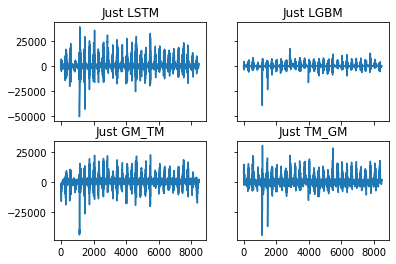

In [ ]:
fig, ax = plt.subplots(2, 2, sharex='col', sharey='row')
#df_final_clubbed['DC Power'].plot(figsize=(45,20))
#df_final_clubbed['DC Power Pred_Pure_LSTM'].plot(figsize=(45,20))
#df_final_clubbed['DC Power Pred_Pure_LGBM'].plot(figsize=(45,20))
#df_final_clubbed['DC Power Pred_GM_TM'].plot(figsize=(45,20))
#df_final_clubbed['DC Power Pred_TM_GM'].plot(figsize=(45,20))
xx=np.arange(0,8495,1) 
ax[0][0].plot(xx, df_final_clubbed['DC Power']-df_final_clubbed['DC Power Pred_Pure_LSTM'])
ax[0][0].set_title('Just LSTM')
ax[0][1].plot(xx, df_final_clubbed['DC Power']-df_final_clubbed['DC Power Pred_Pure_LGBM'])
ax[0][1].set_title('Just LGBM')
ax[1][0].plot(xx, df_final_clubbed['DC Power']-df_final_clubbed['DC Power Pred_GM_TM'])
ax[1][0].set_title('Just GM_TM')
ax[1][1].plot(xx, df_final_clubbed['DC Power']-df_final_clubbed['DC Power Pred_TM_GM'])
ax[1][1].set_title('Just TM_GM')

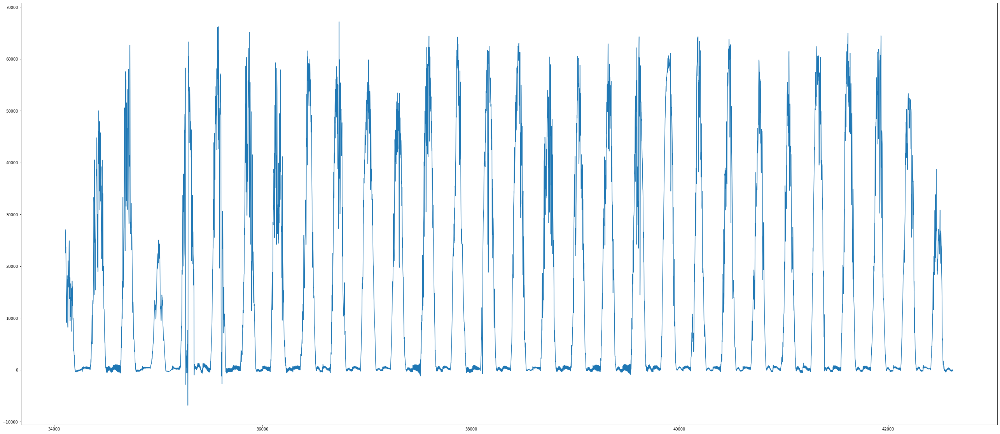

In [ ]:
df_final_clubbed['DC Power Pred'].plot(figsize=(45,20))

In [ ]:
#Last 5 day plot
df_5_days = df_final_clubbed.tail(1440)

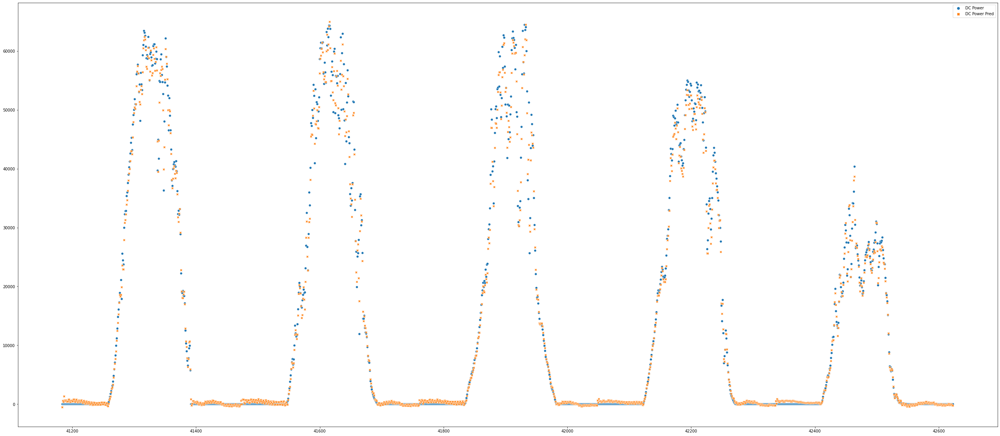

In [ ]:
import seaborn as sns

fig, ax = plt.subplots(figsize=(45, 20))
sns.scatterplot(data = df_5_days[['DC Power', 'DC Power Pred']])

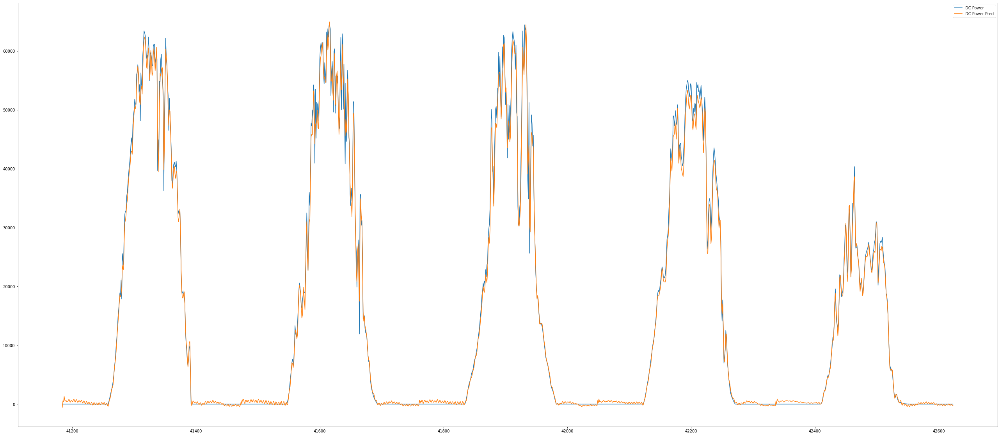

In [ ]:
df_5_days[['DC Power', 'DC Power Pred']].plot(figsize=(45,20))

In [ ]:
from sklearn.metrics import mean_squared_error

rms = mean_squared_error(df_final_clubbed['DC Power'], df_final_clubbed['DC Power Pred'], squared=False)
rms

1451.1212493118999